# Importing Necessary Libraries


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt


# Core CPI


In [ ]:
df = pd.read_excel("/work/Core CPI, seas. adj..xlsx")
df.head()


,Unnamed: 0,Advanced Economies,Armenia,Belgium,Belarus,Brazil,Canada,Switzerland,Chile,China,...,Sweden,Thailand,Trinidad and Tobago,Turkey,"Taiwan, China",Uganda,United States,Viet Nam,World (WBG members),South Africa
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1994.0,77.56696,NaN,NaN,NaN,NaN,77.47547,NaN,NaN,NaN,...,NaN,75.95033,70.50426,NaN,87.87020,NaN,70.93227,NaN,NaN,NaN
2,1995.0,79.40157,NaN,NaN,NaN,37.93702,79.17782,NaN,NaN,NaN,...,NaN,79.12105,71.78346,NaN,90.90310,NaN,73.07384,NaN,NaN,NaN
3,1996.0,81.06456,NaN,81.35483,NaN,44.78102,80.34493,NaN,NaN,NaN,...,84.10045,82.01367,72.50649,NaN,93.53149,NaN,75.03788,NaN,NaN,NaN
4,1997.0,82.69475,NaN,82.19347,NaN,48.02343,81.60868,NaN,NaN,NaN,...,85.25895,85.44567,73.44271,NaN,94.86439,NaN,76.82819,NaN,NaN,NaN


In [ ]:
df = df.rename(columns = {'Unnamed: 0':'Year'})
df.head()


,Year,Advanced Economies,Armenia,Belgium,Belarus,Brazil,Canada,Switzerland,Chile,China,...,Sweden,Thailand,Trinidad and Tobago,Turkey,"Taiwan, China",Uganda,United States,Viet Nam,World (WBG members),South Africa
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1994.0,77.56696,NaN,NaN,NaN,NaN,77.47547,NaN,NaN,NaN,...,NaN,75.95033,70.50426,NaN,87.87020,NaN,70.93227,NaN,NaN,NaN
2,1995.0,79.40157,NaN,NaN,NaN,37.93702,79.17782,NaN,NaN,NaN,...,NaN,79.12105,71.78346,NaN,90.90310,NaN,73.07384,NaN,NaN,NaN
3,1996.0,81.06456,NaN,81.35483,NaN,44.78102,80.34493,NaN,NaN,NaN,...,84.10045,82.01367,72.50649,NaN,93.53149,NaN,75.03788,NaN,NaN,NaN
4,1997.0,82.69475,NaN,82.19347,NaN,48.02343,81.60868,NaN,NaN,NaN,...,85.25895,85.44567,73.44271,NaN,94.86439,NaN,76.82819,NaN,NaN,NaN


In [ ]:
df1 = df[['Year', 'United States', 'United Kingdom', 'Japan', 'China']]
df1.head()


,Year,United States,United Kingdom,Japan,China
0,NaN,NaN,NaN,NaN,NaN
1,1994.0,70.93227,77.31104,101.9529,NaN
2,1995.0,73.07384,79.14969,102.6347,NaN
3,1996.0,75.03788,81.03172,103.1397,NaN
4,1997.0,76.82819,82.63182,104.7222,NaN


In [ ]:
df1.isnull().sum()


Year               1
United States      1
United Kingdom     1
Japan              1
China             12
dtype: int64

In [ ]:
df1.tail()


,Year,United States,United Kingdom,Japan,China
26,2019.0,119.2965,121.9214,101.0690,117.6065
27,2020.0,121.3349,123.6121,101.0269,118.4694
28,2021.0,125.6625,126.4219,100.2104,119.4487
29,2022.0,133.3897,134.3649,100.3283,120.2385
30,2023.0,139.1832,143.0980,102.5926,120.9004


In [ ]:
df1 = df1.drop([0, df1.index[-1]])


In [ ]:
df1.isnull().sum()


Year               0
United States      0
United Kingdom     0
Japan              0
China             11
dtype: int64

In [ ]:
def fill_missing_values(df1, column):
    First_Year = df1[column].first_valid_index()
    Last_Year = df1[column].last_valid_index()

    trend = (df1.loc[Last_Year, column] - df1.loc[First_Year, column]) / (Last_Year - First_Year)

    missing_years = df1[df1[column].isnull()].index
    df1.loc[missing_years, column] = df1.loc[First_Year, column] + trend * (missing_years - First_Year)

fill_missing_values(df1, 'China')

print(df1)


      Year  United States  United Kingdom      Japan       China
1   1994.0       70.93227        77.31104  101.95290   84.192255
2   1995.0       73.07384        79.14969  102.63470   85.479621
3   1996.0       75.03788        81.03172  103.13970   86.766987
4   1997.0       76.82819        82.63182  104.72220   88.054353
5   1998.0       78.58450        84.04334  105.47140   89.341719
6   1999.0       80.21239        84.93343  105.34510   90.629085
7   2000.0       82.16888        85.21347  104.95790   91.916451
8   2001.0       84.35955        86.24029  104.02360   93.203816
9   2002.0       86.31604        87.51037  103.13130   94.491182
10  2003.0       87.57756        88.66636  102.81990   95.778548
11  2004.0       89.12614        89.67338  102.22220   97.065914
12  2005.0       91.04108        91.06227  101.81820   98.353280
13  2006.0       93.32995        92.38893  101.36360   98.955500
14  2007.0       95.50932        94.20589  101.08590   99.819330
15  2008.0       97.70301

In [ ]:
df1['Year'] = df1['Year'].astype(int)
df1 = df1.set_index('Year')


In [ ]:
df1.describe()


,United States,United Kingdom,Japan,China
count,29.000000,29.000000,29.000000,29.000000
mean,97.728825,100.211374,101.480611,101.429162
std,16.958260,16.260490,2.145469,10.851042
min,70.932270,77.311040,97.500000,84.192255
25%,84.359550,86.240290,100.328300,93.203816
50%,97.703010,96.308550,101.085900,99.819330
75%,109.801100,113.146800,102.819900,109.382800
max,133.389700,134.364900,105.471400,120.238500


# Imports Merchandise


In [ ]:
df = pd.read_excel("/work/Imports Merchandise, Customs, current US$, millions, seas. adj..xlsx")
df.head()


,Unnamed: 0,Albania,Advanced Economies,Argentina,Armenia,Australia,Austria,Burundi,Belgium,Bangladesh,...,Uganda,Ukraine,Uruguay,United States,"Venezuela, RB",Viet Nam,World (WBG members),Samoa,South Africa,Zambia
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1994.0,534.1206,3243933.0,21590.0,NaN,49828.73,55115.45,227.2512,129613.8,NaN,...,879.6957,NaN,2782.221,662702.6,8287.025,5764.492,7819907.0,81.53508,NaN,458.4489
2,1995.0,766.3430,3868247.0,20122.0,NaN,57404.46,64441.23,235.3743,154411.8,NaN,...,1060.7570,NaN,2880.923,743492.5,11334.520,8251.845,8450273.0,94.60195,NaN,781.9543
3,1996.0,947.5612,4034632.0,23762.0,847.9732,61454.51,66950.13,123.2563,162122.2,NaN,...,1181.4950,17670.4,3326.291,795448.4,8859.564,11146.180,9283552.0,100.23850,NaN,835.3055
4,1997.0,497.6711,4116436.0,30452.0,900.3036,61853.03,64974.49,123.4582,157565.4,NaN,...,1297.2930,17118.2,3730.816,869414.2,13108.510,11686.700,9147028.0,100.24670,NaN,695.1819


In [ ]:
df = df.rename(columns = {'Unnamed: 0':'Year'})
df.head()


,Year,Albania,Advanced Economies,Argentina,Armenia,Australia,Austria,Burundi,Belgium,Bangladesh,...,Uganda,Ukraine,Uruguay,United States,"Venezuela, RB",Viet Nam,World (WBG members),Samoa,South Africa,Zambia
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1994.0,534.1206,3243933.0,21590.0,NaN,49828.73,55115.45,227.2512,129613.8,NaN,...,879.6957,NaN,2782.221,662702.6,8287.025,5764.492,7819907.0,81.53508,NaN,458.4489
2,1995.0,766.3430,3868247.0,20122.0,NaN,57404.46,64441.23,235.3743,154411.8,NaN,...,1060.7570,NaN,2880.923,743492.5,11334.520,8251.845,8450273.0,94.60195,NaN,781.9543
3,1996.0,947.5612,4034632.0,23762.0,847.9732,61454.51,66950.13,123.2563,162122.2,NaN,...,1181.4950,17670.4,3326.291,795448.4,8859.564,11146.180,9283552.0,100.23850,NaN,835.3055
4,1997.0,497.6711,4116436.0,30452.0,900.3036,61853.03,64974.49,123.4582,157565.4,NaN,...,1297.2930,17118.2,3730.816,869414.2,13108.510,11686.700,9147028.0,100.24670,NaN,695.1819


In [ ]:
df2 = df[['Year', 'United States', 'United Kingdom', 'Japan', 'China']]
df2.head()


,Year,United States,United Kingdom,Japan,China
0,NaN,NaN,NaN,NaN,NaN
1,1994.0,662702.6,226582.0,275851.6,115019.1
2,1995.0,743492.5,263967.0,335929.7,132131.9
3,1996.0,795448.4,285434.0,349253.8,140091.4
4,1997.0,869414.2,303947.0,338405.7,143171.7


In [ ]:
df2.isnull().sum()


Year              1
United States     2
United Kingdom    2
Japan             2
China             2
dtype: int64

In [ ]:
df2 = df2.drop([0, df2.index[-1]])


In [ ]:
df2.isnull().sum()


Year              0
United States     0
United Kingdom    0
Japan             0
China             0
dtype: int64

In [ ]:
df2.head()


,Year,United States,United Kingdom,Japan,China
1,1994.0,662702.6,226582.0,275851.6,115019.1
2,1995.0,743492.5,263967.0,335929.7,132131.9
3,1996.0,795448.4,285434.0,349253.8,140091.4
4,1997.0,869414.2,303947.0,338405.7,143171.7
5,1998.0,911417.8,314613.0,280418.0,141007.1


In [ ]:
df2['Year'] = df2['Year'].astype(int)
df2.set_index('Year', inplace = True)


In [ ]:
df2.head()


,United States,United Kingdom,Japan,China
Year,,,,
1994,662702.6,226582.0,275851.6,115019.1
1995,743492.5,263967.0,335929.7,132131.9
1996,795448.4,285434.0,349253.8,140091.4
1997,869414.2,303947.0,338405.7,143171.7
1998,911417.8,314613.0,280418.0,141007.1


In [ ]:
df2.describe()


,United States,United Kingdom,Japan,China
count,2.900000e+01,29.000000,29.000000,2.900000e+01
mean,1.779883e+06,515994.655172,572862.462069,1.128486e+06
std,6.932335e+05,161183.763206,205034.666170,8.519690e+05
min,6.627026e+05,226582.000000,275851.600000,1.150191e+05
25%,1.160497e+06,344596.000000,349528.000000,2.453284e+05
50%,1.913398e+06,568996.000000,607587.900000,1.001776e+06
75%,2.278090e+06,651662.000000,749185.100000,1.850238e+06
max,3.240947e+06,793796.000000,900782.300000,2.689627e+06


# Exports Merchandise


In [ ]:
df = pd.read_excel("/work/Exports Merchandise, Customs, current US$, millions, seas. adj..xlsx")
df.head()


,Unnamed: 0,Angola,Albania,Advanced Economies,Argentina,Armenia,Australia,Austria,Azerbaijan,Burundi,...,Uganda,Ukraine,Uruguay,United States,"Venezuela, RB",Viet Nam,World (WBG members),Samoa,South Africa,Zambia
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1994.0,3034.938,120.7492,3426209.0,15838.0,NaN,47388.64,45059.05,NaN,121.66870,...,476.5565,NaN,1.912230,512627.0,4403.146,4918.099,4250238.0,NaN,28411.19,712.9174
2,1995.0,3641.832,187.5351,4063136.0,20962.0,NaN,53035.79,57588.17,NaN,102.60340,...,550.2763,NaN,2.114576,584742.0,4738.588,5889.934,5041587.0,NaN,31846.64,751.1618
3,1996.0,4786.248,243.3936,4176974.0,23809.0,280.8546,60233.37,57831.90,NaN,34.70724,...,641.2139,14407.15,2.393407,625077.0,4609.314,6177.662,5199717.0,NaN,32502.69,721.1577
4,1997.0,5557.728,138.5836,4224594.0,26431.0,232.9667,62835.03,58533.66,NaN,89.50987,...,585.7458,14272.31,2.718810,689181.0,5375.105,7374.587,5340724.0,NaN,35207.32,394.0334


In [ ]:
df = df.rename(columns = {'Unnamed: 0':'Year'})
df.head()


,Year,Angola,Albania,Advanced Economies,Argentina,Armenia,Australia,Austria,Azerbaijan,Burundi,...,Uganda,Ukraine,Uruguay,United States,"Venezuela, RB",Viet Nam,World (WBG members),Samoa,South Africa,Zambia
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1994.0,3034.938,120.7492,3426209.0,15838.0,NaN,47388.64,45059.05,NaN,121.66870,...,476.5565,NaN,1.912230,512627.0,4403.146,4918.099,4250238.0,NaN,28411.19,712.9174
2,1995.0,3641.832,187.5351,4063136.0,20962.0,NaN,53035.79,57588.17,NaN,102.60340,...,550.2763,NaN,2.114576,584742.0,4738.588,5889.934,5041587.0,NaN,31846.64,751.1618
3,1996.0,4786.248,243.3936,4176974.0,23809.0,280.8546,60233.37,57831.90,NaN,34.70724,...,641.2139,14407.15,2.393407,625077.0,4609.314,6177.662,5199717.0,NaN,32502.69,721.1577
4,1997.0,5557.728,138.5836,4224594.0,26431.0,232.9667,62835.03,58533.66,NaN,89.50987,...,585.7458,14272.31,2.718810,689181.0,5375.105,7374.587,5340724.0,NaN,35207.32,394.0334


In [ ]:
df3 = df[['Year', 'United States', 'United Kingdom', 'Japan', 'China']]
df3.head()


,Year,United States,United Kingdom,Japan,China
0,NaN,NaN,NaN,NaN,NaN
1,1994.0,512627.0,135426.5,396580.0,118463.8
2,1995.0,584742.0,153802.6,441571.0,149498.9
3,1996.0,625077.0,167409.6,410602.0,150873.6
4,1997.0,689181.0,169435.7,433364.0,182874.8


In [ ]:
df3.isnull().sum()


Year              1
United States     2
United Kingdom    2
Japan             2
China             2
dtype: int64

In [ ]:
df3 = df3.drop([0, df3.index[-1]])


In [ ]:
df3.isnull().sum()


Year              0
United States     0
United Kingdom    0
Japan             0
China             0
dtype: int64

In [ ]:
df3.set_index('Year', inplace = True)


In [ ]:
df3.head()


,United States,United Kingdom,Japan,China
Year,,,,
1994.0,512627.0,135426.5,396580.0,118463.8
1995.0,584742.0,153802.6,441571.0,149498.9
1996.0,625077.0,167409.6,410602.0,150873.6
1997.0,689181.0,169435.7,433364.0,182874.8
1998.0,682137.0,163850.4,390774.0,184660.6


In [ ]:
df3.describe()


,United States,United Kingdom,Japan,China
count,2.900000e+01,29.000000,29.000000,2.900000e+01
mean,1.156067e+06,249032.386207,603782.413793,1.363911e+06
std,4.398964e+05,74681.524811,145211.397362,1.061835e+06
min,5.126270e+05,135426.500000,390774.000000,1.184638e+05
25%,7.247710e+05,187433.800000,441571.000000,2.667147e+05
50%,1.148197e+06,246129.500000,638563.000000,1.217941e+06
75%,1.545821e+06,299665.500000,717635.000000,2.257230e+06
max,2.065157e+06,421191.800000,824084.000000,3.549550e+06


# Health Expenditure


In [ ]:
df = pd.read_excel("/work/Health Expenditure Final.xlsx")
df


,Unnamed: 0,United States,United Kingdom,Japan,China
0,1994,12.388,6.078,6.463,NaN
1,1995,12.497,5.554,6.173,NaN
2,1996,12.467,5.539,6.012,NaN
3,1997,12.373,6.776,6.289,NaN
4,1998,12.357,6.893,6.509,NaN
5,1999,12.343,7.045,6.865,NaN
6,2000,12.490,7.093,7.035,4.487
7,2001,13.168,7.413,7.239,4.235
8,2002,13.995,7.821,7.352,4.369
9,2003,14.506,7.988,7.487,4.409


In [ ]:
df4 = df.rename(columns = {'Unnamed: 0':'Year'})
df4.head()


,Year,United States,United Kingdom,Japan,China
0,1994,12.388,6.078,6.463,NaN
1,1995,12.497,5.554,6.173,NaN
2,1996,12.467,5.539,6.012,NaN
3,1997,12.373,6.776,6.289,NaN
4,1998,12.357,6.893,6.509,NaN


In [ ]:
df4.isnull().sum()


Year              0
United States     0
United Kingdom    0
Japan             0
China             8
dtype: int64

In [ ]:
def fill_missing_values(df4, column):
    First_Year = df4[column].first_valid_index()
    Last_Year = df4[column].last_valid_index()

    trend = (df4.loc[Last_Year, column] - df4.loc[First_Year, column]) / (Last_Year - First_Year)

    missing_years = df4[df4[column].isnull()].index
    df4.loc[missing_years, column] = df4.loc[First_Year, column] + trend * (missing_years - First_Year)

fill_missing_values(df4, 'China')

print(df4)


    Year  United States  United Kingdom   Japan    China
0   1994         12.388           6.078   6.463  4.13510
1   1995         12.497           5.554   6.173  4.19375
2   1996         12.467           5.539   6.012  4.25240
3   1997         12.373           6.776   6.289  4.31105
4   1998         12.357           6.893   6.509  4.36970
5   1999         12.343           7.045   6.865  4.42835
6   2000         12.490           7.093   7.035  4.48700
7   2001         13.168           7.413   7.239  4.23500
8   2002         13.995           7.821   7.352  4.36900
9   2003         14.506           7.988   7.487  4.40900
10  2004         14.551           8.253   7.535  4.28100
11  2005         14.579           8.315   7.658  4.18400
12  2006         14.709           8.475   7.687  3.95000
13  2007         14.918           8.670   7.779  3.68000
14  2008         15.207           8.968   8.089  3.88600
15  2009         16.201           9.770   8.959  4.33900
16  2010         16.197        

In [ ]:
df4['Year']=df4['Year'].astype(int)
df4.set_index('Year', inplace = True)


In [ ]:
df4.describe()


,United States,United Kingdom,Japan,China
count,29.000000,29.000000,29.000000,29.000000
mean,15.017483,8.769310,8.770448,4.578872
std,1.852654,1.768747,1.906415,0.549487
min,12.343000,5.539000,6.012000,3.680000
25%,13.168000,7.413000,7.239000,4.235000
50%,15.207000,8.968000,8.089000,4.369700
75%,16.491000,9.798000,10.674000,4.961000
max,18.756000,12.365000,11.507000,5.777300


# Unemployment Rate


In [ ]:
df = pd.read_excel("/work/Unemployment Rate, seas. adj..xlsx")
df


,Unnamed: 0,Advanced Economies,Argentina,Australia,Austria,Belgium,Bulgaria,Bahrain,Belarus,Brazil,...,Thailand,Tunisia,Turkey,"Taiwan, China",Uruguay,United States,"Venezuela, RB",Viet Nam,World (WBG members),South Africa
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1994.0,7.818439,NaN,9.703104,6.545480,9.753783,14.065830,NaN,NaN,NaN,...,NaN,NaN,NaN,1.566667,NaN,6.100000,NaN,NaN,NaN,NaN
2,1995.0,7.352983,NaN,8.467310,6.589767,9.673502,11.385830,NaN,NaN,NaN,...,NaN,NaN,NaN,1.808333,NaN,5.591667,NaN,NaN,NaN,NaN
3,1996.0,7.321219,NaN,8.512719,7.033851,9.544409,11.061670,NaN,NaN,NaN,...,NaN,NaN,NaN,2.600000,NaN,5.408333,NaN,NaN,NaN,NaN
4,1997.0,7.022360,NaN,8.358484,7.103283,9.212289,14.045830,NaN,NaN,NaN,...,NaN,NaN,NaN,2.725000,11.558330,4.941667,NaN,NaN,NaN,NaN
5,1998.0,6.646693,NaN,7.677949,7.184796,9.340881,12.203330,NaN,NaN,NaN,...,NaN,NaN,NaN,2.700000,10.125000,4.500000,NaN,NaN,NaN,NaN
6,1999.0,6.324519,NaN,6.867747,6.645249,8.411080,13.782500,NaN,NaN,NaN,...,NaN,NaN,NaN,2.925000,11.200000,4.216667,14.503670,NaN,NaN,NaN
7,2000.0,5.844880,NaN,6.275520,5.803798,6.875592,18.129170,NaN,NaN,NaN,...,NaN,NaN,NaN,3.000000,13.400000,3.966667,13.981880,NaN,NaN,NaN
8,2001.0,5.990868,NaN,6.757151,6.094126,6.589738,17.508330,NaN,NaN,NaN,...,3.272500,NaN,NaN,4.561667,15.191670,4.741667,13.352400,NaN,8.280329,26.05511
9,2002.0,6.550385,22.425370,6.361517,6.871619,7.526965,17.426670,NaN,NaN,NaN,...,2.370833,NaN,NaN,5.171667,16.750000,5.783333,16.229960,NaN,8.725093,27.83813


In [ ]:
df5 = df.rename(columns = {'Unnamed: 0':'Year'})
df5.head()


,Year,Advanced Economies,Argentina,Australia,Austria,Belgium,Bulgaria,Bahrain,Belarus,Brazil,...,Thailand,Tunisia,Turkey,"Taiwan, China",Uruguay,United States,"Venezuela, RB",Viet Nam,World (WBG members),South Africa
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1994.0,7.818439,NaN,9.703104,6.545480,9.753783,14.06583,NaN,NaN,NaN,...,NaN,NaN,NaN,1.566667,NaN,6.100000,NaN,NaN,NaN,NaN
2,1995.0,7.352983,NaN,8.467310,6.589767,9.673502,11.38583,NaN,NaN,NaN,...,NaN,NaN,NaN,1.808333,NaN,5.591667,NaN,NaN,NaN,NaN
3,1996.0,7.321219,NaN,8.512719,7.033851,9.544409,11.06167,NaN,NaN,NaN,...,NaN,NaN,NaN,2.600000,NaN,5.408333,NaN,NaN,NaN,NaN
4,1997.0,7.022360,NaN,8.358484,7.103283,9.212289,14.04583,NaN,NaN,NaN,...,NaN,NaN,NaN,2.725000,11.55833,4.941667,NaN,NaN,NaN,NaN


In [ ]:
df5 = df5[['Year', 'United States', 'United Kingdom', 'Japan', 'Hong Kong SAR, China']]
df5.head()


,Year,United States,United Kingdom,Japan,"Hong Kong SAR, China"
0,NaN,NaN,NaN,NaN,NaN
1,1994.0,6.100000,9.500000,2.890953,1.910873
2,1995.0,5.591667,8.658333,3.153574,3.039959
3,1996.0,5.408333,8.116667,3.350839,2.856166
4,1997.0,4.941667,6.983333,3.403121,2.237825


In [ ]:
df5.isnull().sum()


Year                    1
United States           1
United Kingdom          2
Japan                   2
Hong Kong SAR, China    1
dtype: int64

In [ ]:
df5 = df5.drop([0, df5.index[-1]])


In [ ]:
df5.head()


,Year,United States,United Kingdom,Japan,"Hong Kong SAR, China"
1,1994.0,6.100000,9.500000,2.890953,1.910873
2,1995.0,5.591667,8.658333,3.153574,3.039959
3,1996.0,5.408333,8.116667,3.350839,2.856166
4,1997.0,4.941667,6.983333,3.403121,2.237825
5,1998.0,4.500000,6.266667,4.114412,4.360939


In [ ]:
df5.isnull().sum()


Year                    0
United States           0
United Kingdom          0
Japan                   0
Hong Kong SAR, China    0
dtype: int64

In [ ]:
df5['Year']=df5['Year'].astype(int)
df5.set_index('Year',inplace=True)


In [ ]:
df5.head()


,United States,United Kingdom,Japan,"Hong Kong SAR, China"
Year,,,,
1994,6.100000,9.500000,2.890953,1.910873
1995,5.591667,8.658333,3.153574,3.039959
1996,5.408333,8.116667,3.350839,2.856166
1997,4.941667,6.983333,3.403121,2.237825
1998,4.500000,6.266667,4.114412,4.360939


In [ ]:
df5 = df5.rename(columns={'Hong Kong SAR, China':'China'})


In [ ]:
df5.head()


,United States,United Kingdom,Japan,China
Year,,,,
1994,6.100000,9.500000,2.890953,1.910873
1995,5.591667,8.658333,3.153574,3.039959
1996,5.408333,8.116667,3.350839,2.856166
1997,4.941667,6.983333,3.403121,2.237825
1998,4.500000,6.266667,4.114412,4.360939


# GDP


In [ ]:
df = pd.read_excel("/work/GDP at market prices, current US$, millions, seas. adj..xlsx")
df.head()


,Unnamed: 0,Albania,Advanced Economies,Argentina,Armenia,Australia,Austria,Belgium,Bulgaria,Bahrain,...,Thailand,Tunisia,Turkey,"Taiwan, China",Ukraine,Uruguay,United States,Uzbekistan,World (WBG members),South Africa
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1994.0,NaN,22967936.0,287985.5,NaN,353606.0,NaN,238235.1,NaN,NaN,...,146648.7,NaN,187435.5,256486.6,NaN,NaN,7287200.0,NaN,27503986.0,153638.5
2,1995.0,NaN,25377268.0,288445.6,NaN,378884.1,234147.2,279073.1,18835.81,NaN,...,169203.1,NaN,244501.4,279349.1,NaN,NaN,7639900.0,NaN,30560726.0,171768.0
3,1996.0,NaN,25509667.0,304147.1,NaN,424859.5,235571.2,276710.5,13731.15,NaN,...,182968.0,NaN,249361.2,292622.6,NaN,NaN,8073200.0,NaN,31170269.0,163901.2
4,1997.0,NaN,24998273.0,327360.2,NaN,425706.5,213672.2,253533.2,11333.61,NaN,...,156986.3,NaN,266212.8,304087.1,NaN,26780.02,8577600.0,NaN,31052869.0,169054.9


In [ ]:
df6 = df.rename(columns = {'Unnamed: 0':'Year'})
df6.head()


,Year,Albania,Advanced Economies,Argentina,Armenia,Australia,Austria,Belgium,Bulgaria,Bahrain,...,Thailand,Tunisia,Turkey,"Taiwan, China",Ukraine,Uruguay,United States,Uzbekistan,World (WBG members),South Africa
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1994.0,NaN,22967936.0,287985.5,NaN,353606.0,NaN,238235.1,NaN,NaN,...,146648.7,NaN,187435.5,256486.6,NaN,NaN,7287200.0,NaN,27503986.0,153638.5
2,1995.0,NaN,25377268.0,288445.6,NaN,378884.1,234147.2,279073.1,18835.81,NaN,...,169203.1,NaN,244501.4,279349.1,NaN,NaN,7639900.0,NaN,30560726.0,171768.0
3,1996.0,NaN,25509667.0,304147.1,NaN,424859.5,235571.2,276710.5,13731.15,NaN,...,182968.0,NaN,249361.2,292622.6,NaN,NaN,8073200.0,NaN,31170269.0,163901.2
4,1997.0,NaN,24998273.0,327360.2,NaN,425706.5,213672.2,253533.2,11333.61,NaN,...,156986.3,NaN,266212.8,304087.1,NaN,26780.02,8577600.0,NaN,31052869.0,169054.9


In [ ]:
df6 = df6[['Year', 'United States', 'United Kingdom', 'Japan', 'China']]
df6.head()


,Year,United States,United Kingdom,Japan,China
0,NaN,NaN,NaN,NaN,NaN
1,1994.0,7287200.0,1242717.0,5005497.0,561110.1
2,1995.0,7639900.0,1344658.0,5568133.0,730549.7
3,1996.0,8073200.0,1422403.0,4924946.0,860300.8
4,1997.0,8577600.0,1562627.0,4494175.0,959656.3


In [ ]:
df6.isnull().sum()


Year              1
United States     1
United Kingdom    1
Japan             1
China             1
dtype: int64

In [ ]:
df6 = df6.drop([0, df6.index[-1]])


In [ ]:
df6.isnull().sum()


Year              0
United States     0
United Kingdom    0
Japan             0
China             0
dtype: int64

In [ ]:
df6['Year']=df6['Year'].astype(int)
df6.set_index('Year',inplace=True)


In [ ]:
df6.describe()


,United States,United Kingdom,Japan,China
count,2.900000e+01,2.900000e+01,2.900000e+01,2.900000e+01
mean,1.473201e+07,2.377109e+06,4.947254e+06,6.425289e+06
std,5.043930e+06,6.102075e+05,5.285504e+05,5.693268e+06
min,7.287200e+06,1.242717e+06,4.119003e+06,5.611101e+05
25%,1.058200e+07,1.687885e+06,4.581501e+06,1.338954e+06
50%,1.447800e+07,2.666121e+06,4.933692e+06,4.589014e+06
75%,1.829510e+07,2.851791e+06,5.113046e+06,1.094751e+07
max,2.574420e+07,3.142809e+06,6.270823e+06,1.800385e+07


# Manufacturing (% of GDP)


In [ ]:
df = pd.read_excel("/work/Manufacturing Data (% of GDP).xls")
df.head()


,Country Name,Country Code,Indicator Name,Indicator Code,1960,1961,1962,1963,1964,1965,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,Aruba,ABW,"Manufacturing, value added (% of GDP)",NV.IND.MANF.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,3.262643,3.439352,3.585279,3.689025,3.733754,3.225018,2.562433,NaN,NaN,NaN
1,Africa Eastern and Southern,AFE,"Manufacturing, value added (% of GDP)",NV.IND.MANF.ZS,NaN,NaN,NaN,NaN,NaN,14.79265,...,9.943411,9.749804,9.953199,9.949287,9.781869,10.830543,10.732912,10.354888,10.487982,10.527503
2,Afghanistan,AFG,"Manufacturing, value added (% of GDP)",NV.IND.MANF.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,11.499867,11.477588,11.420006,4.114197,3.530422,6.160177,7.043181,7.528115,8.493157,NaN
3,Africa Western and Central,AFW,"Manufacturing, value added (% of GDP)",NV.IND.MANF.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,9.977224,10.409892,10.166124,9.861465,9.957639,10.428125,11.375374,11.900284,13.091242,12.607792
4,Angola,AGO,"Manufacturing, value added (% of GDP)",NV.IND.MANF.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,4.827343,4.763072,5.685145,6.752681,6.580550,6.059469,6.137447,7.063043,6.540513,7.434452


In [ ]:
df.drop(columns = ["Country Code", "Indicator Name", "Indicator Code"], inplace = True)


In [ ]:
df.head()


,Country Name,1960,1961,1962,1963,1964,1965,1966,1967,1968,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,Aruba,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,3.262643,3.439352,3.585279,3.689025,3.733754,3.225018,2.562433,NaN,NaN,NaN
1,Africa Eastern and Southern,NaN,NaN,NaN,NaN,NaN,14.79265,14.788503,14.664774,14.751067,...,9.943411,9.749804,9.953199,9.949287,9.781869,10.830543,10.732912,10.354888,10.487982,10.527503
2,Afghanistan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,11.499867,11.477588,11.420006,4.114197,3.530422,6.160177,7.043181,7.528115,8.493157,NaN
3,Africa Western and Central,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,9.977224,10.409892,10.166124,9.861465,9.957639,10.428125,11.375374,11.900284,13.091242,12.607792
4,Angola,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,4.827343,4.763072,5.685145,6.752681,6.580550,6.059469,6.137447,7.063043,6.540513,7.434452


In [ ]:
df.set_index("Country Name", inplace = True)


In [ ]:
df.head()


,1960,1961,1962,1963,1964,1965,1966,1967,1968,1969,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
Country Name,,,,,,,,,,,,,,,,,,,,,
Aruba,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,3.262643,3.439352,3.585279,3.689025,3.733754,3.225018,2.562433,NaN,NaN,NaN
Africa Eastern and Southern,NaN,NaN,NaN,NaN,NaN,14.79265,14.788503,14.664774,14.751067,14.93162,...,9.943411,9.749804,9.953199,9.949287,9.781869,10.830543,10.732912,10.354888,10.487982,10.527503
Afghanistan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,11.499867,11.477588,11.420006,4.114197,3.530422,6.160177,7.043181,7.528115,8.493157,NaN
Africa Western and Central,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,9.977224,10.409892,10.166124,9.861465,9.957639,10.428125,11.375374,11.900284,13.091242,12.607792
Angola,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,4.827343,4.763072,5.685145,6.752681,6.580550,6.059469,6.137447,7.063043,6.540513,7.434452


In [ ]:
transposed_df = df.T


In [ ]:
transposed_df.head()


Country Name,Aruba,Africa Eastern and Southern,Afghanistan,Africa Western and Central,Angola,Albania,Andorra,Arab World,United Arab Emirates,Argentina,...,Virgin Islands (U.S.),Viet Nam,Vanuatu,World,Samoa,Kosovo,"Yemen, Rep.",South Africa,Zambia,Zimbabwe
1960,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,19.939190,3.766780,NaN
1961,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20.546282,4.883053,NaN
1962,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20.699001,4.822754,NaN
1963,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,21.449761,5.485987,NaN
1964,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,22.060890,5.684139,NaN


In [ ]:
df7 = transposed_df[["United States","United Kingdom","Japan","China"]]


In [ ]:
df7.head()


Country Name,United States,United Kingdom,Japan,China
1960,NaN,NaN,NaN,NaN
1961,NaN,NaN,NaN,NaN
1962,NaN,NaN,NaN,NaN
1963,NaN,NaN,NaN,NaN
1964,NaN,NaN,NaN,NaN


In [ ]:
df7.index.name = 'Year'


In [ ]:
df7.head()


Country Name,United States,United Kingdom,Japan,China
Year,,,,
1960,NaN,NaN,NaN,NaN
1961,NaN,NaN,NaN,NaN
1962,NaN,NaN,NaN,NaN
1963,NaN,NaN,NaN,NaN
1964,NaN,NaN,NaN,NaN


In [ ]:
df7.columns.name = None


In [ ]:
df7.head()


,United States,United Kingdom,Japan,China
Year,,,,
1960,NaN,NaN,NaN,NaN
1961,NaN,NaN,NaN,NaN
1962,NaN,NaN,NaN,NaN
1963,NaN,NaN,NaN,NaN
1964,NaN,NaN,NaN,NaN


In [ ]:
df7.isnull().sum()


United States     38
United Kingdom    30
Japan             35
China             44
dtype: int64

In [ ]:
df7 = df7.loc["1994": "2022"]


In [ ]:
df7


,United States,United Kingdom,Japan,China
Year,,,,
1994,NaN,16.224741,23.469215,NaN
1995,NaN,15.337884,23.471766,NaN
1996,NaN,15.135391,23.361156,NaN
1997,16.087177,14.948527,23.350487,NaN
1998,15.774325,14.390672,22.836644,NaN
1999,15.459067,13.791735,22.401864,NaN
2000,15.115075,13.276651,22.452209,NaN
2001,13.919309,12.476453,21.119717,NaN
2002,13.452878,12.115434,20.714702,NaN


In [ ]:
df7.isnull().sum()


United States      4
United Kingdom     0
Japan              1
China             10
dtype: int64

In [ ]:
def fill_missing_values(df7, column):
    df7.index = df7.index.astype(int)
    First_Year = df7[column].first_valid_index()
    Last_Year = df7[column].last_valid_index()

    trend = (df7.loc[Last_Year, column] - df7.loc[First_Year, column]) / (Last_Year - First_Year)

    missing_years = df7[df7[column].isnull()].index
    df7.loc[missing_years, column] = df7.loc[First_Year, column] + trend * (missing_years - First_Year)

fill_missing_values(df7, 'China')
fill_missing_values(df7, 'Japan')
fill_missing_values(df7, 'United States')

print(df7)


      United States  United Kingdom      Japan      China
Year                                                     
1994      16.759278       16.224741  23.469215  34.350678
1995      16.535245       15.337884  23.471766  34.113118
1996      16.311211       15.135391  23.361156  33.875557
1997      16.087177       14.948527  23.350487  33.637996
1998      15.774325       14.390672  22.836644  33.400435
1999      15.459067       13.791735  22.401864  33.162874
2000      15.115075       13.276651  22.452209  32.925313
2001      13.919309       12.476453  21.119717  32.687752
2002      13.452878       12.115434  20.714702  32.450192
2003      13.316512       11.562351  20.917131  32.212631
2004      13.174181       10.949792  21.120591  31.975070
2005      12.983320       10.514252  21.423372  32.093924
2006      12.990723       10.075895  21.399286  32.452328
2007      12.769757        9.671981  21.875506  32.383353
2008      12.216730        9.590926  21.274031  32.119412
2009      11.6

In [ ]:
df7.describe()


,United States,United Kingdom,Japan,China
count,29.000000,29.000000,29.000000,29.000000
mean,12.969129,10.947601,21.103682,31.137500
std,1.958285,2.417931,1.306938,2.392180
min,10.486337,8.394562,19.047684,26.285169
25%,11.655475,9.109856,20.288039,28.951671
50%,12.216730,9.593676,20.766201,32.064791
75%,13.919309,12.476453,21.875506,32.687752
max,16.759278,16.224741,23.471766,34.350678


# Political Stability (NoViolence)


In [ ]:
df = pd.read_excel("/work/wgidataset Final.xlsx", sheet_name = 'Political StabilityNoViolence')
df.head()


,Unnamed: 0,1996,1998,2000,2002,2003,2004,2005,2006,2007,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,Aruba,NaN,NaN,NaN,NaN,NaN,0.993218,1.376416,1.303461,1.286569,...,1.312226,1.164568,1.210240,1.260759,1.313844,1.337276,1.335669,1.371497,1.431547,1.474684
1,Andorra,1.169522,1.182875,1.166981,1.282767,1.465131,1.402106,1.384927,1.349654,1.342016,...,1.283926,1.286593,1.365985,1.382750,1.392888,1.391009,1.577211,1.588572,1.581067,1.587736
2,Afghanistan,-2.417310,-2.427355,-2.438969,-2.035034,-2.198372,-2.295682,-2.067510,-2.219135,-2.413373,...,-2.519349,-2.411068,-2.562625,-2.662156,-2.794974,-2.753262,-2.652407,-2.702632,-2.518530,-2.550802
3,Angola,-2.061917,-2.318058,-2.038174,-1.576180,-1.007386,-1.063121,-0.885178,-0.539453,-0.666659,...,-0.391233,-0.333232,-0.505386,-0.321580,-0.389135,-0.347751,-0.370095,-0.600726,-0.709369,-0.646241
4,Anguilla,NaN,NaN,NaN,NaN,NaN,0.788185,1.189666,1.104800,1.085738,...,1.533980,1.164255,1.220002,1.284043,1.358389,1.254837,1.316909,1.503743,1.528600,1.128859


In [ ]:
df = df.rename(columns = {'Unnamed: 0':'Country'})


In [ ]:
df.head()


,Country,1996,1998,2000,2002,2003,2004,2005,2006,2007,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,Aruba,NaN,NaN,NaN,NaN,NaN,0.993218,1.376416,1.303461,1.286569,...,1.312226,1.164568,1.210240,1.260759,1.313844,1.337276,1.335669,1.371497,1.431547,1.474684
1,Andorra,1.169522,1.182875,1.166981,1.282767,1.465131,1.402106,1.384927,1.349654,1.342016,...,1.283926,1.286593,1.365985,1.382750,1.392888,1.391009,1.577211,1.588572,1.581067,1.587736
2,Afghanistan,-2.417310,-2.427355,-2.438969,-2.035034,-2.198372,-2.295682,-2.067510,-2.219135,-2.413373,...,-2.519349,-2.411068,-2.562625,-2.662156,-2.794974,-2.753262,-2.652407,-2.702632,-2.518530,-2.550802
3,Angola,-2.061917,-2.318058,-2.038174,-1.576180,-1.007386,-1.063121,-0.885178,-0.539453,-0.666659,...,-0.391233,-0.333232,-0.505386,-0.321580,-0.389135,-0.347751,-0.370095,-0.600726,-0.709369,-0.646241
4,Anguilla,NaN,NaN,NaN,NaN,NaN,0.788185,1.189666,1.104800,1.085738,...,1.533980,1.164255,1.220002,1.284043,1.358389,1.254837,1.316909,1.503743,1.528600,1.128859


In [ ]:
df.set_index('Country', inplace = True)


In [ ]:
df.head()


,1996,1998,2000,2002,2003,2004,2005,2006,2007,2008,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
Country,,,,,,,,,,,,,,,,,,,,,
Aruba,NaN,NaN,NaN,NaN,NaN,0.993218,1.376416,1.303461,1.286569,1.316396,...,1.312226,1.164568,1.210240,1.260759,1.313844,1.337276,1.335669,1.371497,1.431547,1.474684
Andorra,1.169522,1.182875,1.166981,1.282767,1.465131,1.402106,1.384927,1.349654,1.342016,1.338472,...,1.283926,1.286593,1.365985,1.382750,1.392888,1.391009,1.577211,1.588572,1.581067,1.587736
Afghanistan,-2.417310,-2.427355,-2.438969,-2.035034,-2.198372,-2.295682,-2.067510,-2.219135,-2.413373,-2.691361,...,-2.519349,-2.411068,-2.562625,-2.662156,-2.794974,-2.753262,-2.652407,-2.702632,-2.518530,-2.550802
Angola,-2.061917,-2.318058,-2.038174,-1.576180,-1.007386,-1.063121,-0.885178,-0.539453,-0.666659,-0.361787,...,-0.391233,-0.333232,-0.505386,-0.321580,-0.389135,-0.347751,-0.370095,-0.600726,-0.709369,-0.646241
Anguilla,NaN,NaN,NaN,NaN,NaN,0.788185,1.189666,1.104800,1.085738,1.112510,...,1.533980,1.164255,1.220002,1.284043,1.358389,1.254837,1.316909,1.503743,1.528600,1.128859


In [ ]:
df_transposed = df.T


In [ ]:
df_transposed.head()


Country,Aruba,Andorra,Afghanistan,Angola,Anguilla,Albania,Netherlands Antilles (former),United Arab Emirates,Argentina,Armenia,...,Vietnam,Vanuatu,West Bank and Gaza,"Jersey, Channel Islands","Yemen, Rep.",Serbia,South Africa,"Congo, Dem. Rep.",Zambia,Zimbabwe
1996,NaN,1.169522,-2.417310,-2.061917,NaN,-0.336625,NaN,0.964015,0.111377,-0.364999,...,0.525696,1.035551,-1.405726,NaN,-1.311538,-1.034720,-0.379188,-2.682813,-0.159949,-0.466122
1998,NaN,1.182875,-2.427355,-2.318058,NaN,-0.544004,NaN,0.871309,-0.134650,-0.662787,...,0.319005,1.113963,-1.353914,NaN,-1.192847,-2.142449,-0.546053,-2.847852,0.218868,-0.740443
2000,NaN,1.166981,-2.438969,-2.038174,NaN,-0.539990,NaN,0.975434,0.095824,-0.682868,...,0.408774,1.223600,-1.574413,NaN,-1.145441,-1.643598,-0.227865,-2.474238,0.035720,-1.318818
2002,NaN,1.282767,-2.035034,-1.576180,NaN,-0.297719,NaN,0.937275,-0.776545,-0.255784,...,0.353681,1.163409,-1.743407,NaN,-1.306880,-0.512546,-0.254790,-1.975928,-0.274405,-1.515870
2003,NaN,1.465131,-2.198372,-1.007386,NaN,-0.309780,NaN,0.994650,-0.359838,0.236966,...,0.126424,0.764638,-1.265782,NaN,-1.481762,-0.582542,-0.312843,-2.027870,0.218380,-1.087581


In [ ]:
df_transposed.index.name = 'Year'


In [ ]:
df_transposed.columns.name = None


In [ ]:
df_transposed.head()


,Aruba,Andorra,Afghanistan,Angola,Anguilla,Albania,Netherlands Antilles (former),United Arab Emirates,Argentina,Armenia,...,Vietnam,Vanuatu,West Bank and Gaza,"Jersey, Channel Islands","Yemen, Rep.",Serbia,South Africa,"Congo, Dem. Rep.",Zambia,Zimbabwe
Year,,,,,,,,,,,,,,,,,,,,,
1996,NaN,1.169522,-2.417310,-2.061917,NaN,-0.336625,NaN,0.964015,0.111377,-0.364999,...,0.525696,1.035551,-1.405726,NaN,-1.311538,-1.034720,-0.379188,-2.682813,-0.159949,-0.466122
1998,NaN,1.182875,-2.427355,-2.318058,NaN,-0.544004,NaN,0.871309,-0.134650,-0.662787,...,0.319005,1.113963,-1.353914,NaN,-1.192847,-2.142449,-0.546053,-2.847852,0.218868,-0.740443
2000,NaN,1.166981,-2.438969,-2.038174,NaN,-0.539990,NaN,0.975434,0.095824,-0.682868,...,0.408774,1.223600,-1.574413,NaN,-1.145441,-1.643598,-0.227865,-2.474238,0.035720,-1.318818
2002,NaN,1.282767,-2.035034,-1.576180,NaN,-0.297719,NaN,0.937275,-0.776545,-0.255784,...,0.353681,1.163409,-1.743407,NaN,-1.306880,-0.512546,-0.254790,-1.975928,-0.274405,-1.515870
2003,NaN,1.465131,-2.198372,-1.007386,NaN,-0.309780,NaN,0.994650,-0.359838,0.236966,...,0.126424,0.764638,-1.265782,NaN,-1.481762,-0.582542,-0.312843,-2.027870,0.218380,-1.087581


In [ ]:
df_new = df_transposed.T


In [ ]:
df_new.head()


Year,1996,1998,2000,2002,2003,2004,2005,2006,2007,2008,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
Aruba,NaN,NaN,NaN,NaN,NaN,0.993218,1.376416,1.303461,1.286569,1.316396,...,1.312226,1.164568,1.210240,1.260759,1.313844,1.337276,1.335669,1.371497,1.431547,1.474684
Andorra,1.169522,1.182875,1.166981,1.282767,1.465131,1.402106,1.384927,1.349654,1.342016,1.338472,...,1.283926,1.286593,1.365985,1.382750,1.392888,1.391009,1.577211,1.588572,1.581067,1.587736
Afghanistan,-2.417310,-2.427355,-2.438969,-2.035034,-2.198372,-2.295682,-2.067510,-2.219135,-2.413373,-2.691361,...,-2.519349,-2.411068,-2.562625,-2.662156,-2.794974,-2.753262,-2.652407,-2.702632,-2.518530,-2.550802
Angola,-2.061917,-2.318058,-2.038174,-1.576180,-1.007386,-1.063121,-0.885178,-0.539453,-0.666659,-0.361787,...,-0.391233,-0.333232,-0.505386,-0.321580,-0.389135,-0.347751,-0.370095,-0.600726,-0.709369,-0.646241
Anguilla,NaN,NaN,NaN,NaN,NaN,0.788185,1.189666,1.104800,1.085738,1.112510,...,1.533980,1.164255,1.220002,1.284043,1.358389,1.254837,1.316909,1.503743,1.528600,1.128859


In [ ]:
import numpy as np


In [ ]:
df_new.insert(1, '1997', np.nan)
df_new.insert(3, '1999', np.nan)
df_new.insert(5, '2001', np.nan)


In [ ]:
df_new.head()


Year,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
Aruba,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.993218,1.376416,...,1.312226,1.164568,1.210240,1.260759,1.313844,1.337276,1.335669,1.371497,1.431547,1.474684
Andorra,1.169522,NaN,1.182875,NaN,1.166981,NaN,1.282767,1.465131,1.402106,1.384927,...,1.283926,1.286593,1.365985,1.382750,1.392888,1.391009,1.577211,1.588572,1.581067,1.587736
Afghanistan,-2.417310,NaN,-2.427355,NaN,-2.438969,NaN,-2.035034,-2.198372,-2.295682,-2.067510,...,-2.519349,-2.411068,-2.562625,-2.662156,-2.794974,-2.753262,-2.652407,-2.702632,-2.518530,-2.550802
Angola,-2.061917,NaN,-2.318058,NaN,-2.038174,NaN,-1.576180,-1.007386,-1.063121,-0.885178,...,-0.391233,-0.333232,-0.505386,-0.321580,-0.389135,-0.347751,-0.370095,-0.600726,-0.709369,-0.646241
Anguilla,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.788185,1.189666,...,1.533980,1.164255,1.220002,1.284043,1.358389,1.254837,1.316909,1.503743,1.528600,1.128859


In [ ]:
missing_data = pd.DataFrame(index = df.index, columns = ['1994', '1995'])

df_new = pd.concat([missing_data, df_new], axis = 1)

df_new = df_new.sort_index()

print(df_new)


                      1994 1995      1996  1997      1998  1999      2000  \
Afghanistan            NaN  NaN -2.417310   NaN -2.427355   NaN -2.438969   
Albania                NaN  NaN -0.336625   NaN -0.544004   NaN -0.539990   
Algeria                NaN  NaN -1.783311   NaN -1.878905   NaN -1.432577   
American Samoa         NaN  NaN       NaN   NaN       NaN   NaN       NaN   
Andorra                NaN  NaN  1.169522   NaN  1.182875   NaN  1.166981   
...                    ...  ...       ...   ...       ...   ...       ...   
Virgin Islands (U.S.)  NaN  NaN       NaN   NaN       NaN   NaN       NaN   
West Bank and Gaza     NaN  NaN -1.405726   NaN -1.353914   NaN -1.574413   
Yemen, Rep.            NaN  NaN -1.311538   NaN -1.192847   NaN -1.145441   
Zambia                 NaN  NaN -0.159949   NaN  0.218868   NaN  0.035720   
Zimbabwe               NaN  NaN -0.466122   NaN -0.740443   NaN -1.318818   

                       2001      2002      2003  ...      2013      2014  \

In [ ]:
df_new.head()


,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
Afghanistan,NaN,NaN,-2.417310,NaN,-2.427355,NaN,-2.438969,NaN,-2.035034,-2.198372,...,-2.519349,-2.411068,-2.562625,-2.662156,-2.794974,-2.753262,-2.652407,-2.702632,-2.518530,-2.550802
Albania,NaN,NaN,-0.336625,NaN,-0.544004,NaN,-0.539990,NaN,-0.297719,-0.309780,...,0.091930,0.485986,0.341639,0.337448,0.373770,0.366643,0.110050,0.088576,0.196294,0.114945
Algeria,NaN,NaN,-1.783311,NaN,-1.878905,NaN,-1.432577,NaN,-1.634565,-1.754409,...,-1.202371,-1.190535,-1.090787,-1.099742,-0.919614,-0.842122,-1.055830,-0.847814,-0.992437,-0.741772
American Samoa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.928986,1.080683,1.151678,1.158556,1.184322,1.166080,1.145718,1.091602,1.068576,1.128859
Andorra,NaN,NaN,1.169522,NaN,1.182875,NaN,1.166981,NaN,1.282767,1.465131,...,1.283926,1.286593,1.365985,1.382750,1.392888,1.391009,1.577211,1.588572,1.581067,1.587736


In [ ]:
df8 = df_new.T


In [ ]:
df8.head()


,Afghanistan,Albania,Algeria,American Samoa,Andorra,Angola,Anguilla,Antigua and Barbuda,Argentina,Armenia,...,Uruguay,Uzbekistan,Vanuatu,"Venezuela, RB",Vietnam,Virgin Islands (U.S.),West Bank and Gaza,"Yemen, Rep.",Zambia,Zimbabwe
1994,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1995,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1996,-2.41731,-0.336625,-1.783311,NaN,1.169522,-2.061917,NaN,0.717077,0.111377,-0.364999,...,0.623443,-0.543732,1.035551,-0.584048,0.525696,NaN,-1.405726,-1.311538,-0.159949,-0.466122
1997,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1998,-2.427355,-0.544004,-1.878905,NaN,1.182875,-2.318058,NaN,0.728512,-0.13465,-0.662787,...,0.765376,-0.683049,1.113963,-0.537717,0.319005,NaN,-1.353914,-1.192847,0.218868,-0.740443


In [ ]:
df8.index.name = 'Year'


In [ ]:
df8 = df8[['United States','United Kingdom','Japan','China']]


In [ ]:
df8.isnull().sum()


United States     5
United Kingdom    5
Japan             5
China             5
dtype: int64

In [ ]:
def fill_missing_values(df8, column):
    df8.index = df8.index.astype(int)
    First_Year = df8[column].first_valid_index()
    Last_Year = df8[column].last_valid_index()

    trend = (df8.loc[Last_Year, column] - df8.loc[First_Year, column]) / (Last_Year - First_Year)

    missing_years = df8[df8[column].isnull()].index
    df8.loc[missing_years, column] = df8.loc[First_Year, column] + trend * (missing_years - First_Year)

fill_missing_values(df8, 'China')
fill_missing_values(df8, 'Japan')
fill_missing_values(df8, 'United States')
fill_missing_values(df8, 'United Kingdom')

print(df8)


     United States United Kingdom     Japan     China
Year                                                 
1994      1.009699       1.018089  1.168657 -0.071447
1995      0.972352       0.999727  1.165274 -0.084648
1996      0.935006       0.981364   1.16189 -0.097849
1997      0.897659       0.963002  1.158506  -0.11105
1998      0.879613       0.930069  1.247675 -0.394105
1999      0.822966       0.926277  1.151738 -0.137452
2000      1.082809       1.033106  1.197553 -0.209917
2001      0.748273       0.889552  1.144971 -0.163854
2002      0.285477       0.672591  1.176023 -0.327627
2003       0.08044       0.271251   1.02712 -0.565358
2004      -0.23304       0.140848  1.028315 -0.390681
2005     -0.060543       0.124188  1.035769 -0.501757
2006      0.490835        0.66708  1.138335  -0.54003
2007      0.374478       0.574655  1.010375 -0.500554
2008       0.58266        0.49288  0.894625 -0.493088
2009      0.447314        0.12195  0.976252 -0.451781
2010      0.438404       0.4

In [ ]:
df8.isnull().sum()


United States     0
United Kingdom    0
Japan             0
China             0
dtype: int64

In [ ]:
df8.describe()


,United States,United Kingdom,Japan,China
count,29.000000,29.000000,29.000000,29.000000
unique,29.000000,29.000000,29.000000,29.000000
top,1.009699,1.018089,1.168657,-0.071447
freq,1.000000,1.000000,1.000000,1.000000


In [ ]:
df8['United States'] = df8['United States'].astype(float)
df8['United Kingdom'] = df8['United Kingdom'].astype(float)
df8['Japan'] = df8['Japan'].astype(float)
df8['China'] = df8['China'].astype(float)


In [ ]:
df8.describe()


,United States,United Kingdom,Japan,China
count,29.000000,29.000000,29.000000,29.000000
mean,0.480704,0.558160,1.061677,-0.385592
std,0.364025,0.296483,0.093852,0.178818
min,-0.233040,0.077565,0.879353,-0.657061
25%,0.262202,0.380708,1.010375,-0.522584
50%,0.490835,0.492880,1.035769,-0.451781
75%,0.748273,0.889552,1.151738,-0.232558
max,1.082809,1.033106,1.247675,-0.071447


# FDI Net Inflows


In [ ]:
df = pd.read_excel("/work/FDI Net Inflows.xlsx")
df.head()


,CountryName,1960,1961,1962,1963,1964,1965,1966,1967,1968,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,Aruba,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,2.263714e+08,2.506181e+08,-2.877586e+07,2.755127e+07,1.624636e+08,1.359212e+08,-7.522654e+07,1.610670e+08,1.335451e+08,2.481503e+08
1,Africa Eastern and Southern,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,2.153425e+10,2.768142e+10,2.877423e+10,1.666027e+10,1.010829e+10,1.358898e+10,1.486866e+10,1.285669e+10,5.279721e+10,1.807836e+10
2,Afghanistan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,4.831135e+07,4.297526e+07,1.691466e+08,9.359132e+07,5.153390e+07,1.194351e+08,2.340455e+07,1.297015e+07,2.060098e+07,NaN
3,Africa Western and Central,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.915755e+10,1.659803e+10,1.564317e+10,1.393704e+10,1.766242e+10,1.549284e+10,1.245274e+10,1.075330e+10,1.735395e+10,1.258155e+10
4,Angola,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-7.120017e+09,3.657515e+09,1.002822e+10,-1.795176e+08,-7.397295e+09,-6.456076e+09,-4.098479e+09,-1.866468e+09,-4.355117e+09,-6.598653e+09


In [ ]:
df.set_index('CountryName', inplace = True)


In [ ]:
df


,1960,1961,1962,1963,1964,1965,1966,1967,1968,1969,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
CountryName,,,,,,,,,,,,,,,,,,,,,
Aruba,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,2.263714e+08,2.506181e+08,-2.877586e+07,2.755127e+07,1.624636e+08,1.359212e+08,-7.522654e+07,1.610670e+08,1.335451e+08,2.481503e+08
Africa Eastern and Southern,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,2.153425e+10,2.768142e+10,2.877423e+10,1.666027e+10,1.010829e+10,1.358898e+10,1.486866e+10,1.285669e+10,5.279721e+10,1.807836e+10
Afghanistan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,4.831135e+07,4.297526e+07,1.691466e+08,9.359132e+07,5.153390e+07,1.194351e+08,2.340455e+07,1.297015e+07,2.060098e+07,NaN
Africa Western and Central,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.915755e+10,1.659803e+10,1.564317e+10,1.393704e+10,1.766242e+10,1.549284e+10,1.245274e+10,1.075330e+10,1.735395e+10,1.258155e+10
Angola,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-7.120017e+09,3.657515e+09,1.002822e+10,-1.795176e+08,-7.397295e+09,-6.456076e+09,-4.098479e+09,-1.866468e+09,-4.355117e+09,-6.598653e+09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Kosovo,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,3.714922e+08,1.998884e+08,3.433506e+08,2.437871e+08,2.868352e+08,3.185430e+08,2.850816e+08,3.946253e+08,5.009279e+08,8.114684e+08
"Yemen, Rep.",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-1.335709e+08,-2.331047e+08,-1.544481e+07,-5.610000e+08,-2.698500e+08,-2.820983e+08,-3.709828e+08,NaN,NaN,NaN
South Africa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,8.232519e+09,5.791659e+09,1.521140e+09,2.215307e+09,2.058580e+09,5.569462e+09,5.116098e+09,3.153553e+09,4.065879e+10,9.194808e+09


In [ ]:
df_Transposed = df.T


In [ ]:
df_Transposed.head()


CountryName,Aruba,Africa Eastern and Southern,Afghanistan,Africa Western and Central,Angola,Albania,Andorra,Arab World,United Arab Emirates,Argentina,...,Virgin Islands (U.S.),Viet Nam,Vanuatu,World,Samoa,Kosovo,"Yemen, Rep.",South Africa,Zambia,Zimbabwe
1960,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1961,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1962,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1963,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1964,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df_Transposed.index.name = 'Year'


In [ ]:
df_Transposed


CountryName,Aruba,Africa Eastern and Southern,Afghanistan,Africa Western and Central,Angola,Albania,Andorra,Arab World,United Arab Emirates,Argentina,...,Virgin Islands (U.S.),Viet Nam,Vanuatu,World,Samoa,Kosovo,"Yemen, Rep.",South Africa,Zambia,Zimbabwe
Year,,,,,,,,,,,,,,,,,,,,,
1960,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1961,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1962,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1963,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1964,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018,1.359212e+08,1.358898e+10,1.194351e+08,1.549284e+10,-6.456076e+09,1.204383e+09,NaN,3.428058e+10,1.038529e+10,1.171677e+10,...,NaN,1.550000e+10,3.758347e+07,8.856025e+11,1.671345e+07,3.185430e+08,-282098333.3,5.569462e+09,4.084385e+08,7.178653e+08
2019,-7.522654e+07,1.486866e+10,2.340455e+07,1.245274e+10,-4.098479e+09,1.201022e+09,NaN,3.873786e+10,1.787466e+10,6.649188e+09,...,NaN,1.612000e+10,3.711303e+07,1.850198e+12,-2.178816e+06,2.850816e+08,-370982777.7,5.116098e+09,5.479679e+08,2.495000e+08
2020,1.610670e+08,1.285669e+10,1.297015e+07,1.075330e+10,-1.866468e+09,1.069745e+09,NaN,3.715365e+10,1.988447e+10,4.884128e+09,...,NaN,1.580000e+10,2.443874e+07,1.195478e+12,4.426082e+06,3.946253e+08,NaN,3.153553e+09,2.452055e+08,1.503600e+08


In [ ]:
df_Transposed.columns.name = None


In [ ]:
df_Transposed


,Aruba,Africa Eastern and Southern,Afghanistan,Africa Western and Central,Angola,Albania,Andorra,Arab World,United Arab Emirates,Argentina,...,Virgin Islands (U.S.),Viet Nam,Vanuatu,World,Samoa,Kosovo,"Yemen, Rep.",South Africa,Zambia,Zimbabwe
Year,,,,,,,,,,,,,,,,,,,,,
1960,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1961,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1962,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1963,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1964,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018,1.359212e+08,1.358898e+10,1.194351e+08,1.549284e+10,-6.456076e+09,1.204383e+09,NaN,3.428058e+10,1.038529e+10,1.171677e+10,...,NaN,1.550000e+10,3.758347e+07,8.856025e+11,1.671345e+07,3.185430e+08,-282098333.3,5.569462e+09,4.084385e+08,7.178653e+08
2019,-7.522654e+07,1.486866e+10,2.340455e+07,1.245274e+10,-4.098479e+09,1.201022e+09,NaN,3.873786e+10,1.787466e+10,6.649188e+09,...,NaN,1.612000e+10,3.711303e+07,1.850198e+12,-2.178816e+06,2.850816e+08,-370982777.7,5.116098e+09,5.479679e+08,2.495000e+08
2020,1.610670e+08,1.285669e+10,1.297015e+07,1.075330e+10,-1.866468e+09,1.069745e+09,NaN,3.715365e+10,1.988447e+10,4.884128e+09,...,NaN,1.580000e+10,2.443874e+07,1.195478e+12,4.426082e+06,3.946253e+08,NaN,3.153553e+09,2.452055e+08,1.503600e+08


In [ ]:
df9 = df_Transposed[['United States','United Kingdom','Japan','China']]


In [ ]:
df9.head()


,United States,United Kingdom,Japan,China
Year,,,,
1960,NaN,NaN,NaN,NaN
1961,NaN,NaN,NaN,NaN
1962,NaN,NaN,NaN,NaN
1963,NaN,NaN,NaN,NaN
1964,NaN,NaN,NaN,NaN


In [ ]:
df9.index = pd.to_numeric(df9.index)
df9 = df9.loc[1994:2022]
df9.head()


,United States,United Kingdom,Japan,China
Year,,,,
1994,5.594000e+10,1.956134e+10,8.883845e+08,3.378700e+10
1995,6.908000e+10,2.912926e+10,4.146307e+07,3.584920e+10
1996,9.766000e+10,3.241267e+10,-3.820360e+07,4.018000e+10
1997,1.221500e+11,5.131184e+10,2.486935e+09,4.543900e+10
1998,2.111500e+11,1.098176e+11,2.512022e+09,4.564400e+10


In [ ]:
df9.isnull().sum()


United States     0
United Kingdom    0
Japan             0
China             0
dtype: int64

In [ ]:
df9.describe()


,United States,United Kingdom,Japan,China
count,2.900000e+01,2.900000e+01,2.900000e+01,2.900000e+01
mean,2.536616e+11,9.191759e+10,1.511242e+10,1.484274e+11
std,1.257022e+11,8.600791e+10,1.637230e+10,9.595634e+10
min,5.594000e+10,-2.505544e+10,-2.396910e+09,3.378700e+10
25%,1.423440e+11,3.241267e+10,2.512022e+09,4.705300e+10
50%,2.518560e+11,5.609092e+10,1.064844e+10,1.562493e+11
75%,3.410920e+11,1.298916e+11,2.163120e+10,2.412139e+11
max,5.114340e+11,3.248132e+11,6.258472e+10,3.440750e+11


# Government Final Consumption


In [ ]:
df = pd.read_excel("/work/General government final consumption expenditure (current US$).xls")
df.head()


,Country Name,Country Code,Indicator Name,Indicator Code,1960,1961,1962,1963,1964,1965,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,Aruba,ABW,General government final consumption expenditu...,NE.CON.GOVT.CD,NaN,NaN,NaN,NaN,NaN,NaN,...,7.145140e+08,6.927933e+08,6.890447e+08,7.007821e+08,7.119274e+08,7.558492e+08,7.640056e+08,7.028326e+08,6.780046e+08,7.055092e+08
1,Africa Eastern and Southern,AFE,General government final consumption expenditu...,NE.CON.GOVT.CD,1.460090e+09,1.614920e+09,1.857348e+09,1.987037e+09,2.314559e+09,2.588256e+09,...,1.592987e+11,1.566455e+11,1.395008e+11,1.304405e+11,1.500966e+11,1.499975e+11,1.465031e+11,1.407451e+11,1.598337e+11,1.700677e+11
2,Afghanistan,AFG,General government final consumption expenditu...,NE.CON.GOVT.CD,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.412100e+09,3.033398e+09,NaN
3,Africa Western and Central,AFW,General government final consumption expenditu...,NE.CON.GOVT.CD,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Angola,AGO,General government final consumption expenditu...,NE.CON.GOVT.CD,NaN,NaN,NaN,NaN,NaN,NaN,...,2.861429e+10,2.444093e+10,1.487113e+10,7.323674e+09,9.532425e+09,8.322097e+09,6.096414e+09,4.244062e+09,4.885332e+09,7.719374e+09


In [ ]:
df.drop(columns = ['Country Code', 'Indicator Name', 'Indicator Code'], inplace = True)


In [ ]:
df.head()


,Country Name,1960,1961,1962,1963,1964,1965,1966,1967,1968,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,Aruba,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,7.145140e+08,6.927933e+08,6.890447e+08,7.007821e+08,7.119274e+08,7.558492e+08,7.640056e+08,7.028326e+08,6.780046e+08,7.055092e+08
1,Africa Eastern and Southern,1.460090e+09,1.614920e+09,1.857348e+09,1.987037e+09,2.314559e+09,2.588256e+09,2.850865e+09,3.107658e+09,3.446603e+09,...,1.592987e+11,1.566455e+11,1.395008e+11,1.304405e+11,1.500966e+11,1.499975e+11,1.465031e+11,1.407451e+11,1.598337e+11,1.700677e+11
2,Afghanistan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.412100e+09,3.033398e+09,NaN
3,Africa Western and Central,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Angola,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,2.861429e+10,2.444093e+10,1.487113e+10,7.323674e+09,9.532425e+09,8.322097e+09,6.096414e+09,4.244062e+09,4.885332e+09,7.719374e+09


In [ ]:
df.set_index("Country Name", inplace = True)


In [ ]:
df.head()


,1960,1961,1962,1963,1964,1965,1966,1967,1968,1969,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
Country Name,,,,,,,,,,,,,,,,,,,,,
Aruba,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,7.145140e+08,6.927933e+08,6.890447e+08,7.007821e+08,7.119274e+08,7.558492e+08,7.640056e+08,7.028326e+08,6.780046e+08,7.055092e+08
Africa Eastern and Southern,1.460090e+09,1.614920e+09,1.857348e+09,1.987037e+09,2.314559e+09,2.588256e+09,2.850865e+09,3.107658e+09,3.446603e+09,3.911327e+09,...,1.592987e+11,1.566455e+11,1.395008e+11,1.304405e+11,1.500966e+11,1.499975e+11,1.465031e+11,1.407451e+11,1.598337e+11,1.700677e+11
Afghanistan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.412100e+09,3.033398e+09,NaN
Africa Western and Central,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Angola,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,2.861429e+10,2.444093e+10,1.487113e+10,7.323674e+09,9.532425e+09,8.322097e+09,6.096414e+09,4.244062e+09,4.885332e+09,7.719374e+09


In [ ]:
Transposed_df = df.T


In [ ]:
Transposed_df.head()


Country Name,Aruba,Africa Eastern and Southern,Afghanistan,Africa Western and Central,Angola,Albania,Andorra,Arab World,United Arab Emirates,Argentina,...,Virgin Islands (U.S.),Viet Nam,Vanuatu,World,Samoa,Kosovo,"Yemen, Rep.",South Africa,Zambia,Zimbabwe
1960,NaN,1.460090e+09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.069997e+08,NaN,111069000.0
1961,NaN,1.614920e+09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.713997e+08,NaN,127335000.0
1962,NaN,1.857348e+09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.071996e+08,NaN,134728700.0
1963,NaN,1.987037e+09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.645996e+08,NaN,149187400.0
1964,NaN,2.314559e+09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.163400e+09,NaN,142450900.0


In [ ]:
df10 = Transposed_df[["United States","United Kingdom","Japan","China"]]


In [ ]:
df10.head()


Country Name,United States,United Kingdom,Japan,China
1960,NaN,1.291733e+10,NaN,7.429204e+09
1961,NaN,1.373244e+10,NaN,7.157317e+09
1962,NaN,1.461113e+10,NaN,5.990304e+09
1963,NaN,1.496087e+10,NaN,6.863107e+09
1964,NaN,1.593494e+10,NaN,7.573671e+09


In [ ]:
df10.index.name = 'Year'


In [ ]:
df10.columns.name = None


In [ ]:
df10.head()


,United States,United Kingdom,Japan,China
Year,,,,
1960,NaN,1.291733e+10,NaN,7.429204e+09
1961,NaN,1.373244e+10,NaN,7.157317e+09
1962,NaN,1.461113e+10,NaN,5.990304e+09
1963,NaN,1.496087e+10,NaN,6.863107e+09
1964,NaN,1.593494e+10,NaN,7.573671e+09


In [ ]:
df10.isnull().sum()


United States     11
United Kingdom     0
Japan             10
China              0
dtype: int64

In [ ]:
df10 = df10.loc['1994':'2022']


In [ ]:
df10.head()


,United States,United Kingdom,Japan,China
Year,,,,
1994,1.108101e+12,2.147888e+11,7.372383e+11,7.951993e+10
1995,1.141743e+12,2.290800e+11,8.362559e+11,9.774607e+10
1996,1.172889e+12,2.356786e+11,7.456938e+11,1.139996e+11
1997,1.220528e+12,2.504126e+11,6.874319e+11,1.322456e+11
1998,1.267607e+12,2.652484e+11,6.420252e+11,1.538035e+11


In [ ]:
df10.isnull().sum()


United States     1
United Kingdom    0
Japan             0
China             0
dtype: int64

In [ ]:
df10.tail()


,United States,United Kingdom,Japan,China
Year,,,,
2018,2.866932e+12,5.323836e+11,9.861815e+11,2.297635e+12
2019,3.008779e+12,5.445078e+11,1.020789e+12,2.394824e+12
2020,3.138376e+12,6.097670e+11,1.060120e+12,2.516030e+12
2021,3.353731e+12,6.996844e+11,1.072492e+12,2.817083e+12
2022,NaN,6.471624e+11,9.188388e+11,2.875438e+12


In [ ]:
def fill_missing_values(df10, column):
    df10.index = df10.index.astype(int)
    First_Year = df10[column].first_valid_index()
    Last_Year = df10[column].last_valid_index()

    trend = (df10.loc[Last_Year, column] - df10.loc[First_Year, column]) / (Last_Year - First_Year)

    missing_years = df10[df10[column].isnull()].index
    df10.loc[missing_years, column] = df10.loc[First_Year, column] + trend * (missing_years - First_Year)

fill_missing_values(df10, 'United States')

print(df10)


      United States  United Kingdom         Japan         China
Year                                                           
1994   1.108101e+12    2.147888e+11  7.372383e+11  7.951993e+10
1995   1.141743e+12    2.290800e+11  8.362559e+11  9.774607e+10
1996   1.172889e+12    2.356786e+11  7.456938e+11  1.139996e+11
1997   1.220528e+12    2.504126e+11  6.874319e+11  1.322456e+11
1998   1.267607e+12    2.652484e+11  6.420252e+11  1.538035e+11
1999   1.351427e+12    2.776994e+11  7.518067e+11  1.790424e+11
2000   1.437588e+12    2.771599e+11  8.222233e+11  2.039692e+11
2001   1.538151e+12    2.848179e+11  7.537187e+11  2.198418e+11
2002   1.645819e+12    3.239089e+11  7.434970e+11  2.363249e+11
2003   1.746378e+12    3.870155e+11  8.061302e+11  2.542588e+11
2004   1.851920e+12    4.697766e+11  8.672243e+11  2.859762e+11
2005   1.962027e+12    4.983982e+11  8.572904e+11  3.382688e+11
2006   2.072953e+12    5.361030e+11  8.096661e+11  4.078782e+11
2007   2.198532e+12    6.082953e+11  8.0

In [ ]:
df10.describe()


,United States,United Kingdom,Japan,China
count,2.900000e+01,2.900000e+01,2.900000e+01,2.900000e+01
mean,2.170434e+12,4.631474e+11,9.065498e+11,1.025632e+12
std,7.003108e+11,1.490353e+11,1.554681e+11,9.375037e+11
min,1.108101e+12,2.147888e+11,6.420252e+11,7.951993e+10
25%,1.538151e+12,2.848179e+11,8.061302e+11,2.198418e+11
50%,2.353440e+12,5.305671e+11,8.719951e+11,6.655179e+11
75%,2.608983e+12,5.613864e+11,1.020789e+12,1.793953e+12
max,3.436902e+12,6.996844e+11,1.251796e+12,2.875438e+12


# Exchange Rate


In [ ]:
df = pd.read_excel("/work/Exchange rate, new LCU per USD extended backward, period average.xlsx")
df.head()


,Unnamed: 0,Afghanistan,Angola,Albania,Advanced Economies,United Arab Emirates,Argentina,Armenia,Antigua and Barbuda,Australia,...,"Venezuela, RB",Viet Nam,Vanuatu,World (WBG members),Samoa,Kosovo,"Yemen, Rep.",South Africa,Zambia,Zimbabwe
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1994.0,38.81833,122750.8,104.3122,36.24998,3.674759,0.998998,288.6508,2.699279,1.367140,...,0.146398,10945.17,115.0205,NaN,2.531326,NaN,30.28067,3.548696,0.671570,NaN
2,1995.0,36.56750,516812.7,101.8890,34.35895,3.672901,1.000783,405.9083,2.699899,1.349536,...,0.176208,11005.64,111.8770,NaN,2.469784,NaN,12.00000,3.625699,0.854549,NaN
3,1996.0,47.50000,110941.4,101.8028,36.87507,3.672184,1.000144,414.0408,2.699928,1.277522,...,0.416025,11017.34,111.5069,NaN,2.466463,NaN,63.39970,4.297124,1.188577,NaN
4,1997.0,47.50000,228814.8,148.6727,42.73097,3.672193,0.999992,490.8467,2.696925,1.347961,...,0.486940,11667.96,115.8155,NaN,1.356314,NaN,121.59390,4.606554,1.297396,NaN


In [ ]:
df = df.rename(columns = {'Unnamed: 0':'Year'})
df.head()


,Year,Afghanistan,Angola,Albania,Advanced Economies,United Arab Emirates,Argentina,Armenia,Antigua and Barbuda,Australia,...,"Venezuela, RB",Viet Nam,Vanuatu,World (WBG members),Samoa,Kosovo,"Yemen, Rep.",South Africa,Zambia,Zimbabwe
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1994.0,38.81833,122750.8,104.3122,36.24998,3.674759,0.998998,288.6508,2.699279,1.367140,...,0.146398,10945.17,115.0205,NaN,2.531326,NaN,30.28067,3.548696,0.671570,NaN
2,1995.0,36.56750,516812.7,101.8890,34.35895,3.672901,1.000783,405.9083,2.699899,1.349536,...,0.176208,11005.64,111.8770,NaN,2.469784,NaN,12.00000,3.625699,0.854549,NaN
3,1996.0,47.50000,110941.4,101.8028,36.87507,3.672184,1.000144,414.0408,2.699928,1.277522,...,0.416025,11017.34,111.5069,NaN,2.466463,NaN,63.39970,4.297124,1.188577,NaN
4,1997.0,47.50000,228814.8,148.6727,42.73097,3.672193,0.999992,490.8467,2.696925,1.347961,...,0.486940,11667.96,115.8155,NaN,1.356314,NaN,121.59390,4.606554,1.297396,NaN


In [ ]:
df11 = df[['Year','United States','United Kingdom','Japan','China']]


In [ ]:
df11.head()


,Year,United States,United Kingdom,Japan,China
0,NaN,NaN,NaN,NaN,NaN
1,1994.0,1.0,0.653048,102.19980,8.610021
2,1995.0,1.0,0.633476,94.05987,8.351316
3,1996.0,1.0,0.640542,108.79410,8.314231
4,1997.0,1.0,0.610184,121.06160,8.289856


In [ ]:
df11.isnull().sum()


Year              1
United States     1
United Kingdom    1
Japan             1
China             1
dtype: int64

In [ ]:
df11.tail()


,Year,United States,United Kingdom,Japan,China
26,2019.0,1.0,0.783585,108.9897,6.909923
27,2020.0,1.0,0.779495,106.7707,6.902118
28,2021.0,1.0,0.726696,109.7863,6.449797
29,2022.0,1.0,0.811149,131.4364,6.729640
30,2023.0,1.0,0.806092,140.1752,7.076501


In [ ]:
df11 = df11.drop([0, df11.index[-1]])


In [ ]:
df11.isnull().sum()


Year              0
United States     0
United Kingdom    0
Japan             0
China             0
dtype: int64

In [ ]:
df11.set_index('Year', inplace = True)


In [ ]:
df11.head()


,United States,United Kingdom,Japan,China
Year,,,,
1994.0,1.0,0.653048,102.19980,8.610021
1995.0,1.0,0.633476,94.05987,8.351316
1996.0,1.0,0.640542,108.79410,8.314231
1997.0,1.0,0.610184,121.06160,8.289856
1998.0,1.0,0.603511,130.76250,8.279090


In [ ]:
df11.describe()


,United States,United Kingdom,Japan,China
count,29.0,29.000000,29.000000,29.000000
mean,1.0,0.651296,108.642872,7.386520
std,0.0,0.079750,13.011228,0.869266
min,1.0,0.499770,79.737420,6.148687
25%,1.0,0.610184,103.387400,6.645067
50%,1.0,0.640542,108.989700,6.950110
75%,1.0,0.694254,116.382400,8.277149
max,1.0,0.811149,131.436400,8.610021


# Political Stability (Regulatory Quality)


In [ ]:
df = pd.read_excel("/work/wgidataset Final.xlsx", sheet_name = 'RegulatoryQuality')


In [ ]:
df.head()


,Unnamed: 0,1996,1998,2000,2002,2003,2004,2005,2006,2007,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,Aruba,NaN,NaN,NaN,NaN,NaN,0.762954,0.864074,0.855287,0.877206,...,1.420880,1.245361,1.358142,1.335745,1.181223,0.846328,0.846234,0.914809,0.939555,0.967043
1,Andorra,1.266440,1.245862,1.223144,1.422463,1.414684,1.414261,1.359161,1.349776,1.378267,...,1.558741,0.880748,0.898378,0.860477,1.199921,1.187329,1.221926,1.335421,1.359350,1.398334
2,Afghanistan,-2.090330,-2.062872,-2.080253,-1.811546,-1.463108,-1.511549,-1.643440,-1.689469,-1.708872,...,-1.193090,-1.124134,-1.018826,-1.339695,-1.369763,-1.138204,-1.113778,-1.389163,-1.311682,-1.271806
3,Angola,-1.415345,-1.445262,-1.507048,-1.294135,-1.187467,-1.226714,-1.240036,-1.156216,-1.075313,...,-1.041670,-0.860683,-0.863671,-0.969251,-1.045097,-0.800683,-0.833845,-0.856853,-0.670015,-0.606699
4,Anguilla,NaN,NaN,NaN,NaN,NaN,0.907689,1.111617,1.349776,1.378267,...,1.319419,0.880748,0.898378,0.860477,0.831546,0.813936,0.835125,0.930366,0.946981,0.972117


In [ ]:
df = df.rename(columns = {'Unnamed: 0':'Country'})
df.head()


,Country,1996,1998,2000,2002,2003,2004,2005,2006,2007,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,Aruba,NaN,NaN,NaN,NaN,NaN,0.762954,0.864074,0.855287,0.877206,...,1.420880,1.245361,1.358142,1.335745,1.181223,0.846328,0.846234,0.914809,0.939555,0.967043
1,Andorra,1.266440,1.245862,1.223144,1.422463,1.414684,1.414261,1.359161,1.349776,1.378267,...,1.558741,0.880748,0.898378,0.860477,1.199921,1.187329,1.221926,1.335421,1.359350,1.398334
2,Afghanistan,-2.090330,-2.062872,-2.080253,-1.811546,-1.463108,-1.511549,-1.643440,-1.689469,-1.708872,...,-1.193090,-1.124134,-1.018826,-1.339695,-1.369763,-1.138204,-1.113778,-1.389163,-1.311682,-1.271806
3,Angola,-1.415345,-1.445262,-1.507048,-1.294135,-1.187467,-1.226714,-1.240036,-1.156216,-1.075313,...,-1.041670,-0.860683,-0.863671,-0.969251,-1.045097,-0.800683,-0.833845,-0.856853,-0.670015,-0.606699
4,Anguilla,NaN,NaN,NaN,NaN,NaN,0.907689,1.111617,1.349776,1.378267,...,1.319419,0.880748,0.898378,0.860477,0.831546,0.813936,0.835125,0.930366,0.946981,0.972117


In [ ]:
df.set_index("Country", inplace = True)
df.head()


,1996,1998,2000,2002,2003,2004,2005,2006,2007,2008,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
Country,,,,,,,,,,,,,,,,,,,,,
Aruba,NaN,NaN,NaN,NaN,NaN,0.762954,0.864074,0.855287,0.877206,0.894702,...,1.420880,1.245361,1.358142,1.335745,1.181223,0.846328,0.846234,0.914809,0.939555,0.967043
Andorra,1.266440,1.245862,1.223144,1.422463,1.414684,1.414261,1.359161,1.349776,1.378267,1.398588,...,1.558741,0.880748,0.898378,0.860477,1.199921,1.187329,1.221926,1.335421,1.359350,1.398334
Afghanistan,-2.090330,-2.062872,-2.080253,-1.811546,-1.463108,-1.511549,-1.643440,-1.689469,-1.708872,-1.607167,...,-1.193090,-1.124134,-1.018826,-1.339695,-1.369763,-1.138204,-1.113778,-1.389163,-1.311682,-1.271806
Angola,-1.415345,-1.445262,-1.507048,-1.294135,-1.187467,-1.226714,-1.240036,-1.156216,-1.075313,-1.101496,...,-1.041670,-0.860683,-0.863671,-0.969251,-1.045097,-0.800683,-0.833845,-0.856853,-0.670015,-0.606699
Anguilla,NaN,NaN,NaN,NaN,NaN,0.907689,1.111617,1.349776,1.378267,1.398588,...,1.319419,0.880748,0.898378,0.860477,0.831546,0.813936,0.835125,0.930366,0.946981,0.972117


In [ ]:
df_transposed = df.T


In [ ]:
df_transposed.head()


Country,Aruba,Andorra,Afghanistan,Angola,Anguilla,Albania,Netherlands Antilles (former),United Arab Emirates,Argentina,Armenia,...,Vietnam,Vanuatu,West Bank and Gaza,"Jersey, Channel Islands","Yemen, Rep.",Serbia,South Africa,"Congo, Dem. Rep.",Zambia,Zimbabwe
1996,NaN,1.266440,-2.090330,-1.415345,NaN,-0.474402,NaN,0.694305,0.518067,-0.282765,...,-0.602832,NaN,-0.891484,NaN,-0.439128,-0.717160,0.515014,-1.756227,-0.482704,-0.765806
1998,NaN,1.245862,-2.062872,-1.445262,NaN,-0.441556,NaN,0.583496,0.521346,-0.252396,...,-0.610586,NaN,-0.881181,NaN,-0.600994,-0.822419,0.507770,-2.096586,-0.293480,-0.842345
2000,NaN,1.223144,-2.080253,-1.507048,NaN,-0.415910,NaN,0.689029,0.182292,-0.172102,...,-0.641752,NaN,-0.900468,NaN,-0.709426,-0.857415,0.540943,-1.843162,-0.447519,-1.391089
2002,NaN,1.422463,-1.811546,-1.294135,NaN,-0.311401,NaN,1.078349,-0.880717,0.056334,...,-0.766994,NaN,-0.991329,NaN,-0.881513,-0.638884,0.733768,-1.705047,-0.760921,-1.798834
2003,NaN,1.414684,-1.463108,-1.187467,NaN,-0.490217,NaN,0.638879,-0.691476,0.167570,...,-0.637721,NaN,-1.024316,NaN,-0.778926,-0.611243,0.819586,-1.682577,-0.640949,-1.855192


In [ ]:
df_transposed.index.name = 'Year'


In [ ]:
df_transposed.columns.name = None


In [ ]:
df_transposed.head()


,Aruba,Andorra,Afghanistan,Angola,Anguilla,Albania,Netherlands Antilles (former),United Arab Emirates,Argentina,Armenia,...,Vietnam,Vanuatu,West Bank and Gaza,"Jersey, Channel Islands","Yemen, Rep.",Serbia,South Africa,"Congo, Dem. Rep.",Zambia,Zimbabwe
Year,,,,,,,,,,,,,,,,,,,,,
1996,NaN,1.266440,-2.090330,-1.415345,NaN,-0.474402,NaN,0.694305,0.518067,-0.282765,...,-0.602832,NaN,-0.891484,NaN,-0.439128,-0.717160,0.515014,-1.756227,-0.482704,-0.765806
1998,NaN,1.245862,-2.062872,-1.445262,NaN,-0.441556,NaN,0.583496,0.521346,-0.252396,...,-0.610586,NaN,-0.881181,NaN,-0.600994,-0.822419,0.507770,-2.096586,-0.293480,-0.842345
2000,NaN,1.223144,-2.080253,-1.507048,NaN,-0.415910,NaN,0.689029,0.182292,-0.172102,...,-0.641752,NaN,-0.900468,NaN,-0.709426,-0.857415,0.540943,-1.843162,-0.447519,-1.391089
2002,NaN,1.422463,-1.811546,-1.294135,NaN,-0.311401,NaN,1.078349,-0.880717,0.056334,...,-0.766994,NaN,-0.991329,NaN,-0.881513,-0.638884,0.733768,-1.705047,-0.760921,-1.798834
2003,NaN,1.414684,-1.463108,-1.187467,NaN,-0.490217,NaN,0.638879,-0.691476,0.167570,...,-0.637721,NaN,-1.024316,NaN,-0.778926,-0.611243,0.819586,-1.682577,-0.640949,-1.855192


In [ ]:
df_New = df_transposed.T


In [ ]:
df_New.head()


Year,1996,1998,2000,2002,2003,2004,2005,2006,2007,2008,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
Aruba,NaN,NaN,NaN,NaN,NaN,0.762954,0.864074,0.855287,0.877206,0.894702,...,1.420880,1.245361,1.358142,1.335745,1.181223,0.846328,0.846234,0.914809,0.939555,0.967043
Andorra,1.266440,1.245862,1.223144,1.422463,1.414684,1.414261,1.359161,1.349776,1.378267,1.398588,...,1.558741,0.880748,0.898378,0.860477,1.199921,1.187329,1.221926,1.335421,1.359350,1.398334
Afghanistan,-2.090330,-2.062872,-2.080253,-1.811546,-1.463108,-1.511549,-1.643440,-1.689469,-1.708872,-1.607167,...,-1.193090,-1.124134,-1.018826,-1.339695,-1.369763,-1.138204,-1.113778,-1.389163,-1.311682,-1.271806
Angola,-1.415345,-1.445262,-1.507048,-1.294135,-1.187467,-1.226714,-1.240036,-1.156216,-1.075313,-1.101496,...,-1.041670,-0.860683,-0.863671,-0.969251,-1.045097,-0.800683,-0.833845,-0.856853,-0.670015,-0.606699
Anguilla,NaN,NaN,NaN,NaN,NaN,0.907689,1.111617,1.349776,1.378267,1.398588,...,1.319419,0.880748,0.898378,0.860477,0.831546,0.813936,0.835125,0.930366,0.946981,0.972117


In [ ]:
df_New.insert(1, '1997', np.nan)
df_New.insert(3, '1999', np.nan)
df_New.insert(5, '2001', np.nan)


In [ ]:
df_New.head()


Year,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
Aruba,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.762954,0.864074,...,1.420880,1.245361,1.358142,1.335745,1.181223,0.846328,0.846234,0.914809,0.939555,0.967043
Andorra,1.266440,NaN,1.245862,NaN,1.223144,NaN,1.422463,1.414684,1.414261,1.359161,...,1.558741,0.880748,0.898378,0.860477,1.199921,1.187329,1.221926,1.335421,1.359350,1.398334
Afghanistan,-2.090330,NaN,-2.062872,NaN,-2.080253,NaN,-1.811546,-1.463108,-1.511549,-1.643440,...,-1.193090,-1.124134,-1.018826,-1.339695,-1.369763,-1.138204,-1.113778,-1.389163,-1.311682,-1.271806
Angola,-1.415345,NaN,-1.445262,NaN,-1.507048,NaN,-1.294135,-1.187467,-1.226714,-1.240036,...,-1.041670,-0.860683,-0.863671,-0.969251,-1.045097,-0.800683,-0.833845,-0.856853,-0.670015,-0.606699
Anguilla,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.907689,1.111617,...,1.319419,0.880748,0.898378,0.860477,0.831546,0.813936,0.835125,0.930366,0.946981,0.972117


In [ ]:
missing_data = pd.DataFrame(index = df.index, columns = ['1994', '1995'])

df_New = pd.concat([missing_data, df_New], axis = 1)

df_New = df_New.sort_index()

print(df_New)


                      1994 1995      1996  1997      1998  1999      2000  \
Afghanistan            NaN  NaN -2.090330   NaN -2.062872   NaN -2.080253   
Albania                NaN  NaN -0.474402   NaN -0.441556   NaN -0.415910   
Algeria                NaN  NaN -0.907437   NaN -0.881359   NaN -0.710209   
American Samoa         NaN  NaN       NaN   NaN       NaN   NaN       NaN   
Andorra                NaN  NaN  1.266440   NaN  1.245862   NaN  1.223144   
...                    ...  ...       ...   ...       ...   ...       ...   
Virgin Islands (U.S.)  NaN  NaN       NaN   NaN       NaN   NaN       NaN   
West Bank and Gaza     NaN  NaN -0.891484   NaN -0.881181   NaN -0.900468   
Yemen, Rep.            NaN  NaN -0.439128   NaN -0.600994   NaN -0.709426   
Zambia                 NaN  NaN -0.482704   NaN -0.293480   NaN -0.447519   
Zimbabwe               NaN  NaN -0.765806   NaN -0.842345   NaN -1.391089   

                       2001      2002      2003  ...      2013      2014  \

In [ ]:
df12 = df_New.T


In [ ]:
df12


,Afghanistan,Albania,Algeria,American Samoa,Andorra,Angola,Anguilla,Antigua and Barbuda,Argentina,Armenia,...,Uruguay,Uzbekistan,Vanuatu,"Venezuela, RB",Vietnam,Virgin Islands (U.S.),West Bank and Gaza,"Yemen, Rep.",Zambia,Zimbabwe
1994,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1995,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1996,-2.09033,-0.474402,-0.907437,NaN,1.26644,-1.415345,NaN,0.786901,0.518067,-0.282765,...,0.840243,-1.776773,NaN,-0.308691,-0.602832,NaN,-0.891484,-0.439128,-0.482704,-0.765806
1997,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1998,-2.062872,-0.441556,-0.881359,NaN,1.245862,-1.445262,NaN,0.773186,0.521346,-0.252396,...,0.906548,-2.02132,NaN,-0.312703,-0.610586,NaN,-0.881181,-0.600994,-0.29348,-0.842345
1999,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2000,-2.080253,-0.41591,-0.710209,NaN,1.223144,-1.507048,NaN,0.75123,0.182292,-0.172102,...,0.745703,-2.242906,NaN,-0.31923,-0.641752,NaN,-0.900468,-0.709426,-0.447519,-1.391089
2001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2002,-1.811546,-0.311401,-0.574952,NaN,1.422463,-1.294135,NaN,0.698325,-0.880717,0.056334,...,0.556355,-1.510511,NaN,-0.666176,-0.766994,NaN,-0.991329,-0.881513,-0.760921,-1.798834
2003,-1.463108,-0.490217,-0.481901,NaN,1.414684,-1.187467,NaN,0.682984,-0.691476,0.16757,...,0.311726,-1.4239,NaN,-1.002671,-0.637721,NaN,-1.024316,-0.778926,-0.640949,-1.855192


In [ ]:
df12.index.name = 'Year'


In [ ]:
df12 = df12[['United States','United Kingdom','Japan','China']]


In [ ]:
df12.isnull().sum()


United States     5
United Kingdom    5
Japan             5
China             5
dtype: int64

In [ ]:
def fill_missing_values(df12, column):
    df12.index = df12.index.astype(int)
    First_Year = df12[column].first_valid_index()
    Last_Year = df12[column].last_valid_index()

    trend = (df12.loc[Last_Year, column] - df12.loc[First_Year, column]) / (Last_Year - First_Year)

    missing_years = df12[df12[column].isnull()].index
    df12.loc[missing_years, column] = df12.loc[First_Year, column] + trend * (missing_years - First_Year)

fill_missing_values(df12, 'China')
fill_missing_values(df12, 'Japan')
fill_missing_values(df12, 'United States')
fill_missing_values(df12, 'United Kingdom')

print(df12)


     United States United Kingdom     Japan     China
Year                                                 
1994      1.606076       2.055449  0.720652 -0.254978
1995      1.599589       2.037987    0.7463 -0.260816
1996      1.593102       2.020525  0.771947 -0.266653
1997      1.586615       2.003063  0.797594  -0.27249
1998      1.610037        1.97491  0.554549 -0.267708
1999      1.573641       1.968139  0.848888 -0.284164
2000      1.696121       1.805725  0.797354 -0.324955
2001      1.560667       1.933214  0.900182 -0.295838
2002      1.551741       1.708124   0.49534 -0.582766
2003      1.568515       1.647806  1.069966 -0.392049
2004      1.559835       1.726346  1.134423 -0.346229
2005      1.606696       1.613183  1.258731 -0.183769
2006      1.640943       1.839909  1.260203 -0.258387
2007      1.493688       1.868066  1.129177 -0.233363
2008      1.532458       1.785268  1.132069 -0.218393
2009      1.398338       1.581598   1.09657 -0.298094
2010      1.443845        1.

In [ ]:
df12['United States'] = df12['United States'].astype(float)
df12['United Kingdom'] = df12['United Kingdom'].astype(float)
df12['Japan'] = df12['Japan'].astype(float)
df12['China'] = df12['China'].astype(float)


/tmp/ipykernel_87/1703850506.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df12['United States'] = df12['United States'].astype(float)
/tmp/ipykernel_87/1703850506.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df12['United Kingdom'] = df12['United Kingdom'].astype(float)
/tmp/ipykernel_87/1703850506.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

In [ ]:
df12.describe()


,United States,United Kingdom,Japan,China
count,29.000000,29.000000,29.000000,29.000000
mean,1.493329,1.770061,1.068191,-0.296609
std,0.134015,0.166323,0.259924,0.079199
min,1.238438,1.452375,0.495340,-0.582766
25%,1.424440,1.647806,0.848888,-0.331334
50%,1.551741,1.761088,1.129177,-0.284333
75%,1.599589,1.868066,1.260203,-0.258387
max,1.696121,2.055449,1.438773,-0.179301


# Political Stability (Control of Corruption)


In [ ]:
df = pd.read_excel("/work/wgidataset Final.xlsx", sheet_name = 'ControlofCorruption')
df.head()


,Unnamed: 0,1996,1998,2000,2002,2003,2004,2005,2006,2007,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,Aruba,NaN,NaN,NaN,NaN,NaN,1.165965,1.269663,1.251313,1.261871,...,1.119407,1.014232,1.248461,1.232735,1.239377,1.207429,1.174703,1.199392,0.801611,0.756785
1,Andorra,1.318143,1.334759,1.313404,1.310744,1.332790,1.119150,1.269663,1.251313,1.261871,...,1.253549,1.220709,1.151811,1.159556,1.171758,1.179166,1.176592,1.266005,1.279872,1.270204
2,Afghanistan,-1.291705,-1.176012,-1.271724,-1.251137,-1.344180,-1.350647,-1.447252,-1.446292,-1.613251,...,-1.445908,-1.364743,-1.354240,-1.540353,-1.531910,-1.502881,-1.419499,-1.493700,-1.152327,-1.183776
3,Angola,-1.167702,-1.180451,-1.197514,-1.155493,-1.335463,-1.377569,-1.323182,-1.241038,-1.307494,...,-1.336875,-1.457798,-1.427323,-1.483337,-1.444333,-1.199251,-1.058418,-0.938673,-0.651610,-0.601941
4,Anguilla,NaN,NaN,NaN,NaN,NaN,0.838260,1.269663,1.251313,1.261871,...,1.253549,1.220709,1.151811,1.159556,1.171758,1.179166,1.176592,0.632469,0.638071,1.270204


In [ ]:
df = df.rename(columns = {'Unnamed: 0':'Country'})
df.head()


,Country,1996,1998,2000,2002,2003,2004,2005,2006,2007,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,Aruba,NaN,NaN,NaN,NaN,NaN,1.165965,1.269663,1.251313,1.261871,...,1.119407,1.014232,1.248461,1.232735,1.239377,1.207429,1.174703,1.199392,0.801611,0.756785
1,Andorra,1.318143,1.334759,1.313404,1.310744,1.332790,1.119150,1.269663,1.251313,1.261871,...,1.253549,1.220709,1.151811,1.159556,1.171758,1.179166,1.176592,1.266005,1.279872,1.270204
2,Afghanistan,-1.291705,-1.176012,-1.271724,-1.251137,-1.344180,-1.350647,-1.447252,-1.446292,-1.613251,...,-1.445908,-1.364743,-1.354240,-1.540353,-1.531910,-1.502881,-1.419499,-1.493700,-1.152327,-1.183776
3,Angola,-1.167702,-1.180451,-1.197514,-1.155493,-1.335463,-1.377569,-1.323182,-1.241038,-1.307494,...,-1.336875,-1.457798,-1.427323,-1.483337,-1.444333,-1.199251,-1.058418,-0.938673,-0.651610,-0.601941
4,Anguilla,NaN,NaN,NaN,NaN,NaN,0.838260,1.269663,1.251313,1.261871,...,1.253549,1.220709,1.151811,1.159556,1.171758,1.179166,1.176592,0.632469,0.638071,1.270204


In [ ]:
df.set_index("Country", inplace = True)
df.head()


,1996,1998,2000,2002,2003,2004,2005,2006,2007,2008,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
Country,,,,,,,,,,,,,,,,,,,,,
Aruba,NaN,NaN,NaN,NaN,NaN,1.165965,1.269663,1.251313,1.261871,1.276775,...,1.119407,1.014232,1.248461,1.232735,1.239377,1.207429,1.174703,1.199392,0.801611,0.756785
Andorra,1.318143,1.334759,1.313404,1.310744,1.332790,1.119150,1.269663,1.251313,1.261871,1.276775,...,1.253549,1.220709,1.151811,1.159556,1.171758,1.179166,1.176592,1.266005,1.279872,1.270204
Afghanistan,-1.291705,-1.176012,-1.271724,-1.251137,-1.344180,-1.350647,-1.447252,-1.446292,-1.613251,-1.672096,...,-1.445908,-1.364743,-1.354240,-1.540353,-1.531910,-1.502881,-1.419499,-1.493700,-1.152327,-1.183776
Angola,-1.167702,-1.180451,-1.197514,-1.155493,-1.335463,-1.377569,-1.323182,-1.241038,-1.307494,-1.308765,...,-1.336875,-1.457798,-1.427323,-1.483337,-1.444333,-1.199251,-1.058418,-0.938673,-0.651610,-0.601941
Anguilla,NaN,NaN,NaN,NaN,NaN,0.838260,1.269663,1.251313,1.261871,1.276775,...,1.253549,1.220709,1.151811,1.159556,1.171758,1.179166,1.176592,0.632469,0.638071,1.270204


In [ ]:
df_transposed = df.T


In [ ]:
df_transposed.head()


Country,Aruba,Andorra,Afghanistan,Angola,Anguilla,Albania,Netherlands Antilles (former),United Arab Emirates,Argentina,Armenia,...,Vietnam,Vanuatu,West Bank and Gaza,"Jersey, Channel Islands","Yemen, Rep.",Serbia,South Africa,"Congo, Dem. Rep.",Zambia,Zimbabwe
1996,NaN,1.318143,-1.291705,-1.167702,NaN,-0.893903,NaN,-0.005579,-0.101317,-0.473051,...,-0.489799,0.216309,0.041492,NaN,-0.743732,-1.140072,0.732927,-1.647852,-0.840641,-0.278847
1998,NaN,1.334759,-1.176012,-1.180451,NaN,-0.992025,NaN,0.033033,-0.203482,-0.936306,...,-0.491154,0.238910,0.025494,NaN,-0.998175,-1.195605,0.638809,-1.416679,-0.853156,-0.504802
2000,NaN,1.313404,-1.271724,-1.197514,NaN,-0.855564,NaN,0.103345,-0.172408,-0.848086,...,-0.584863,0.227800,-0.087982,NaN,-0.971831,-1.156671,0.550270,-1.459175,-0.818261,-1.127275
2002,NaN,1.310744,-1.251137,-1.155493,NaN,-0.845341,NaN,1.111619,-0.417056,-0.778165,...,-0.560991,0.230140,-0.329601,NaN,-0.971152,-0.895785,0.332902,-1.449971,-0.758519,-1.156760
2003,NaN,1.332790,-1.344180,-1.335463,NaN,-0.853787,NaN,0.826037,-0.479977,-0.649022,...,-0.490873,0.262945,-0.378245,NaN,-1.003051,-0.494189,0.275541,-1.526455,-0.641859,-1.188868


In [ ]:
df_transposed.index.name = 'Year'


In [ ]:
df_transposed.columns.name = None


In [ ]:
df_transposed.head()


,Aruba,Andorra,Afghanistan,Angola,Anguilla,Albania,Netherlands Antilles (former),United Arab Emirates,Argentina,Armenia,...,Vietnam,Vanuatu,West Bank and Gaza,"Jersey, Channel Islands","Yemen, Rep.",Serbia,South Africa,"Congo, Dem. Rep.",Zambia,Zimbabwe
Year,,,,,,,,,,,,,,,,,,,,,
1996,NaN,1.318143,-1.291705,-1.167702,NaN,-0.893903,NaN,-0.005579,-0.101317,-0.473051,...,-0.489799,0.216309,0.041492,NaN,-0.743732,-1.140072,0.732927,-1.647852,-0.840641,-0.278847
1998,NaN,1.334759,-1.176012,-1.180451,NaN,-0.992025,NaN,0.033033,-0.203482,-0.936306,...,-0.491154,0.238910,0.025494,NaN,-0.998175,-1.195605,0.638809,-1.416679,-0.853156,-0.504802
2000,NaN,1.313404,-1.271724,-1.197514,NaN,-0.855564,NaN,0.103345,-0.172408,-0.848086,...,-0.584863,0.227800,-0.087982,NaN,-0.971831,-1.156671,0.550270,-1.459175,-0.818261,-1.127275
2002,NaN,1.310744,-1.251137,-1.155493,NaN,-0.845341,NaN,1.111619,-0.417056,-0.778165,...,-0.560991,0.230140,-0.329601,NaN,-0.971152,-0.895785,0.332902,-1.449971,-0.758519,-1.156760
2003,NaN,1.332790,-1.344180,-1.335463,NaN,-0.853787,NaN,0.826037,-0.479977,-0.649022,...,-0.490873,0.262945,-0.378245,NaN,-1.003051,-0.494189,0.275541,-1.526455,-0.641859,-1.188868


In [ ]:
df_New = df_transposed.T


In [ ]:
df_New.head()


Year,1996,1998,2000,2002,2003,2004,2005,2006,2007,2008,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
Aruba,NaN,NaN,NaN,NaN,NaN,1.165965,1.269663,1.251313,1.261871,1.276775,...,1.119407,1.014232,1.248461,1.232735,1.239377,1.207429,1.174703,1.199392,0.801611,0.756785
Andorra,1.318143,1.334759,1.313404,1.310744,1.332790,1.119150,1.269663,1.251313,1.261871,1.276775,...,1.253549,1.220709,1.151811,1.159556,1.171758,1.179166,1.176592,1.266005,1.279872,1.270204
Afghanistan,-1.291705,-1.176012,-1.271724,-1.251137,-1.344180,-1.350647,-1.447252,-1.446292,-1.613251,-1.672096,...,-1.445908,-1.364743,-1.354240,-1.540353,-1.531910,-1.502881,-1.419499,-1.493700,-1.152327,-1.183776
Angola,-1.167702,-1.180451,-1.197514,-1.155493,-1.335463,-1.377569,-1.323182,-1.241038,-1.307494,-1.308765,...,-1.336875,-1.457798,-1.427323,-1.483337,-1.444333,-1.199251,-1.058418,-0.938673,-0.651610,-0.601941
Anguilla,NaN,NaN,NaN,NaN,NaN,0.838260,1.269663,1.251313,1.261871,1.276775,...,1.253549,1.220709,1.151811,1.159556,1.171758,1.179166,1.176592,0.632469,0.638071,1.270204


In [ ]:
df_New.insert(1, '1997', np.nan)
df_New.insert(3, '1999', np.nan)
df_New.insert(5, '2001', np.nan)


In [ ]:
df_New.head()


Year,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
Aruba,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.165965,1.269663,...,1.119407,1.014232,1.248461,1.232735,1.239377,1.207429,1.174703,1.199392,0.801611,0.756785
Andorra,1.318143,NaN,1.334759,NaN,1.313404,NaN,1.310744,1.332790,1.119150,1.269663,...,1.253549,1.220709,1.151811,1.159556,1.171758,1.179166,1.176592,1.266005,1.279872,1.270204
Afghanistan,-1.291705,NaN,-1.176012,NaN,-1.271724,NaN,-1.251137,-1.344180,-1.350647,-1.447252,...,-1.445908,-1.364743,-1.354240,-1.540353,-1.531910,-1.502881,-1.419499,-1.493700,-1.152327,-1.183776
Angola,-1.167702,NaN,-1.180451,NaN,-1.197514,NaN,-1.155493,-1.335463,-1.377569,-1.323182,...,-1.336875,-1.457798,-1.427323,-1.483337,-1.444333,-1.199251,-1.058418,-0.938673,-0.651610,-0.601941
Anguilla,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.838260,1.269663,...,1.253549,1.220709,1.151811,1.159556,1.171758,1.179166,1.176592,0.632469,0.638071,1.270204


In [ ]:
missing_data = pd.DataFrame(index = df.index, columns = ['1994', '1995'])

df_New = pd.concat([missing_data, df_New], axis = 1)

df_New = df_New.sort_index()

print(df_New)


                      1994 1995      1996  1997      1998  1999      2000  \
Afghanistan            NaN  NaN -1.291705   NaN -1.176012   NaN -1.271724   
Albania                NaN  NaN -0.893903   NaN -0.992025   NaN -0.855564   
Algeria                NaN  NaN -0.566741   NaN -0.916649   NaN -0.987298   
American Samoa         NaN  NaN       NaN   NaN       NaN   NaN       NaN   
Andorra                NaN  NaN  1.318143   NaN  1.334759   NaN  1.313404   
...                    ...  ...       ...   ...       ...   ...       ...   
Virgin Islands (U.S.)  NaN  NaN       NaN   NaN       NaN   NaN       NaN   
West Bank and Gaza     NaN  NaN  0.041492   NaN  0.025494   NaN -0.087982   
Yemen, Rep.            NaN  NaN -0.743732   NaN -0.998175   NaN -0.971831   
Zambia                 NaN  NaN -0.840641   NaN -0.853156   NaN -0.818261   
Zimbabwe               NaN  NaN -0.278847   NaN -0.504802   NaN -1.127275   

                       2001      2002      2003  ...      2013      2014  \

In [ ]:
df13 = df_New.T


In [ ]:
df13


,Afghanistan,Albania,Algeria,American Samoa,Andorra,Angola,Anguilla,Antigua and Barbuda,Argentina,Armenia,...,Uruguay,Uzbekistan,Vanuatu,"Venezuela, RB",Vietnam,Virgin Islands (U.S.),West Bank and Gaza,"Yemen, Rep.",Zambia,Zimbabwe
1994,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1995,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1996,-1.291705,-0.893903,-0.566741,NaN,1.318143,-1.167702,NaN,0.869897,-0.101317,-0.473051,...,1.124996,-1.128821,0.216309,-0.862947,-0.489799,NaN,0.041492,-0.743732,-0.840641,-0.278847
1997,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1998,-1.176012,-0.992025,-0.916649,NaN,1.334759,-1.180451,NaN,0.883366,-0.203482,-0.936306,...,1.075736,-1.134654,0.23891,-0.933742,-0.491154,NaN,0.025494,-0.998175,-0.853156,-0.504802
1999,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2000,-1.271724,-0.855564,-0.987298,NaN,1.313404,-1.197514,NaN,0.861538,-0.172408,-0.848086,...,0.957407,-1.080415,0.2278,-0.642675,-0.584863,NaN,-0.087982,-0.971831,-0.818261,-1.127275
2001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2002,-1.251137,-0.845341,-0.928755,NaN,1.310744,-1.155493,NaN,0.85021,-0.417056,-0.778165,...,0.945743,-0.964739,0.23014,-1.061424,-0.560991,NaN,-0.329601,-0.971152,-0.758519,-1.15676
2003,-1.34418,-0.853787,-0.715244,NaN,1.33279,-1.335463,NaN,0.85412,-0.479977,-0.649022,...,1.101403,-0.914872,0.262945,-1.067479,-0.490873,NaN,-0.378245,-1.003051,-0.641859,-1.188868


In [ ]:
df13.index.name = 'Year'


In [ ]:
df13 = df13[['United States','United Kingdom','Japan','China']]


In [ ]:
df13.isnull().sum()


United States     5
United Kingdom    5
Japan             5
China             5
dtype: int64

In [ ]:
def fill_missing_values(df13, column):
    df13.index = df13.index.astype(int)
    First_Year = df13[column].first_valid_index()
    Last_Year = df13[column].last_valid_index()

    trend = (df13.loc[Last_Year, column] - df13.loc[First_Year, column]) / (Last_Year - First_Year)

    missing_years = df13[df13[column].isnull()].index
    df13.loc[missing_years, column] = df13.loc[First_Year, column] + trend * (missing_years - First_Year)

fill_missing_values(df13, 'China')
fill_missing_values(df13, 'Japan')
fill_missing_values(df13, 'United States')
fill_missing_values(df13, 'United Kingdom')

print(df13)


     United States United Kingdom     Japan     China
Year                                                 
1994      1.606948       2.008239  1.165569 -0.293279
1995      1.588994       1.994379   1.17894 -0.282234
1996      1.571041       1.980519  1.192312  -0.27119
1997      1.553088       1.966659  1.205683 -0.260145
1998      1.549399       2.052521  1.065931 -0.353955
1999      1.517182       1.938939  1.232426 -0.238056
2000      1.603597       2.072457  1.229919 -0.208549
2001      1.481275       1.911218   1.25917 -0.215966
2002      1.873597       2.002637   0.93694 -0.557898
2003      1.704491       1.982954  1.169874 -0.395265
2004      1.810702       1.910912  1.200011 -0.565062
2005      1.536727        1.89148  1.210124 -0.617888
2006      1.344893        1.78294  1.320849 -0.518888
2007      1.377069        1.73287  1.230228 -0.599235
2008      1.437633       1.668904  1.323889 -0.526308
2009      1.286476        1.62389  1.369225 -0.519457
2010      1.265258       1.6

In [ ]:
df13['United States'] = df13['United States'].astype(float)
df13['United Kingdom'] = df13['United Kingdom'].astype(float)
df13['Japan'] = df13['Japan'].astype(float)
df13['China'] = df13['China'].astype(float)


/tmp/ipykernel_87/3518227194.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df13['United States'] = df13['United States'].astype(float)
/tmp/ipykernel_87/3518227194.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df13['United Kingdom'] = df13['United Kingdom'].astype(float)
/tmp/ipykernel_87/3518227194.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

In [ ]:
df13.describe()


,United States,United Kingdom,Japan,China
count,29.000000,29.000000,29.000000,29.000000
mean,1.417820,1.822253,1.352065,-0.349032
std,0.207686,0.149789,0.189615,0.173669
min,1.019728,1.605674,0.936940,-0.617888
25%,1.292678,1.668904,1.205683,-0.518888
50%,1.377069,1.813624,1.323889,-0.312405
75%,1.553088,1.966659,1.530046,-0.267868
max,1.873597,2.072457,1.690476,0.030393


# Political Stability (Government Effectiveness)


In [ ]:
df = pd.read_excel("/work/wgidataset Final.xlsx", sheet_name = 'GovernmentEffectiveness')


In [ ]:
df.head()


,Unnamed: 0,1996,1998,2000,2002,2003,2004,2005,2006,2007,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,Aruba,NaN,NaN,NaN,NaN,NaN,1.281389,1.287598,1.279818,1.246601,...,1.221326,0.887890,0.848053,0.853405,0.875805,1.013473,0.987837,1.075225,1.084040,1.105333
1,Andorra,1.414038,1.403356,1.380487,1.367723,1.349037,1.503764,1.287598,1.538403,1.501773,...,1.532685,1.712283,1.740905,1.805493,1.876407,1.879265,1.852065,1.749414,1.749253,1.495305
2,Afghanistan,-2.175167,-2.102292,-2.173946,-1.587687,-1.175768,-0.945146,-1.228816,-1.473652,-1.440111,...,-1.399491,-1.359305,-1.396184,-1.290253,-1.388972,-1.501345,-1.518614,-1.609509,-1.669562,-1.879552
3,Angola,-0.859940,-1.055107,-1.075034,-1.132157,-1.124224,-1.328872,-1.110219,-1.381049,-1.205007,...,-1.242677,-1.055904,-0.928497,-0.971014,-0.951665,-1.005115,-1.128562,-1.258394,-1.128076,-1.040429
4,Anguilla,NaN,NaN,NaN,NaN,NaN,1.059013,1.553322,1.538403,1.501773,...,1.532685,0.948300,0.962300,1.276488,0.783603,0.774845,0.762488,0.912028,0.916737,1.219509


In [ ]:
df = df.rename(columns = {'Unnamed: 0':'Country'})
df.head()


,Country,1996,1998,2000,2002,2003,2004,2005,2006,2007,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,Aruba,NaN,NaN,NaN,NaN,NaN,1.281389,1.287598,1.279818,1.246601,...,1.221326,0.887890,0.848053,0.853405,0.875805,1.013473,0.987837,1.075225,1.084040,1.105333
1,Andorra,1.414038,1.403356,1.380487,1.367723,1.349037,1.503764,1.287598,1.538403,1.501773,...,1.532685,1.712283,1.740905,1.805493,1.876407,1.879265,1.852065,1.749414,1.749253,1.495305
2,Afghanistan,-2.175167,-2.102292,-2.173946,-1.587687,-1.175768,-0.945146,-1.228816,-1.473652,-1.440111,...,-1.399491,-1.359305,-1.396184,-1.290253,-1.388972,-1.501345,-1.518614,-1.609509,-1.669562,-1.879552
3,Angola,-0.859940,-1.055107,-1.075034,-1.132157,-1.124224,-1.328872,-1.110219,-1.381049,-1.205007,...,-1.242677,-1.055904,-0.928497,-0.971014,-0.951665,-1.005115,-1.128562,-1.258394,-1.128076,-1.040429
4,Anguilla,NaN,NaN,NaN,NaN,NaN,1.059013,1.553322,1.538403,1.501773,...,1.532685,0.948300,0.962300,1.276488,0.783603,0.774845,0.762488,0.912028,0.916737,1.219509


In [ ]:
df.set_index("Country", inplace = True)
df.head()


,1996,1998,2000,2002,2003,2004,2005,2006,2007,2008,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
Country,,,,,,,,,,,,,,,,,,,,,
Aruba,NaN,NaN,NaN,NaN,NaN,1.281389,1.287598,1.279818,1.246601,1.270925,...,1.221326,0.887890,0.848053,0.853405,0.875805,1.013473,0.987837,1.075225,1.084040,1.105333
Andorra,1.414038,1.403356,1.380487,1.367723,1.349037,1.503764,1.287598,1.538403,1.501773,1.528407,...,1.532685,1.712283,1.740905,1.805493,1.876407,1.879265,1.852065,1.749414,1.749253,1.495305
Afghanistan,-2.175167,-2.102292,-2.173946,-1.587687,-1.175768,-0.945146,-1.228816,-1.473652,-1.440111,-1.527795,...,-1.399491,-1.359305,-1.396184,-1.290253,-1.388972,-1.501345,-1.518614,-1.609509,-1.669562,-1.879552
Angola,-0.859940,-1.055107,-1.075034,-1.132157,-1.124224,-1.328872,-1.110219,-1.381049,-1.205007,-1.061388,...,-1.242677,-1.055904,-0.928497,-0.971014,-0.951665,-1.005115,-1.128562,-1.258394,-1.128076,-1.040429
Anguilla,NaN,NaN,NaN,NaN,NaN,1.059013,1.553322,1.538403,1.501773,1.528407,...,1.532685,0.948300,0.962300,1.276488,0.783603,0.774845,0.762488,0.912028,0.916737,1.219509


In [ ]:
df_transposed = df.T


In [ ]:
df_transposed.head()


Country,Aruba,Andorra,Afghanistan,Angola,Anguilla,Albania,Netherlands Antilles (former),United Arab Emirates,Argentina,Armenia,...,Vietnam,Vanuatu,West Bank and Gaza,"Jersey, Channel Islands","Yemen, Rep.",Serbia,South Africa,"Congo, Dem. Rep.",Zambia,Zimbabwe
1996,NaN,1.414038,-2.175167,-0.859940,NaN,-0.688588,NaN,0.776640,0.165690,-0.380564,...,-0.580876,NaN,-1.149680,NaN,-0.624155,-1.064680,1.020496,-1.649998,-1.128376,-0.318771
1998,NaN,1.403356,-2.102292,-1.055107,NaN,-0.732603,NaN,0.752557,0.328712,-0.546767,...,-0.422357,NaN,-1.100678,NaN,-0.797986,-0.883072,0.624708,-1.731028,-1.069229,-0.424851
2000,NaN,1.380487,-2.173946,-1.075034,NaN,-0.917780,NaN,0.747685,-0.028039,-0.546418,...,-0.394298,NaN,-1.158394,NaN,-0.815830,-0.834016,0.645909,-1.791944,-1.078764,-0.757243
2002,NaN,1.367723,-1.587687,-1.132157,NaN,-0.624333,NaN,0.796372,-0.228479,-0.045769,...,-0.437317,NaN,-1.031285,NaN,-0.891898,-0.554946,0.607831,-1.841436,-0.924903,-0.839923
2003,NaN,1.349037,-1.175768,-1.124224,NaN,-0.563987,NaN,0.537255,-0.034220,-0.197254,...,-0.402854,NaN,-1.225322,NaN,-0.863627,-0.665495,0.599580,-1.713931,-1.008481,-0.935436


In [ ]:
df_transposed.index.name = 'Year'


In [ ]:
df_transposed.columns.name = None


In [ ]:
df_transposed.head()


,Aruba,Andorra,Afghanistan,Angola,Anguilla,Albania,Netherlands Antilles (former),United Arab Emirates,Argentina,Armenia,...,Vietnam,Vanuatu,West Bank and Gaza,"Jersey, Channel Islands","Yemen, Rep.",Serbia,South Africa,"Congo, Dem. Rep.",Zambia,Zimbabwe
Year,,,,,,,,,,,,,,,,,,,,,
1996,NaN,1.414038,-2.175167,-0.859940,NaN,-0.688588,NaN,0.776640,0.165690,-0.380564,...,-0.580876,NaN,-1.149680,NaN,-0.624155,-1.064680,1.020496,-1.649998,-1.128376,-0.318771
1998,NaN,1.403356,-2.102292,-1.055107,NaN,-0.732603,NaN,0.752557,0.328712,-0.546767,...,-0.422357,NaN,-1.100678,NaN,-0.797986,-0.883072,0.624708,-1.731028,-1.069229,-0.424851
2000,NaN,1.380487,-2.173946,-1.075034,NaN,-0.917780,NaN,0.747685,-0.028039,-0.546418,...,-0.394298,NaN,-1.158394,NaN,-0.815830,-0.834016,0.645909,-1.791944,-1.078764,-0.757243
2002,NaN,1.367723,-1.587687,-1.132157,NaN,-0.624333,NaN,0.796372,-0.228479,-0.045769,...,-0.437317,NaN,-1.031285,NaN,-0.891898,-0.554946,0.607831,-1.841436,-0.924903,-0.839923
2003,NaN,1.349037,-1.175768,-1.124224,NaN,-0.563987,NaN,0.537255,-0.034220,-0.197254,...,-0.402854,NaN,-1.225322,NaN,-0.863627,-0.665495,0.599580,-1.713931,-1.008481,-0.935436


In [ ]:
df_New = df_transposed.T


In [ ]:
df_New.insert(1, '1997', np.nan)
df_New.insert(3, '1999', np.nan)
df_New.insert(5, '2001', np.nan)


In [ ]:
missing_data = pd.DataFrame(index = df.index, columns = ['1994', '1995'])

df_New = pd.concat([missing_data, df_New], axis = 1)

df_New = df_New.sort_index()

print(df_New)


                      1994 1995      1996  1997      1998  1999      2000  \
Afghanistan            NaN  NaN -2.175167   NaN -2.102292   NaN -2.173946   
Albania                NaN  NaN -0.688588   NaN -0.732603   NaN -0.917780   
Algeria                NaN  NaN -1.088766   NaN -0.883072   NaN -1.010749   
American Samoa         NaN  NaN       NaN   NaN       NaN   NaN       NaN   
Andorra                NaN  NaN  1.414038   NaN  1.403356   NaN  1.380487   
...                    ...  ...       ...   ...       ...   ...       ...   
Virgin Islands (U.S.)  NaN  NaN       NaN   NaN       NaN   NaN       NaN   
West Bank and Gaza     NaN  NaN -1.149680   NaN -1.100678   NaN -1.158394   
Yemen, Rep.            NaN  NaN -0.624155   NaN -0.797986   NaN -0.815830   
Zambia                 NaN  NaN -1.128376   NaN -1.069229   NaN -1.078764   
Zimbabwe               NaN  NaN -0.318771   NaN -0.424851   NaN -0.757243   

                       2001      2002      2003  ...      2013      2014  \

In [ ]:
df_New.head()


,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
Afghanistan,NaN,NaN,-2.175167,NaN,-2.102292,NaN,-2.173946,NaN,-1.587687,-1.175768,...,-1.399491,-1.359305,-1.396184,-1.290253,-1.388972,-1.501345,-1.518614,-1.609509,-1.669562,-1.879552
Albania,NaN,NaN,-0.688588,NaN,-0.732603,NaN,-0.917780,NaN,-0.624333,-0.563987,...,-0.323876,-0.048918,0.028240,0.029821,0.098736,0.080650,-0.062144,-0.154880,-0.035360,0.065063
Algeria,NaN,NaN,-1.088766,NaN,-0.883072,NaN,-1.010749,NaN,-0.614207,-0.674277,...,-0.430986,-0.339202,-0.410824,-0.464160,-0.536839,-0.488374,-0.567730,-0.573433,-0.653295,-0.513090
American Samoa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.487087,0.438977,0.443230,0.482979,0.510402,0.498740,0.490094,0.632899,0.639231,0.667918
Andorra,NaN,NaN,1.414038,NaN,1.403356,NaN,1.380487,NaN,1.367723,1.349037,...,1.532685,1.712283,1.740905,1.805493,1.876407,1.879265,1.852065,1.749414,1.749253,1.495305


In [ ]:
df14 = df_New.T


In [ ]:
df14.head()


,Afghanistan,Albania,Algeria,American Samoa,Andorra,Angola,Anguilla,Antigua and Barbuda,Argentina,Armenia,...,Uruguay,Uzbekistan,Vanuatu,"Venezuela, RB",Vietnam,Virgin Islands (U.S.),West Bank and Gaza,"Yemen, Rep.",Zambia,Zimbabwe
1994,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1995,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1996,-2.175167,-0.688588,-1.088766,NaN,1.414038,-0.85994,NaN,0.644922,0.16569,-0.380564,...,0.584609,-1.200643,NaN,-0.540713,-0.580876,NaN,-1.14968,-0.624155,-1.128376,-0.318771
1997,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1998,-2.102292,-0.732603,-0.883072,NaN,1.403356,-1.055107,NaN,0.652146,0.328712,-0.546767,...,0.430779,-1.20554,NaN,-0.799697,-0.422357,NaN,-1.100678,-0.797986,-1.069229,-0.424851


In [ ]:
df14.index.name = 'Year'


In [ ]:
df14 = df14[['United States','United Kingdom','Japan','China']]


In [ ]:
df14.isnull().sum()


United States     5
United Kingdom    5
Japan             5
China             5
dtype: int64

In [ ]:
def fill_missing_values(df14, column):
    df14.index = df14.index.astype(int)
    First_Year = df14[column].first_valid_index()
    Last_Year = df14[column].last_valid_index()

    trend = (df14.loc[Last_Year, column] - df14.loc[First_Year, column]) / (Last_Year - First_Year)

    missing_years = df14[df14[column].isnull()].index
    df14.loc[missing_years, column] = df14.loc[First_Year, column] + trend * (missing_years - First_Year)

fill_missing_values(df14, 'China')
fill_missing_values(df14, 'Japan')
fill_missing_values(df14, 'United States')
fill_missing_values(df14, 'United Kingdom')

print(df14)


     United States United Kingdom     Japan     China
Year                                                 
1994      1.545607       1.931701  0.855717 -0.413553
1995      1.535264       1.906948  0.883004 -0.381103
1996       1.52492       1.882196  0.910291 -0.348654
1997      1.514577       1.857444  0.937578 -0.316204
1998      1.698527       1.862165  1.016817 -0.198783
1999       1.49389       1.807939  0.992151 -0.251306
2000      1.724887       1.768822  1.141836 -0.158843
2001      1.473204       1.758434  1.046725 -0.186407
2002      1.620928       1.779726  1.016848 -0.123097
2003      1.540125       1.746335  1.157461 -0.147587
2004      1.740258       1.868021  1.343323  -0.10993
2005      1.531013       1.761572  1.285486  -0.14064
2006      1.581686       1.666798  1.584961  0.035788
2007      1.643273       1.641639   1.44126  0.165997
2008      1.605076       1.634807  1.451749  0.165779
2009      1.502985       1.508096  1.450104  0.093242
2010      1.552272       1.6

In [ ]:
df14.isnull().sum()


United States     0
United Kingdom    0
Japan             0
China             0
dtype: int64

In [ ]:
df14['United States'] = df14['United States'].astype(float)
df14['United Kingdom'] = df14['United Kingdom'].astype(float)
df14['Japan'] = df14['Japan'].astype(float)
df14['China'] = df14['China'].astype(float)


In [ ]:
df14.describe()


,United States,United Kingdom,Japan,China
count,29.000000,29.000000,29.000000,29.000000
mean,1.519177,1.643738,1.350501,0.083014
std,0.114098,0.196990,0.292679,0.333291
min,1.255993,1.238635,0.855717,-0.413553
25%,1.473204,1.512769,1.046725,-0.158843
50%,1.521322,1.641639,1.441260,0.035788
75%,1.552272,1.779726,1.579736,0.356864
max,1.740258,1.931701,1.806171,0.809332


# Life Expectancy At Birth


In [ ]:
df=pd.read_excel("/work/Life Expectancy at Birth.xlsx")


In [ ]:
df.head()


,Unnamed: 0,United States,United Kingdom,Japan,China
0,1994,75.7,76.7,79.8,69.2
1,1995,75.8,76.6,79.6,69.5
2,1996,76.1,76.8,80.3,70.0
3,1997,76.5,77.0,80.5,70.3
4,1998,76.7,77.2,80.6,70.7


In [ ]:
df15 = df.rename(columns={'Unnamed: 0':'Year'})


In [ ]:
df15.head()


,Year,United States,United Kingdom,Japan,China
0,1994,75.7,76.7,79.8,69.2
1,1995,75.8,76.6,79.6,69.5
2,1996,76.1,76.8,80.3,70.0
3,1997,76.5,77.0,80.5,70.3
4,1998,76.7,77.2,80.6,70.7


In [ ]:
df15.isnull().sum()


Year              0
United States     1
United Kingdom    2
Japan             1
China             0
dtype: int64

In [ ]:
df15.set_index('Year',inplace=True)


In [ ]:
df15.head()


,United States,United Kingdom,Japan,China
Year,,,,
1994,75.7,76.7,79.8,69.2
1995,75.8,76.6,79.6,69.5
1996,76.1,76.8,80.3,70.0
1997,76.5,77.0,80.5,70.3
1998,76.7,77.2,80.6,70.7


In [ ]:
def fill_missing_values(df15, column):
    df15.index = df15.index.astype(int)
    First_Year = df15[column].first_valid_index()
    Last_Year = df15[column].last_valid_index()

    trend = (df15.loc[Last_Year, column] - df15.loc[First_Year, column]) / (Last_Year - First_Year)

    missing_years = df15[df15[column].isnull()].index
    df15.loc[missing_years, column] = df15.loc[First_Year, column] + trend * (missing_years - First_Year)

fill_missing_values(df15, 'Japan')
fill_missing_values(df15, 'United Kingdom')
fill_missing_values(df15, 'United States')

print(df15)


      United States  United Kingdom      Japan  China
Year                                                 
1994      75.700000       76.700000  79.800000   69.2
1995      75.800000       76.600000  79.600000   69.5
1996      76.100000       76.800000  80.300000   70.0
1997      76.500000       77.000000  80.500000   70.3
1998      76.700000       77.200000  80.600000   70.7
1999      76.700000       77.400000  80.500000   71.2
2000      76.800000       77.800000  81.200000   71.4
2001      77.000000       78.000000  81.500000   71.9
2002      77.000000       78.200000  81.800000   72.6
2003      77.200000       78.300000  81.800000   73.0
2004      77.600000       78.800000  82.100000   73.4
2005      77.600000       79.000000  82.000000   73.7
2006      77.800000       79.300000  82.400000   74.1
2007      78.100000       79.500000  82.600000   74.5
2008      78.200000       79.600000  82.700000   74.8
2009      78.500000       80.100000  83.000000   74.9
2010      78.700000       80

In [ ]:
df15.describe()


,United States,United Kingdom,Japan,China
count,29.000000,29.000000,29.000000,29.000000
mean,77.604342,79.356101,82.516347,74.303448
std,1.054716,1.614767,1.545372,2.835928
min,75.700000,76.600000,79.600000,69.200000
25%,76.700000,78.000000,81.500000,71.900000
50%,77.600000,79.600000,82.700000,74.800000
75%,78.700000,80.800000,83.900000,76.700000
max,78.900000,81.400000,84.674074,78.200000


In [ ]:
df15.tail()


,United States,United Kingdom,Japan,China
Year,,,,
2018,78.700000,81.100000,84.300000,77.2
2019,78.800000,81.400000,84.400000,77.7
2020,77.000000,80.400000,84.600000,78.0
2021,76.400000,80.542308,84.500000,78.1
2022,76.425926,80.684615,84.674074,78.2


# Tourism


In [ ]:
df = pd.read_excel("/work/Tourism Data.xlsx",sheet_name = 'Tourist Arrivals')


In [ ]:
df.head()


,Unnamed: 0,1994,1995,1996,1997,1998,1999,2000,2001,2002,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,United Kingdom,NaN,23537,25163,25515,25745,25394,25209,22835,24180,...,33567.000,35337.000,36792.000,39129.000,41080.000,40283.000,40857,11101.0,6384,31244
1,United States,NaN,79732,82756,82525,74767,75796,78343,70975,64434,...,179309.907,178311.354,176864.526,175261.488,174291.746,169324.918,165478,44792.0,66594,..
2,Japan,NaN,3345,3837,4218,4106,4438,4757,4772,5239,...,10364.000,13413.000,19737.000,24039.000,28691.000,31192.000,31882,4115.8,246,3832
3,China,NaN,46387,51128,57588,63478,72796,83444,89013,97908,...,129078.000,128499.000,133820.000,141774.000,153260.000,158606.000,162538,27467.0,26380,25250


In [ ]:
df = df.rename(columns={'Unnamed: 0':'Country'})


In [ ]:
df.set_index('Country', inplace = True)


In [ ]:
df.head()


,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
Country,,,,,,,,,,,,,,,,,,,,,
United Kingdom,NaN,23537,25163,25515,25745,25394,25209,22835,24180,24715,...,33567.000,35337.000,36792.000,39129.000,41080.000,40283.000,40857,11101.0,6384,31244
United States,NaN,79732,82756,82525,74767,75796,78343,70975,64434,62082,...,179309.907,178311.354,176864.526,175261.488,174291.746,169324.918,165478,44792.0,66594,..
Japan,NaN,3345,3837,4218,4106,4438,4757,4772,5239,5212,...,10364.000,13413.000,19737.000,24039.000,28691.000,31192.000,31882,4115.8,246,3832
China,NaN,46387,51128,57588,63478,72796,83444,89013,97908,91662,...,129078.000,128499.000,133820.000,141774.000,153260.000,158606.000,162538,27467.0,26380,25250


In [ ]:
df16=df.T


In [ ]:
df16.head()


Country,United Kingdom,United States,Japan,China
1994,NaN,NaN,NaN,NaN
1995,23537,79732,3345,46387
1996,25163,82756,3837,51128
1997,25515,82525,4218,57588
1998,25745,74767,4106,63478


In [ ]:
df16.index.name = 'Year'


In [ ]:
df16.head()


Country,United Kingdom,United States,Japan,China
Year,,,,
1994,NaN,NaN,NaN,NaN
1995,23537,79732,3345,46387
1996,25163,82756,3837,51128
1997,25515,82525,4218,57588
1998,25745,74767,4106,63478


In [ ]:
df16['United States'] = df16['United States'].replace('..', np.nan)


In [ ]:
df16.isnull().sum()


Country
United Kingdom    1
United States     2
Japan             1
China             1
dtype: int64

In [ ]:
def fill_missing_values(df16, column):
    df16.index = df16.index.astype(int)
    First_Year = df16[column].first_valid_index()
    Last_Year = df16[column].last_valid_index()

    trend = (df16.loc[Last_Year, column] - df16.loc[First_Year, column]) / (Last_Year - First_Year)

    missing_years = df16[df16[column].isnull()].index
    df16.loc[missing_years, column] = df16.loc[First_Year, column] + trend * (missing_years - First_Year)

fill_missing_values(df16, 'China')
fill_missing_values(df16, 'Japan')
fill_missing_values(df16, 'United States')
fill_missing_values(df16, 'United Kingdom')

print(df16)


Country United Kingdom  United States        Japan         China
Year                                                            
1994      23251.555556   80237.307692  3326.962963  47169.851852
1995             23537   79732.000000         3345         46387
1996             25163   82756.000000         3837         51128
1997             25515   82525.000000         4218         57588
1998             25745   74767.000000         4106         63478
1999             25394   75796.000000         4438         72796
2000             25209   78343.000000         4757         83444
2001             22835   70975.000000         4772         89013
2002             24180   64434.000000         5239         97908
2003             24715   62082.000000         5212         91662
2004             27755   67606.000000         6138        109038
2005             29970   71484.000000         6728        120292
2006             32713  183178.000000         7334        124942
2007             32778  1

In [ ]:
df16.isnull().sum()


Country
United Kingdom    0
United States     0
Japan             0
China             0
dtype: int64

In [ ]:
df16.head()


Country,United Kingdom,United States,Japan,China
Year,,,,
1994,23251.555556,80237.307692,3326.962963,47169.851852
1995,23537,79732.000000,3345,46387
1996,25163,82756.000000,3837,51128
1997,25515,82525.000000,4218,57588
1998,25745,74767.000000,4106,63478


In [ ]:
df16['United States'] = df16['United States'].astype(float)
df16['United Kingdom'] = df16['United Kingdom'].astype(float)
df16['Japan'] = df16['Japan'].astype(float)
df16['China'] = df16['China'].astype(float)


In [ ]:
df16.describe()


Country,United Kingdom,United States,Japan,China
count,29.000000,29.000000,29.000000,29.000000
mean,29034.467433,119410.974207,9573.750447,101085.650064
std,7897.053604,51659.066958,8736.675694,42484.131933
min,6384.000000,44792.000000,246.000000,25250.000000
25%,25163.000000,71484.000000,4218.000000,63478.000000
50%,30398.000000,82756.000000,6219.000000,120292.000000
75%,32778.000000,174291.746000,8611.000000,132405.000000
max,41080.000000,183178.000000,31882.000000,162538.000000


# Voice and Accountability


In [ ]:
df = pd.read_excel("/work/wgidataset Final.xlsx", sheet_name = 'VoiceandAccountability')


In [ ]:
df.head()


,Unnamed: 0,1996,1998,2000,2002,2003,2004,2005,2006,2007,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,Aruba,NaN,NaN,NaN,NaN,NaN,0.737521,1.153230,1.017273,0.972129,...,1.278059,1.276850,1.273961,1.279364,1.295549,1.282693,1.262558,1.282143,1.018641,1.009182
1,Andorra,1.563217,1.528759,1.535655,1.437128,1.422262,1.563077,1.528182,1.329979,1.305506,...,1.406642,1.165965,1.194495,1.176597,1.161656,1.047322,1.108412,1.086253,1.033413,1.102833
2,Afghanistan,-1.908540,-2.039301,-2.031417,-1.433421,-1.177571,-1.203034,-1.125430,-1.110294,-1.057654,...,-1.240068,-1.135440,-1.117557,-1.037788,-0.990814,-1.007052,-1.006575,-1.077689,-1.567890,-1.751587
3,Angola,-1.578164,-1.411879,-1.458065,-1.238779,-1.272615,-1.285480,-1.234719,-1.252088,-1.185314,...,-1.113844,-1.145230,-1.177087,-1.140293,-1.094525,-0.903365,-0.793237,-0.816003,-0.854894,-0.797131
4,Anguilla,NaN,NaN,NaN,NaN,NaN,0.854418,0.903781,1.017273,0.972129,...,1.004767,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df = df.rename(columns={'Unnamed: 0':'Country'})


In [ ]:
df.head()


,Country,1996,1998,2000,2002,2003,2004,2005,2006,2007,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,Aruba,NaN,NaN,NaN,NaN,NaN,0.737521,1.153230,1.017273,0.972129,...,1.278059,1.276850,1.273961,1.279364,1.295549,1.282693,1.262558,1.282143,1.018641,1.009182
1,Andorra,1.563217,1.528759,1.535655,1.437128,1.422262,1.563077,1.528182,1.329979,1.305506,...,1.406642,1.165965,1.194495,1.176597,1.161656,1.047322,1.108412,1.086253,1.033413,1.102833
2,Afghanistan,-1.908540,-2.039301,-2.031417,-1.433421,-1.177571,-1.203034,-1.125430,-1.110294,-1.057654,...,-1.240068,-1.135440,-1.117557,-1.037788,-0.990814,-1.007052,-1.006575,-1.077689,-1.567890,-1.751587
3,Angola,-1.578164,-1.411879,-1.458065,-1.238779,-1.272615,-1.285480,-1.234719,-1.252088,-1.185314,...,-1.113844,-1.145230,-1.177087,-1.140293,-1.094525,-0.903365,-0.793237,-0.816003,-0.854894,-0.797131
4,Anguilla,NaN,NaN,NaN,NaN,NaN,0.854418,0.903781,1.017273,0.972129,...,1.004767,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df.set_index("Country", inplace = True)
df.head()


,1996,1998,2000,2002,2003,2004,2005,2006,2007,2008,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
Country,,,,,,,,,,,,,,,,,,,,,
Aruba,NaN,NaN,NaN,NaN,NaN,0.737521,1.153230,1.017273,0.972129,0.967198,...,1.278059,1.276850,1.273961,1.279364,1.295549,1.282693,1.262558,1.282143,1.018641,1.009182
Andorra,1.563217,1.528759,1.535655,1.437128,1.422262,1.563077,1.528182,1.329979,1.305506,1.325322,...,1.406642,1.165965,1.194495,1.176597,1.161656,1.047322,1.108412,1.086253,1.033413,1.102833
Afghanistan,-1.908540,-2.039301,-2.031417,-1.433421,-1.177571,-1.203034,-1.125430,-1.110294,-1.057654,-1.168902,...,-1.240068,-1.135440,-1.117557,-1.037788,-0.990814,-1.007052,-1.006575,-1.077689,-1.567890,-1.751587
Angola,-1.578164,-1.411879,-1.458065,-1.238779,-1.272615,-1.285480,-1.234719,-1.252088,-1.185314,-1.119347,...,-1.113844,-1.145230,-1.177087,-1.140293,-1.094525,-0.903365,-0.793237,-0.816003,-0.854894,-0.797131
Anguilla,NaN,NaN,NaN,NaN,NaN,0.854418,0.903781,1.017273,0.972129,0.967198,...,1.004767,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df_transposed = df.T


In [ ]:
df_transposed.index.name = 'Year'


In [ ]:
df_transposed.columns.name = None


In [ ]:
df_New = df_transposed.T


In [ ]:
df_New.insert(1, '1997', np.nan)
df_New.insert(3, '1999', np.nan)
df_New.insert(5, '2001', np.nan)


In [ ]:
missing_data = pd.DataFrame(index = df.index, columns = ['1994', '1995'])

df_New = pd.concat([missing_data, df_New], axis = 1)

df_New = df_New.sort_index()

print(df_New)


                      1994 1995      1996  1997      1998  1999      2000  \
Afghanistan            NaN  NaN -1.908540   NaN -2.039301   NaN -2.031417   
Albania                NaN  NaN -0.648298   NaN -0.387373   NaN -0.285139   
Algeria                NaN  NaN -1.166290   NaN -1.244342   NaN -1.110052   
American Samoa         NaN  NaN       NaN   NaN       NaN   NaN       NaN   
Andorra                NaN  NaN  1.563217   NaN  1.528759   NaN  1.535655   
...                    ...  ...       ...   ...       ...   ...       ...   
Virgin Islands (U.S.)  NaN  NaN       NaN   NaN       NaN   NaN       NaN   
West Bank and Gaza     NaN  NaN -0.758761   NaN -0.717876   NaN -0.767446   
Yemen, Rep.            NaN  NaN -0.681765   NaN -0.777622   NaN -0.801567   
Zambia                 NaN  NaN -0.334019   NaN -0.483754   NaN -0.413114   
Zimbabwe               NaN  NaN -0.611550   NaN -0.789812   NaN -1.085388   

                       2001      2002      2003  ...      2013      2014  \

In [ ]:
df17 = df_New.T


In [ ]:
df17.head()


,Afghanistan,Albania,Algeria,American Samoa,Andorra,Angola,Anguilla,Antigua and Barbuda,Argentina,Armenia,...,Uruguay,Uzbekistan,Vanuatu,"Venezuela, RB",Vietnam,Virgin Islands (U.S.),West Bank and Gaza,"Yemen, Rep.",Zambia,Zimbabwe
1994,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1995,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1996,-1.90854,-0.648298,-1.16629,NaN,1.563217,-1.578164,NaN,0.333532,0.391903,-0.569909,...,0.829836,-1.60037,0.628802,-0.093646,-1.087494,NaN,-0.758761,-0.681765,-0.334019,-0.61155
1997,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1998,-2.039301,-0.387373,-1.244342,NaN,1.528759,-1.411879,NaN,0.339321,0.30885,-0.335518,...,0.97466,-1.758488,0.639759,0.114986,-1.347713,NaN,-0.717876,-0.777622,-0.483754,-0.789812


In [ ]:
df17.index.name = 'Year'


In [ ]:
df17 = df17[['United States','United Kingdom','Japan','China']]


In [ ]:
df17.head()


,United States,United Kingdom,Japan,China
Year,,,,
1994,NaN,NaN,NaN,NaN
1995,NaN,NaN,NaN,NaN
1996,1.348661,1.272319,1.07293,-1.361545
1997,NaN,NaN,NaN,NaN
1998,1.336877,1.195277,0.946786,-1.437438


In [ ]:
df17.isnull().sum()


United States     5
United Kingdom    5
Japan             5
China             5
dtype: int64

In [ ]:
def fill_missing_values(df17, column):
    df17.index = df17.index.astype(int)
    First_Year = df17[column].first_valid_index()
    Last_Year = df17[column].last_valid_index()

    trend = (df17.loc[Last_Year, column] - df17.loc[First_Year, column]) / (Last_Year - First_Year)

    missing_years = df17[df17[column].isnull()].index
    df17.loc[missing_years, column] = df17.loc[First_Year, column] + trend * (missing_years - First_Year)

fill_missing_values(df17, 'China')
fill_missing_values(df17, 'Japan')
fill_missing_values(df17, 'United States')
fill_missing_values(df17, 'United Kingdom')

print(df17)


     United States United Kingdom     Japan     China
Year                                                 
1994      1.387395       1.275406  1.077227 -1.342466
1995      1.368028       1.273863  1.075078 -1.352006
1996      1.348661       1.272319   1.07293 -1.361545
1997      1.329294       1.270776  1.070781 -1.371085
1998      1.336877       1.195277  0.946786 -1.437438
1999       1.29056       1.267689  1.066484 -1.390164
2000      1.310167        1.32327  0.958088 -1.384081
2001      1.251826       1.264603  1.062187 -1.409243
2002      1.344568       1.283423  1.014471 -1.594193
2003      1.338228       1.333042  1.082604 -1.512429
2004      1.327752       1.597446  1.043495 -1.462464
2005      1.294524       1.443956  1.006277 -1.500785
2006      1.101622       1.378774  0.954123  -1.74897
2007       1.10981       1.335596  0.969946  -1.72125
2008      1.144267       1.321023  0.948859 -1.699497
2009      1.097228         1.3033  1.021054 -1.701168
2010      1.133627       1.2

In [ ]:
df17.isnull().sum()


United States     0
United Kingdom    0
Japan             0
China             0
dtype: int64

In [ ]:
df17.head()


,United States,United Kingdom,Japan,China
Year,,,,
1994,1.387395,1.275406,1.077227,-1.342466
1995,1.368028,1.273863,1.075078,-1.352006
1996,1.348661,1.272319,1.07293,-1.361545
1997,1.329294,1.270776,1.070781,-1.371085
1998,1.336877,1.195277,0.946786,-1.437438


In [ ]:
df17['United States'] = df17['United States'].astype(float)
df17['United Kingdom'] = df17['United Kingdom'].astype(float)
df17['Japan'] = df17['Japan'].astype(float)
df17['China'] = df17['China'].astype(float)


In [ ]:
df17.describe()


,United States,United Kingdom,Japan,China
count,29.000000,29.000000,29.000000,29.000000
mean,1.161513,1.310343,1.024012,-1.548810
std,0.165304,0.075075,0.051347,0.128035
min,0.845122,1.195277,0.929793,-1.748970
25%,1.097228,1.270776,0.983631,-1.642868
50%,1.133627,1.295395,1.021054,-1.594193
75%,1.327752,1.333042,1.070781,-1.437438
max,1.387395,1.597446,1.109647,-1.342466


# Column Renaming


In [ ]:
df1.rename(columns={'United States':'CPI_USA','United Kingdom':'CPI_UK','Japan':'CPI_JAPAN','China':'CPI_CHINA'}, inplace = True)


In [ ]:
df1.head()


,CPI_USA,CPI_UK,CPI_JAPAN,CPI_CHINA
Year,,,,
1994,70.93227,77.31104,101.9529,84.192255
1995,73.07384,79.14969,102.6347,85.479621
1996,75.03788,81.03172,103.1397,86.766987
1997,76.82819,82.63182,104.7222,88.054353
1998,78.58450,84.04334,105.4714,89.341719


In [ ]:
df2.rename(columns = {'United States':'Imports_USA','United Kingdom':'Imports_UK','Japan':'Imports_JAPAN','China':'Imports_CHINA'}, inplace = True)


In [ ]:
df2.head()


,Imports_USA,Imports_UK,Imports_JAPAN,Imports_CHINA
Year,,,,
1994,662702.6,226582.0,275851.6,115019.1
1995,743492.5,263967.0,335929.7,132131.9
1996,795448.4,285434.0,349253.8,140091.4
1997,869414.2,303947.0,338405.7,143171.7
1998,911417.8,314613.0,280418.0,141007.1


In [ ]:
df3.rename(columns = {'United States':'Exports_USA','United Kingdom':'Exports_UK','Japan':'Exports_JAPAN','China':'Exports_CHINA'}, inplace = True)


In [ ]:
df3.head()


,Exports_USA,Exports_UK,Exports_JAPAN,Exports_CHINA
Year,,,,
1994.0,512627.0,135426.5,396580.0,118463.8
1995.0,584742.0,153802.6,441571.0,149498.9
1996.0,625077.0,167409.6,410602.0,150873.6
1997.0,689181.0,169435.7,433364.0,182874.8
1998.0,682137.0,163850.4,390774.0,184660.6


In [ ]:
df4.rename(columns = {'United States':'Health_USA','United Kingdom':'Health_UK','Japan':'Health_JAPAN','China':'Health_CHINA'}, inplace = True)
df5.rename(columns = {'United States':'UNEMP_USA','United Kingdom':'UNEMP_UK','Japan':'UNEMP_JAPAN','China':'UNEMP_CHINA'}, inplace = True)
df6.rename(columns = {'United States':'GDP_USA','United Kingdom':'GDP_UK','Japan':'GDP_JAPAN','China':'GDP_CHINA'}, inplace = True)
df7.rename(columns = {'United States':'Manufacturing_USA','United Kingdom':'Manufacturing_UK','Japan':'Manufacturing_JAPAN','China':'Manufacturing_CHINA'}, inplace = True)
df8.rename(columns = {'United States':'ViolenceRate_USA','United Kingdom':'ViolenceRate_UK','Japan':'ViolenceRate_JAPAN','China':'ViolenceRate_CHINA'}, inplace = True)
df9.rename(columns = {'United States':'FDI_USA','United Kingdom':'FDI_UK','Japan':'FDI_JAPAN','China':'FDI_CHINA'}, inplace = True)
df10.rename(columns = {'United States':'GovtExp_USA','United Kingdom':'GovtExp_UK','Japan':'GovtExp_JAPAN','China':'GovtExp_CHINA'}, inplace = True)
df11.rename(columns = {'United States':'ExchRate_USA','United Kingdom':'ExchRate_UK','Japan':'ExchRate_JAPAN','China':'ExchRate_CHINA'}, inplace = True)
df12.rename(columns = {'United States':'RegQuality_USA','United Kingdom':'RegQuality_UK','Japan':'RegQuality_JAPAN','China':'RegQuality_CHINA'}, inplace = True)
df13.rename(columns = {'United States':'Corruption_USA','United Kingdom':'Corruption_UK','Japan':'Corruption_JAPAN','China':'Corruption_CHINA'}, inplace = True)
df14.rename(columns = {'United States':'GovtEff_USA','United Kingdom':'GovtEff_UK','Japan':'GovtEff_JAPAN','China':'GovtEff_CHINA'}, inplace = True)
df15.rename(columns = {'United States':'LifeExp_USA','United Kingdom':'LifeExp_UK','Japan':'LifeExp_JAPAN','China':'LifeExp_CHINA'}, inplace = True)
df16.rename(columns = {'United States':'Tourism_USA','United Kingdom':'Tourism_UK','Japan':'Tourism_JAPAN','China':'Tourism_CHINA'}, inplace = True)
df17.rename(columns = {'United States':'VoiceAcc_USA','United Kingdom':'VoiceAcc_UK','Japan':'VoiceAcc_JAPAN','China':'VoiceAcc_CHINA'}, inplace = True)


/tmp/ipykernel_87/1706348766.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df12.rename(columns = {'United States':'RegQuality_USA','United Kingdom':'RegQuality_UK','Japan':'RegQuality_JAPAN','China':'RegQuality_CHINA'}, inplace = True)
/tmp/ipykernel_87/1706348766.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df13.rename(columns = {'United States':'Corruption_USA','United Kingdom':'Corruption_UK','Japan':'Corruption_JAPAN','China':'Corruption_CHINA'}, inplace = True)


In [ ]:
df4.head()


,Health_USA,Health_UK,Health_JAPAN,Health_CHINA
Year,,,,
1994,12.388,6.078,6.463,4.13510
1995,12.497,5.554,6.173,4.19375
1996,12.467,5.539,6.012,4.25240
1997,12.373,6.776,6.289,4.31105
1998,12.357,6.893,6.509,4.36970


In [ ]:
df5.head()


,UNEMP_USA,UNEMP_UK,UNEMP_JAPAN,UNEMP_CHINA
Year,,,,
1994,6.100000,9.500000,2.890953,1.910873
1995,5.591667,8.658333,3.153574,3.039959
1996,5.408333,8.116667,3.350839,2.856166
1997,4.941667,6.983333,3.403121,2.237825
1998,4.500000,6.266667,4.114412,4.360939


In [ ]:
df6.head()


,GDP_USA,GDP_UK,GDP_JAPAN,GDP_CHINA
Year,,,,
1994,7287200.0,1242717.0,5005497.0,561110.1
1995,7639900.0,1344658.0,5568133.0,730549.7
1996,8073200.0,1422403.0,4924946.0,860300.8
1997,8577600.0,1562627.0,4494175.0,959656.3
1998,9062800.0,1654681.0,4119003.0,1027463.0


In [ ]:
df7.head()


,Manufacturing_USA,Manufacturing_UK,Manufacturing_JAPAN,Manufacturing_CHINA
Year,,,,
1994,16.759278,16.224741,23.469215,34.350678
1995,16.535245,15.337884,23.471766,34.113118
1996,16.311211,15.135391,23.361156,33.875557
1997,16.087177,14.948527,23.350487,33.637996
1998,15.774325,14.390672,22.836644,33.400435


In [ ]:
df8.head()


,ViolenceRate_USA,ViolenceRate_UK,ViolenceRate_JAPAN,ViolenceRate_CHINA
Year,,,,
1994,1.009699,1.018089,1.168657,-0.071447
1995,0.972352,0.999727,1.165274,-0.084648
1996,0.935006,0.981364,1.161890,-0.097849
1997,0.897659,0.963002,1.158506,-0.111050
1998,0.879613,0.930069,1.247675,-0.394105


In [ ]:
df9.head()


,FDI_USA,FDI_UK,FDI_JAPAN,FDI_CHINA
Year,,,,
1994,5.594000e+10,1.956134e+10,8.883845e+08,3.378700e+10
1995,6.908000e+10,2.912926e+10,4.146307e+07,3.584920e+10
1996,9.766000e+10,3.241267e+10,-3.820360e+07,4.018000e+10
1997,1.221500e+11,5.131184e+10,2.486935e+09,4.543900e+10
1998,2.111500e+11,1.098176e+11,2.512022e+09,4.564400e+10


In [ ]:
df10.head()


,GovtExp_USA,GovtExp_UK,GovtExp_JAPAN,GovtExp_CHINA
Year,,,,
1994,1.108101e+12,2.147888e+11,7.372383e+11,7.951993e+10
1995,1.141743e+12,2.290800e+11,8.362559e+11,9.774607e+10
1996,1.172889e+12,2.356786e+11,7.456938e+11,1.139996e+11
1997,1.220528e+12,2.504126e+11,6.874319e+11,1.322456e+11
1998,1.267607e+12,2.652484e+11,6.420252e+11,1.538035e+11


In [ ]:
df11.head()


,ExchRate_USA,ExchRate_UK,ExchRate_JAPAN,ExchRate_CHINA
Year,,,,
1994.0,1.0,0.653048,102.19980,8.610021
1995.0,1.0,0.633476,94.05987,8.351316
1996.0,1.0,0.640542,108.79410,8.314231
1997.0,1.0,0.610184,121.06160,8.289856
1998.0,1.0,0.603511,130.76250,8.279090


In [ ]:
df12.head()


,RegQuality_USA,RegQuality_UK,RegQuality_JAPAN,RegQuality_CHINA
Year,,,,
1994,1.606076,2.055449,0.720652,-0.254978
1995,1.599589,2.037987,0.746300,-0.260816
1996,1.593102,2.020525,0.771947,-0.266653
1997,1.586615,2.003063,0.797594,-0.272490
1998,1.610037,1.974910,0.554549,-0.267708


In [ ]:
df13.head()


,Corruption_USA,Corruption_UK,Corruption_JAPAN,Corruption_CHINA
Year,,,,
1994,1.606948,2.008239,1.165569,-0.293279
1995,1.588994,1.994379,1.178940,-0.282234
1996,1.571041,1.980519,1.192312,-0.271190
1997,1.553088,1.966659,1.205683,-0.260145
1998,1.549399,2.052521,1.065931,-0.353955


In [ ]:
df14.head()


,GovtEff_USA,GovtEff_UK,GovtEff_JAPAN,GovtEff_CHINA
Year,,,,
1994,1.545607,1.931701,0.855717,-0.413553
1995,1.535264,1.906948,0.883004,-0.381103
1996,1.524920,1.882196,0.910291,-0.348654
1997,1.514577,1.857444,0.937578,-0.316204
1998,1.698527,1.862165,1.016817,-0.198783


In [ ]:
df15.head()


,LifeExp_USA,LifeExp_UK,LifeExp_JAPAN,LifeExp_CHINA
Year,,,,
1994,75.7,76.7,79.8,69.2
1995,75.8,76.6,79.6,69.5
1996,76.1,76.8,80.3,70.0
1997,76.5,77.0,80.5,70.3
1998,76.7,77.2,80.6,70.7


In [ ]:
df16.head()


Country,Tourism_UK,Tourism_USA,Tourism_JAPAN,Tourism_CHINA
Year,,,,
1994,23251.555556,80237.307692,3326.962963,47169.851852
1995,23537.000000,79732.000000,3345.000000,46387.000000
1996,25163.000000,82756.000000,3837.000000,51128.000000
1997,25515.000000,82525.000000,4218.000000,57588.000000
1998,25745.000000,74767.000000,4106.000000,63478.000000


In [ ]:
df17.head()


,VoiceAcc_USA,VoiceAcc_UK,VoiceAcc_JAPAN,VoiceAcc_CHINA
Year,,,,
1994,1.387395,1.275406,1.077227,-1.342466
1995,1.368028,1.273863,1.075078,-1.352006
1996,1.348661,1.272319,1.072930,-1.361545
1997,1.329294,1.270776,1.070781,-1.371085
1998,1.336877,1.195277,0.946786,-1.437438


In [ ]:
dfs = [df1, df2, df3, df4, df5, df6, df7, df8, df9, df10, df11, df12, df13, df14, df15, df16, df17]


In [ ]:
merged_df = pd.concat(dfs, axis=1)


In [ ]:
merged_df.head()


,CPI_USA,CPI_UK,CPI_JAPAN,CPI_CHINA,Imports_USA,Imports_UK,Imports_JAPAN,Imports_CHINA,Exports_USA,Exports_UK,...,LifeExp_JAPAN,LifeExp_CHINA,Tourism_UK,Tourism_USA,Tourism_JAPAN,Tourism_CHINA,VoiceAcc_USA,VoiceAcc_UK,VoiceAcc_JAPAN,VoiceAcc_CHINA
Year,,,,,,,,,,,,,,,,,,,,,
1994,70.93227,77.31104,101.9529,84.192255,662702.6,226582.0,275851.6,115019.1,512627.0,135426.5,...,79.8,69.2,23251.555556,80237.307692,3326.962963,47169.851852,1.387395,1.275406,1.077227,-1.342466
1995,73.07384,79.14969,102.6347,85.479621,743492.5,263967.0,335929.7,132131.9,584742.0,153802.6,...,79.6,69.5,23537.000000,79732.000000,3345.000000,46387.000000,1.368028,1.273863,1.075078,-1.352006
1996,75.03788,81.03172,103.1397,86.766987,795448.4,285434.0,349253.8,140091.4,625077.0,167409.6,...,80.3,70.0,25163.000000,82756.000000,3837.000000,51128.000000,1.348661,1.272319,1.072930,-1.361545
1997,76.82819,82.63182,104.7222,88.054353,869414.2,303947.0,338405.7,143171.7,689181.0,169435.7,...,80.5,70.3,25515.000000,82525.000000,4218.000000,57588.000000,1.329294,1.270776,1.070781,-1.371085
1998,78.58450,84.04334,105.4714,89.341719,911417.8,314613.0,280418.0,141007.1,682137.0,163850.4,...,80.6,70.7,25745.000000,74767.000000,4106.000000,63478.000000,1.336877,1.195277,0.946786,-1.437438


In [ ]:
merged_df.tail()


,CPI_USA,CPI_UK,CPI_JAPAN,CPI_CHINA,Imports_USA,Imports_UK,Imports_JAPAN,Imports_CHINA,Exports_USA,Exports_UK,...,LifeExp_JAPAN,LifeExp_CHINA,Tourism_UK,Tourism_USA,Tourism_JAPAN,Tourism_CHINA,VoiceAcc_USA,VoiceAcc_UK,VoiceAcc_JAPAN,VoiceAcc_CHINA
Year,,,,,,,,,,,,,,,,,,,,,
2018,116.7375,119.7754,100.6987,115.6380,2535099.0,661116.0,749185.1,2134912.0,1665786.8,353338.5,...,84.300000,77.2,40283.0,169324.918000,31192.0,158606.0,0.995732,1.381678,0.994752,-1.459928
2019,119.2965,121.9214,101.0690,117.6065,2492160.0,655706.0,721234.5,2076126.0,1645940.4,366459.7,...,84.400000,77.7,40857.0,165478.000000,31882.0,162538.0,0.905322,1.262766,0.929793,-1.627334
2020,121.3349,123.6121,101.0269,118.4694,2332501.0,568996.0,636182.1,2065558.0,1429995.4,313305.3,...,84.600000,78.0,11101.0,44792.000000,4115.8,27467.0,0.855866,1.231142,0.983320,-1.658738
2021,125.6625,126.4219,100.2104,119.4487,2827199.0,680298.0,771573.3,2689627.0,1757823.0,330356.6,...,84.500000,78.1,6384.0,66594.000000,246.0,26380.0,0.878147,1.264685,1.066731,-1.642868
2022,133.3897,134.3649,100.3283,120.2385,3240947.0,793796.0,900782.3,2685321.0,2065157.0,421191.8,...,84.674074,78.2,31244.0,66088.692308,3832.0,25250.0,0.845122,1.232193,1.017067,-1.609575


In [ ]:
merged_df.isnull().sum()


CPI_USA           0
CPI_UK            0
CPI_JAPAN         0
CPI_CHINA         0
Imports_USA       0
                 ..
Tourism_CHINA     0
VoiceAcc_USA      0
VoiceAcc_UK       0
VoiceAcc_JAPAN    0
VoiceAcc_CHINA    0
Length: 68, dtype: int64

In [ ]:
merged_df.columns


Index(['CPI_USA', 'CPI_UK', 'CPI_JAPAN', 'CPI_CHINA', 'Imports_USA',
       'Imports_UK', 'Imports_JAPAN', 'Imports_CHINA', 'Exports_USA',
       'Exports_UK', 'Exports_JAPAN', 'Exports_CHINA', 'Health_USA',
       'Health_UK', 'Health_JAPAN', 'Health_CHINA', 'UNEMP_USA', 'UNEMP_UK',
       'UNEMP_JAPAN', 'UNEMP_CHINA', 'GDP_USA', 'GDP_UK', 'GDP_JAPAN',
       'GDP_CHINA', 'Manufacturing_USA', 'Manufacturing_UK',
       'Manufacturing_JAPAN', 'Manufacturing_CHINA', 'ViolenceRate_USA',
       'ViolenceRate_UK', 'ViolenceRate_JAPAN', 'ViolenceRate_CHINA',
       'FDI_USA', 'FDI_UK', 'FDI_JAPAN', 'FDI_CHINA', 'GovtExp_USA',
       'GovtExp_UK', 'GovtExp_JAPAN', 'GovtExp_CHINA', 'ExchRate_USA',
       'ExchRate_UK', 'ExchRate_JAPAN', 'ExchRate_CHINA', 'RegQuality_USA',
       'RegQuality_UK', 'RegQuality_JAPAN', 'RegQuality_CHINA',
       'Corruption_USA', 'Corruption_UK', 'Corruption_JAPAN',
       'Corruption_CHINA', 'GovtEff_USA', 'GovtEff_UK', 'GovtEff_JAPAN',
       'GovtEff_CHINA', '

In [ ]:
df_USA = merged_df[['CPI_USA', 'Imports_USA', 'Exports_USA', 'Health_USA', 'UNEMP_USA', 'GDP_USA', 
                    'Manufacturing_USA', 'ViolenceRate_USA', 'FDI_USA', 'GovtExp_USA', 'ExchRate_USA',
                    'RegQuality_USA', 'Corruption_USA', 'GovtEff_USA', 'LifeExp_USA', 'Tourism_USA',
                    'VoiceAcc_USA']]


In [ ]:
df_USA


,CPI_USA,Imports_USA,Exports_USA,Health_USA,UNEMP_USA,GDP_USA,Manufacturing_USA,ViolenceRate_USA,FDI_USA,GovtExp_USA,ExchRate_USA,RegQuality_USA,Corruption_USA,GovtEff_USA,LifeExp_USA,Tourism_USA,VoiceAcc_USA
Year,,,,,,,,,,,,,,,,,
1994,70.93227,662702.6,512627.0,12.388,6.100000,7287200.0,16.759278,1.009699,5.594000e+10,1.108101e+12,1.0,1.606076,1.606948,1.545607,75.700000,80237.307692,1.387395
1995,73.07384,743492.5,584742.0,12.497,5.591667,7639900.0,16.535245,0.972352,6.908000e+10,1.141743e+12,1.0,1.599589,1.588994,1.535264,75.800000,79732.000000,1.368028
1996,75.03788,795448.4,625077.0,12.467,5.408333,8073200.0,16.311211,0.935006,9.766000e+10,1.172889e+12,1.0,1.593102,1.571041,1.524920,76.100000,82756.000000,1.348661
1997,76.82819,869414.2,689181.0,12.373,4.941667,8577600.0,16.087177,0.897659,1.221500e+11,1.220528e+12,1.0,1.586615,1.553088,1.514577,76.500000,82525.000000,1.329294
1998,78.58450,911417.8,682137.0,12.357,4.500000,9062800.0,15.774325,0.879613,2.111500e+11,1.267607e+12,1.0,1.610037,1.549399,1.698527,76.700000,74767.000000,1.336877
1999,80.21239,1023410.0,695798.0,12.343,4.216667,9631300.0,15.459067,0.822966,3.124490e+11,1.351427e+12,1.0,1.573641,1.517182,1.493890,76.700000,75796.000000,1.290560
2000,82.16888,1216793.0,781918.0,12.490,3.966667,10251000.0,15.115075,1.082809,3.491250e+11,1.437588e+12,1.0,1.696121,1.603597,1.724887,76.800000,78343.000000,1.310167
2001,84.35955,1142131.0,729100.0,13.168,4.741667,10582000.0,13.919309,0.748273,1.724960e+11,1.538151e+12,1.0,1.560667,1.481275,1.473204,77.000000,70975.000000,1.251826
2002,86.31604,1160497.0,693104.0,13.995,5.783333,10929200.0,13.452878,0.285477,1.110550e+11,1.645819e+12,1.0,1.551741,1.873597,1.620928,77.000000,64434.000000,1.344568


In [ ]:
df_UK = merged_df[['CPI_UK', 'Imports_UK', 'Exports_UK', 'Health_UK', 'UNEMP_UK', 'GDP_UK', 
                    'Manufacturing_UK', 'ViolenceRate_UK', 'FDI_UK', 'GovtExp_UK', 'ExchRate_UK',
                    'RegQuality_UK', 'Corruption_UK', 'GovtEff_UK', 'LifeExp_UK', 'Tourism_UK',
                    'VoiceAcc_UK']]


In [ ]:
df_UK


,CPI_UK,Imports_UK,Exports_UK,Health_UK,UNEMP_UK,GDP_UK,Manufacturing_UK,ViolenceRate_UK,FDI_UK,GovtExp_UK,ExchRate_UK,RegQuality_UK,Corruption_UK,GovtEff_UK,LifeExp_UK,Tourism_UK,VoiceAcc_UK
Year,,,,,,,,,,,,,,,,,
1994,77.31104,226582.0,135426.5,6.078,9.500000,1242717.0,16.224741,1.018089,1.956134e+10,2.147888e+11,0.653048,2.055449,2.008239,1.931701,76.700000,23251.555556,1.275406
1995,79.14969,263967.0,153802.6,5.554,8.658333,1344658.0,15.337884,0.999727,2.912926e+10,2.290800e+11,0.633476,2.037987,1.994379,1.906948,76.600000,23537.000000,1.273863
1996,81.03172,285434.0,167409.6,5.539,8.116667,1422403.0,15.135391,0.981364,3.241267e+10,2.356786e+11,0.640542,2.020525,1.980519,1.882196,76.800000,25163.000000,1.272319
1997,82.63182,303947.0,169435.7,6.776,6.983333,1562627.0,14.948527,0.963002,5.131184e+10,2.504126e+11,0.610184,2.003063,1.966659,1.857444,77.000000,25515.000000,1.270776
1998,84.04334,314613.0,163850.4,6.893,6.266667,1654681.0,14.390672,0.930069,1.098176e+11,2.652484e+11,0.603511,1.974910,2.052521,1.862165,77.200000,25745.000000,1.195277
1999,84.93343,323135.0,166461.4,7.045,5.983333,1687885.0,13.791735,0.926277,1.298916e+11,2.776994e+11,0.618137,1.968139,1.938939,1.807939,77.400000,25394.000000,1.267689
2000,85.21347,342937.0,186961.0,7.093,5.450000,1668224.0,13.276651,1.033106,1.641303e+11,2.771599e+11,0.660666,1.805725,2.072457,1.768822,77.800000,25209.000000,1.323270
2001,86.24029,344596.0,190755.3,7.413,5.083333,1650958.0,12.476453,0.889552,5.609092e+10,2.848179e+11,0.694254,1.933214,1.911218,1.758434,78.000000,22835.000000,1.264603
2002,87.51037,363513.0,187433.8,7.821,5.175000,1791774.0,12.115434,0.672591,8.976058e+10,3.239089e+11,0.666393,1.708124,2.002637,1.779726,78.200000,24180.000000,1.283423


In [ ]:
df_Japan = merged_df[['CPI_JAPAN', 'Imports_JAPAN', 'Exports_JAPAN', 'Health_JAPAN', 'UNEMP_JAPAN', 'GDP_JAPAN', 
                    'Manufacturing_JAPAN', 'ViolenceRate_JAPAN', 'FDI_JAPAN', 'GovtExp_JAPAN', 'ExchRate_JAPAN',
                    'RegQuality_JAPAN', 'Corruption_JAPAN', 'GovtEff_JAPAN', 'LifeExp_JAPAN', 'Tourism_JAPAN',
                    'VoiceAcc_JAPAN']]


In [ ]:
df_Japan


,CPI_JAPAN,Imports_JAPAN,Exports_JAPAN,Health_JAPAN,UNEMP_JAPAN,GDP_JAPAN,Manufacturing_JAPAN,ViolenceRate_JAPAN,FDI_JAPAN,GovtExp_JAPAN,ExchRate_JAPAN,RegQuality_JAPAN,Corruption_JAPAN,GovtEff_JAPAN,LifeExp_JAPAN,Tourism_JAPAN,VoiceAcc_JAPAN
Year,,,,,,,,,,,,,,,,,
1994,101.95290,275851.6,396580.0,6.463,2.890953,5005497.0,23.469215,1.168657,8.883845e+08,7.372383e+11,102.19980,0.720652,1.165569,0.855717,79.800000,3326.962963,1.077227
1995,102.63470,335929.7,441571.0,6.173,3.153574,5568133.0,23.471766,1.165274,4.146307e+07,8.362559e+11,94.05987,0.746300,1.178940,0.883004,79.600000,3345.000000,1.075078
1996,103.13970,349253.8,410602.0,6.012,3.350839,4924946.0,23.361156,1.161890,-3.820360e+07,7.456938e+11,108.79410,0.771947,1.192312,0.910291,80.300000,3837.000000,1.072930
1997,104.72220,338405.7,433364.0,6.289,3.403121,4494175.0,23.350487,1.158506,2.486935e+09,6.874319e+11,121.06160,0.797594,1.205683,0.937578,80.500000,4218.000000,1.070781
1998,105.47140,280418.0,390774.0,6.509,4.114412,4119003.0,22.836644,1.247675,2.512022e+09,6.420252e+11,130.76250,0.554549,1.065931,1.016817,80.600000,4106.000000,0.946786
1999,105.34510,311232.4,420442.0,6.865,4.683277,4660601.0,22.401864,1.151738,1.478051e+10,7.518067e+11,113.74880,0.848888,1.232426,0.992151,80.500000,4438.000000,1.066484
2000,104.95790,379069.5,480608.0,7.035,4.714846,4969890.0,22.452209,1.197553,1.068817e+10,8.222233e+11,107.80140,0.797354,1.229919,1.141836,81.200000,4757.000000,0.958088
2001,104.02360,349528.0,402458.0,7.239,5.039315,4379903.0,21.119717,1.144971,4.926034e+09,7.537187e+11,121.51120,0.900182,1.259170,1.046725,81.500000,4772.000000,1.062187
2002,103.13130,337999.0,417244.0,7.352,5.373721,4194996.0,20.714702,1.176023,1.155737e+10,7.434970e+11,125.23780,0.495340,0.936940,1.016848,81.800000,5239.000000,1.014471


In [ ]:
df_China = merged_df[['CPI_CHINA', 'Imports_CHINA', 'Exports_CHINA', 'Health_CHINA', 'UNEMP_CHINA', 'GDP_CHINA', 
                    'Manufacturing_CHINA', 'ViolenceRate_CHINA', 'FDI_CHINA', 'GovtExp_CHINA', 'ExchRate_CHINA',
                    'RegQuality_CHINA', 'Corruption_CHINA', 'GovtEff_CHINA', 'LifeExp_CHINA', 'Tourism_CHINA',
                    'VoiceAcc_CHINA']]


In [ ]:
df_China


,CPI_CHINA,Imports_CHINA,Exports_CHINA,Health_CHINA,UNEMP_CHINA,GDP_CHINA,Manufacturing_CHINA,ViolenceRate_CHINA,FDI_CHINA,GovtExp_CHINA,ExchRate_CHINA,RegQuality_CHINA,Corruption_CHINA,GovtEff_CHINA,LifeExp_CHINA,Tourism_CHINA,VoiceAcc_CHINA
Year,,,,,,,,,,,,,,,,,
1994,84.192255,115019.1,118463.8,4.13510,1.910873,561110.1,34.350678,-0.071447,3.378700e+10,7.951993e+10,8.610021,-0.254978,-0.293279,-0.413553,69.2,47169.851852,-1.342466
1995,85.479621,132131.9,149498.9,4.19375,3.039959,730549.7,34.113118,-0.084648,3.584920e+10,9.774607e+10,8.351316,-0.260816,-0.282234,-0.381103,69.5,46387.000000,-1.352006
1996,86.766987,140091.4,150873.6,4.25240,2.856166,860300.8,33.875557,-0.097849,4.018000e+10,1.139996e+11,8.314231,-0.266653,-0.271190,-0.348654,70.0,51128.000000,-1.361545
1997,88.054353,143171.7,182874.8,4.31105,2.237825,959656.3,33.637996,-0.111050,4.543900e+10,1.322456e+11,8.289856,-0.272490,-0.260145,-0.316204,70.3,57588.000000,-1.371085
1998,89.341719,141007.1,184660.6,4.36970,4.360939,1027463.0,33.400435,-0.394105,4.564400e+10,1.538035e+11,8.279090,-0.267708,-0.353955,-0.198783,70.7,63478.000000,-1.437438
1999,90.629085,166046.6,194127.1,4.42835,6.254886,1092785.0,33.162874,-0.137452,4.101400e+10,1.790424e+11,8.278342,-0.284164,-0.238056,-0.251306,71.2,72796.000000,-1.390164
2000,91.916451,226445.3,249365.8,4.48700,5.119731,1210043.0,32.925313,-0.209917,4.209530e+10,2.039692e+11,8.278492,-0.324955,-0.208549,-0.158843,71.4,83444.000000,-1.384081
2001,93.203816,245328.4,266714.7,4.23500,4.922822,1338954.0,32.687752,-0.163854,4.705300e+10,2.198418e+11,8.277149,-0.295838,-0.215966,-0.186407,71.9,89013.000000,-1.409243
2002,94.491182,294678.9,324471.7,4.36900,7.227346,1469089.0,32.450192,-0.327627,5.307362e+10,2.363249e+11,8.277019,-0.582766,-0.557898,-0.123097,72.6,97908.000000,-1.594193


# Heatmap


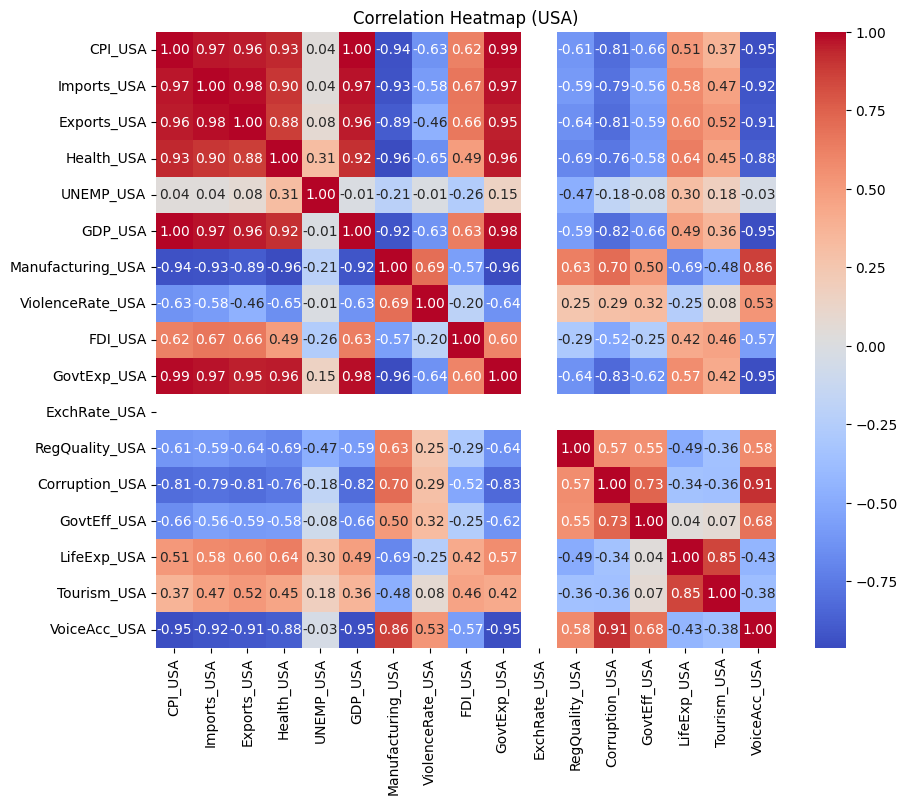

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(10, 8))
sns.heatmap(df_USA.corr(), annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Heatmap (USA)')
plt.show()


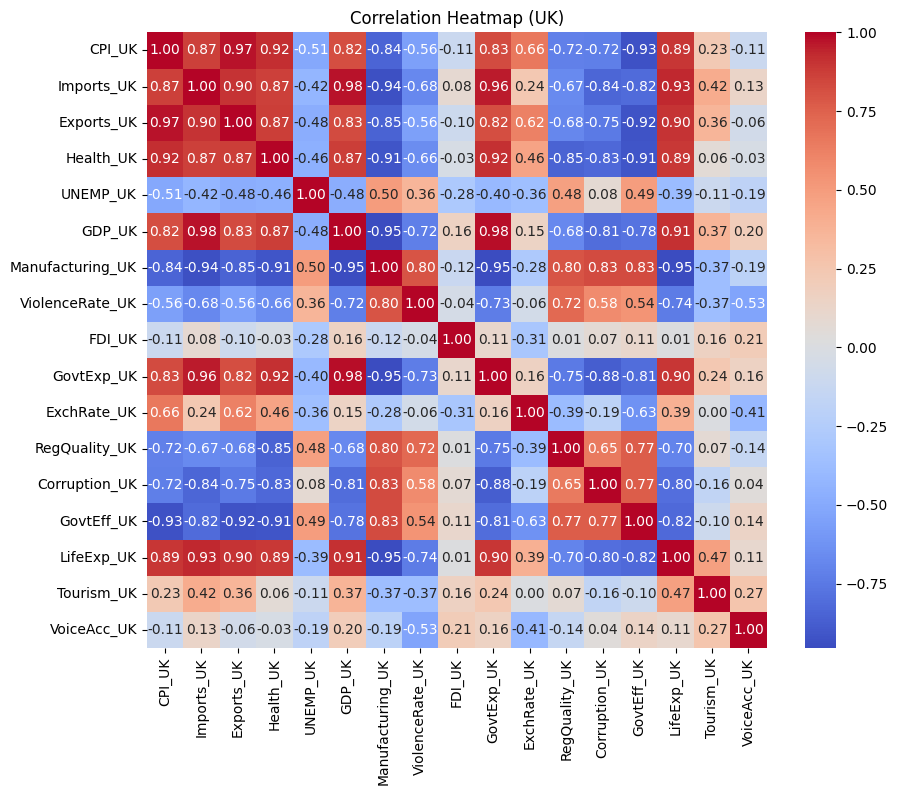

In [ ]:
plt.figure(figsize=(10, 8))
sns.heatmap(df_UK.corr(), annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Heatmap (UK)')
plt.show()


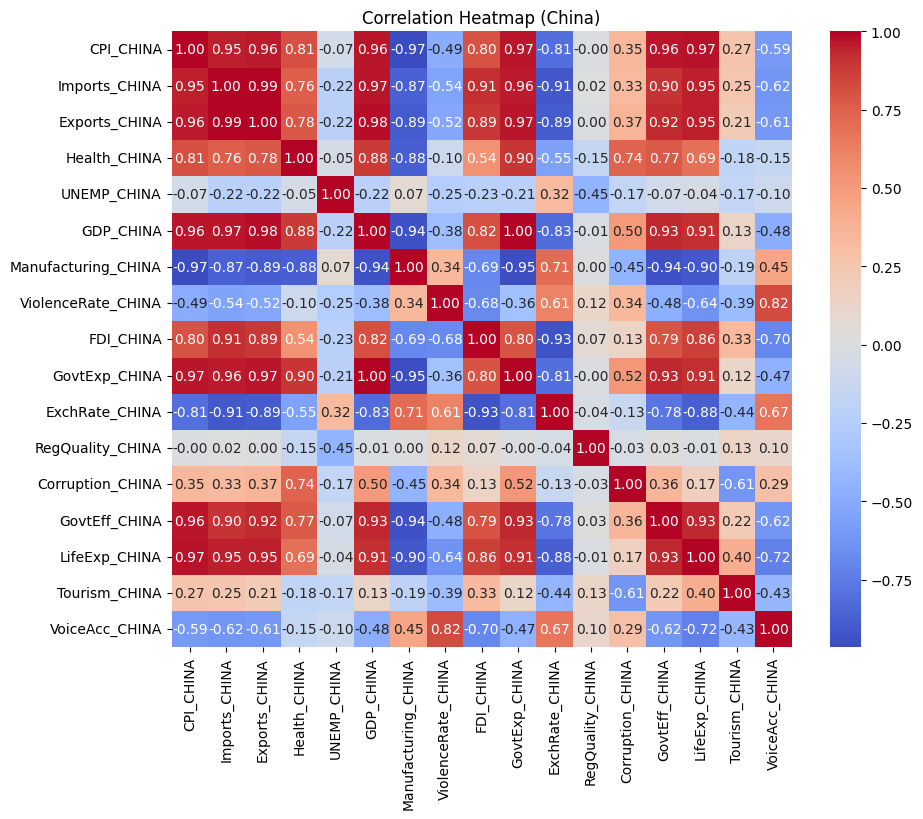

In [ ]:
plt.figure(figsize=(10, 8))
sns.heatmap(df_China.corr(), annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Heatmap (China)')
plt.show()


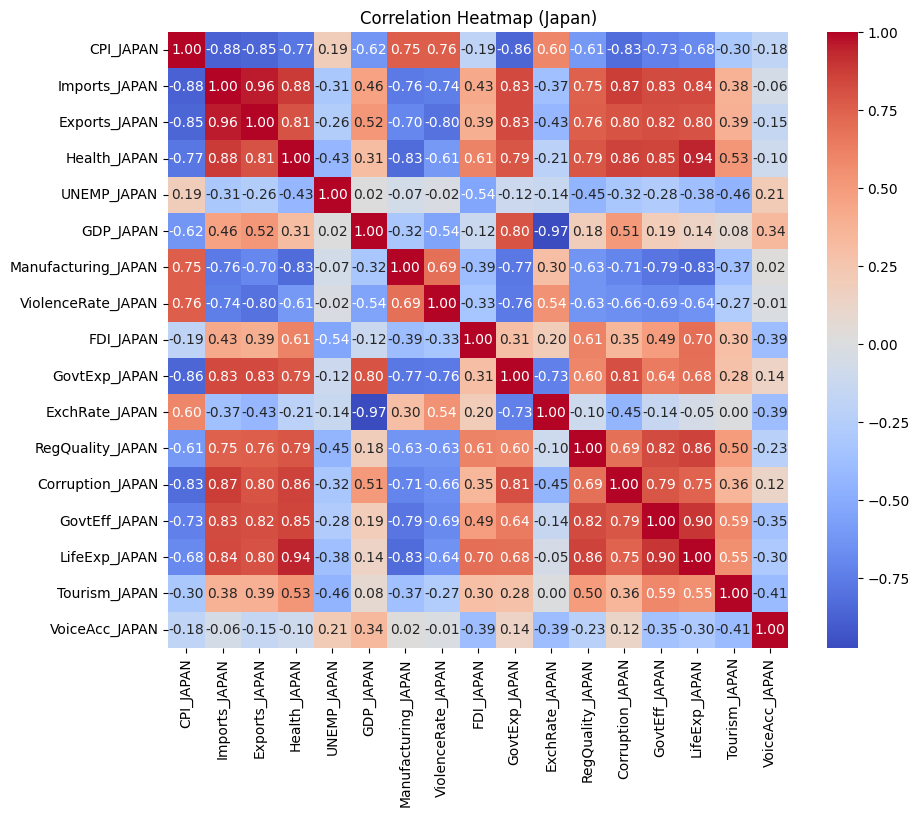

In [ ]:
plt.figure(figsize=(10, 8))
sns.heatmap(df_Japan.corr(), annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Heatmap (Japan)')
plt.show()


In [ ]:
# Converting the index to integer
df_USA.index = df_USA.index.astype(int)
df_UK.index = df_UK.index.astype(int)
df_China.index = df_China.index.astype(int) 
df_Japan.index = df_Japan.index.astype(int)


# Line Charts


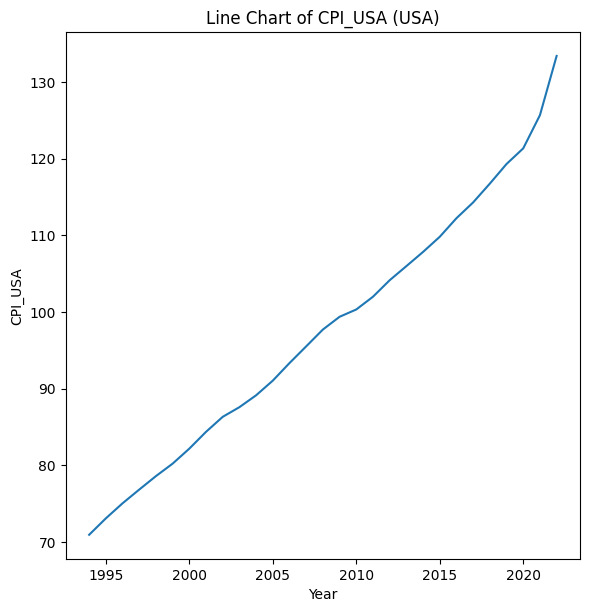

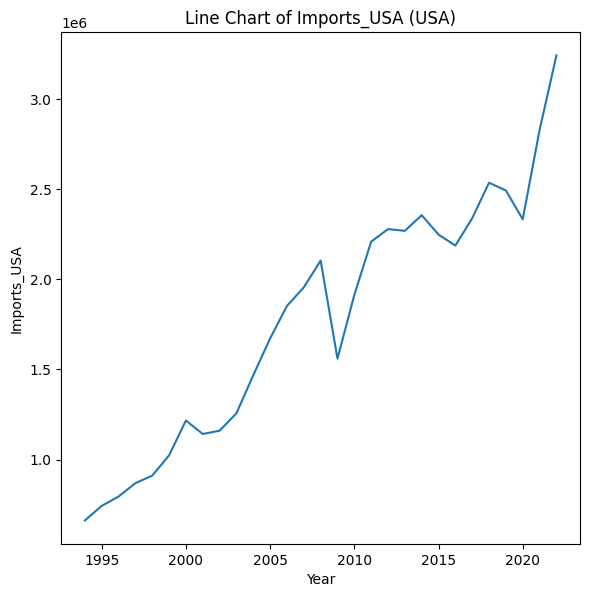

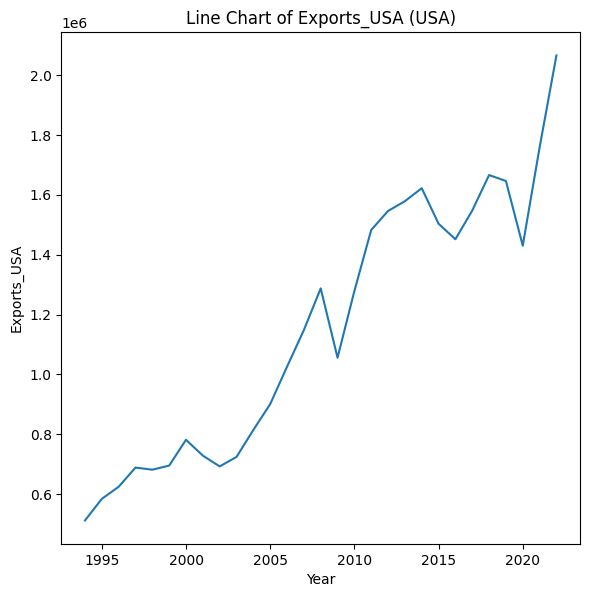

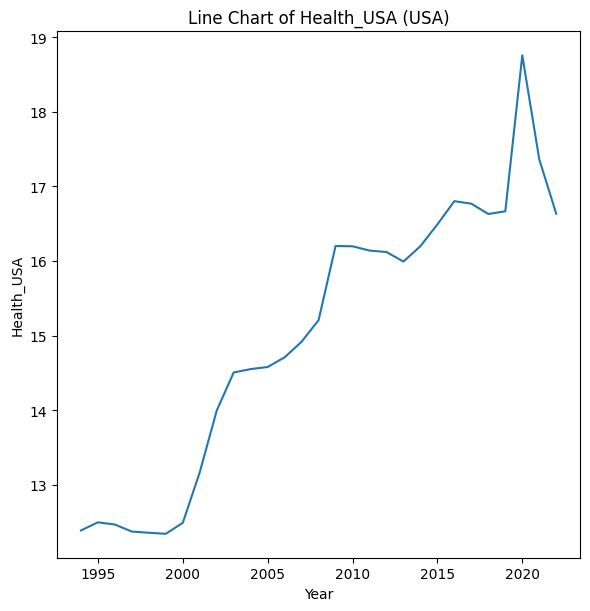

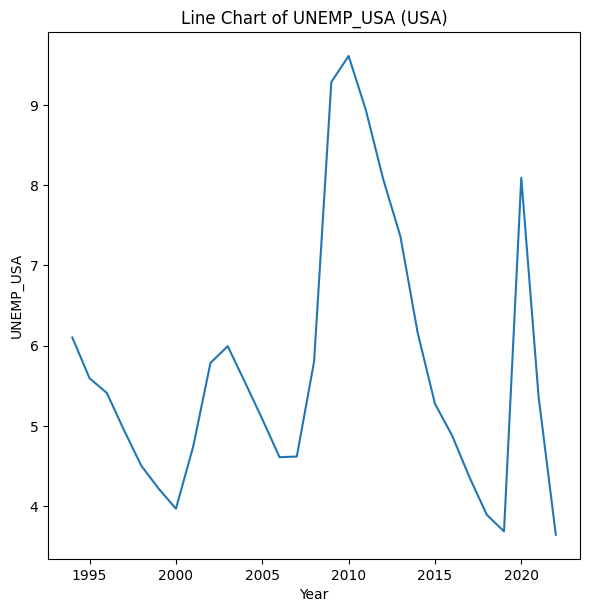

...

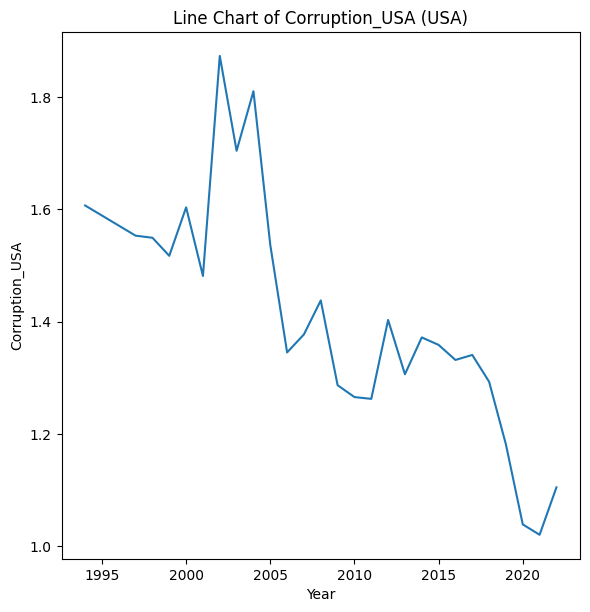

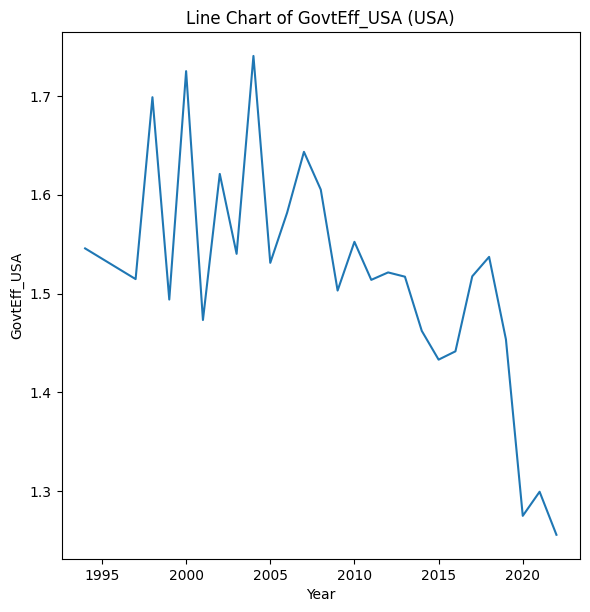

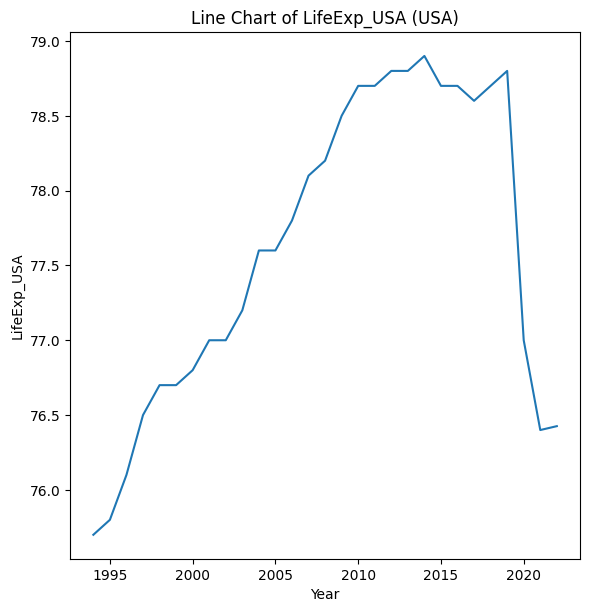

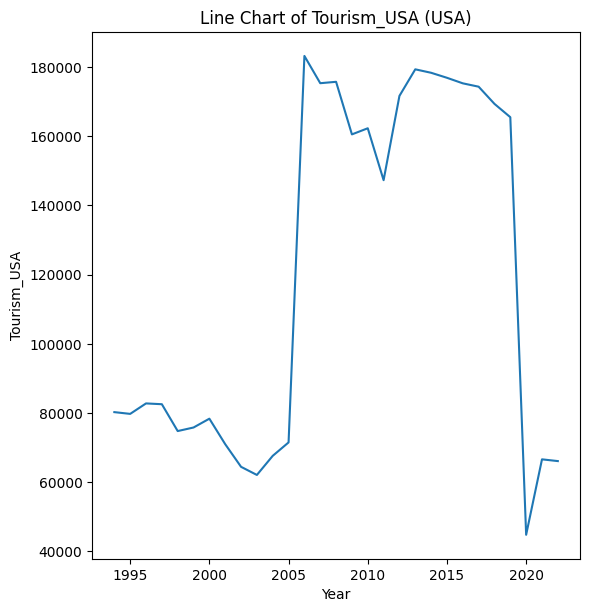

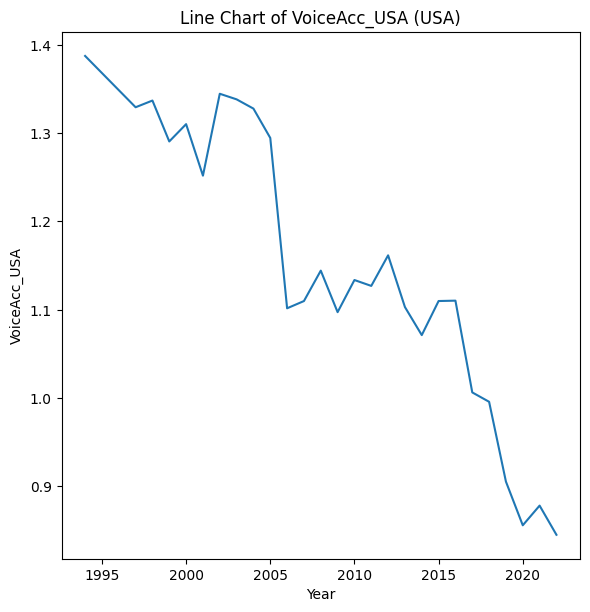

In [ ]:
for column in df_USA.columns:
    plt.figure(figsize=(6, 6))
    plt.plot(df_USA.index, df_USA[column])
    plt.xlabel('Year')
    plt.ylabel(column)
    plt.tight_layout()
    plt.title(f'Line Chart of {column} (USA)')
    plt.show()


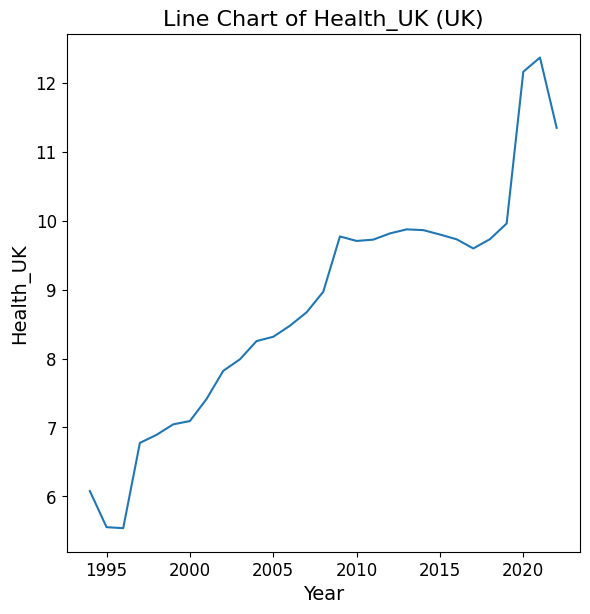

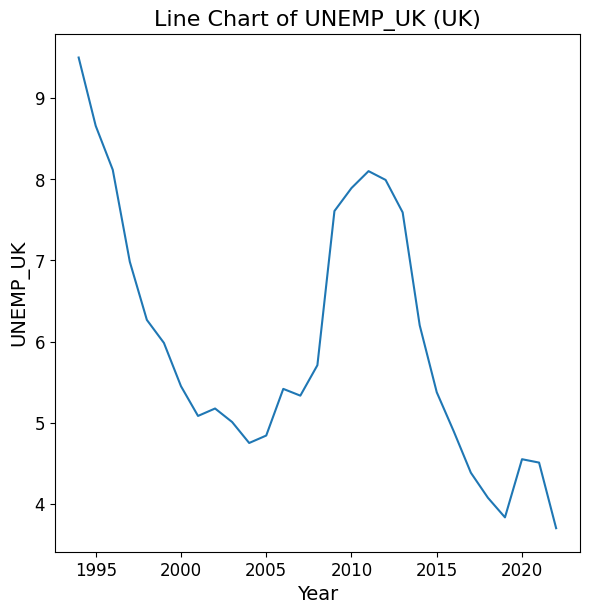

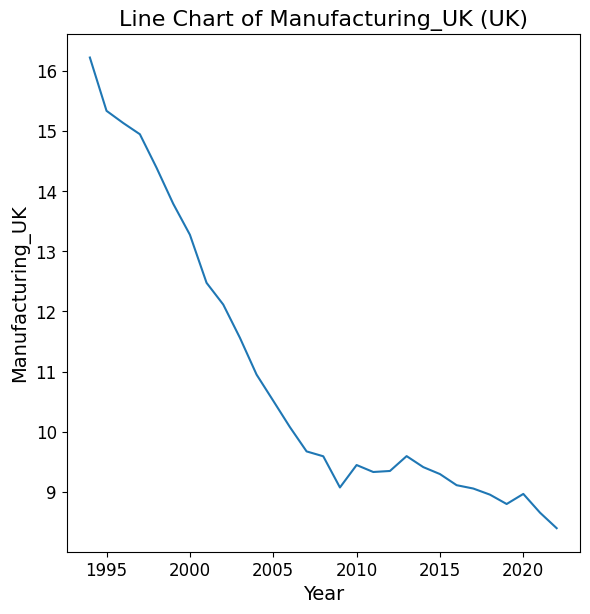

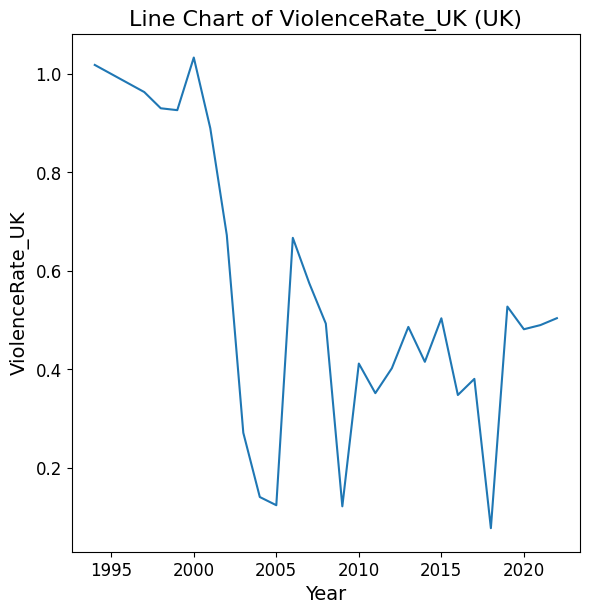

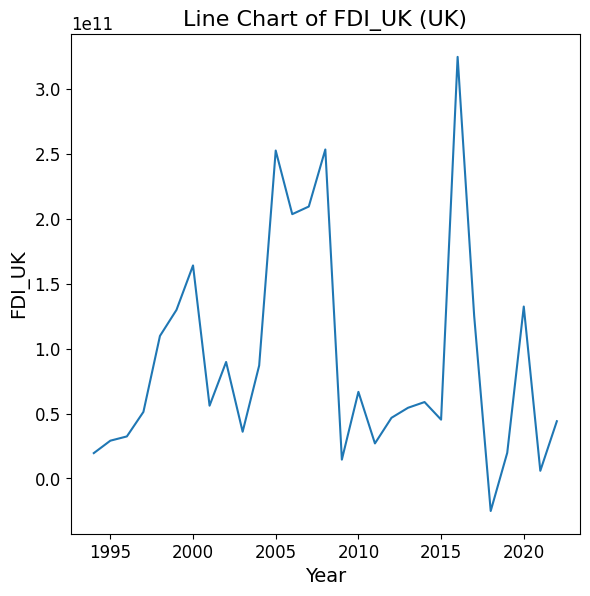

...

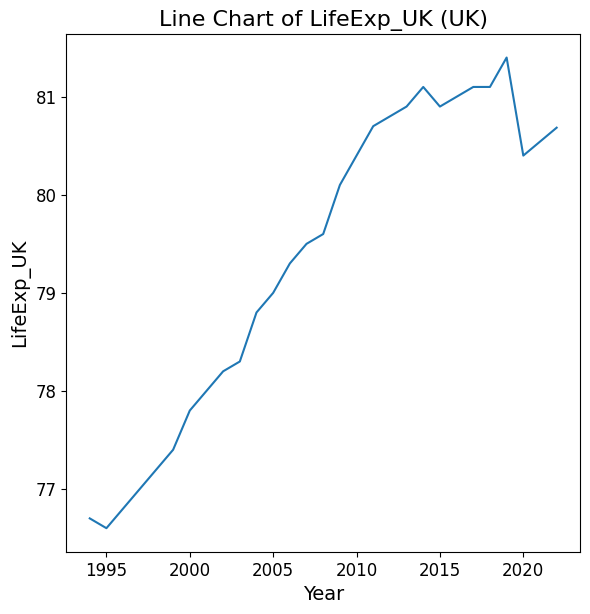

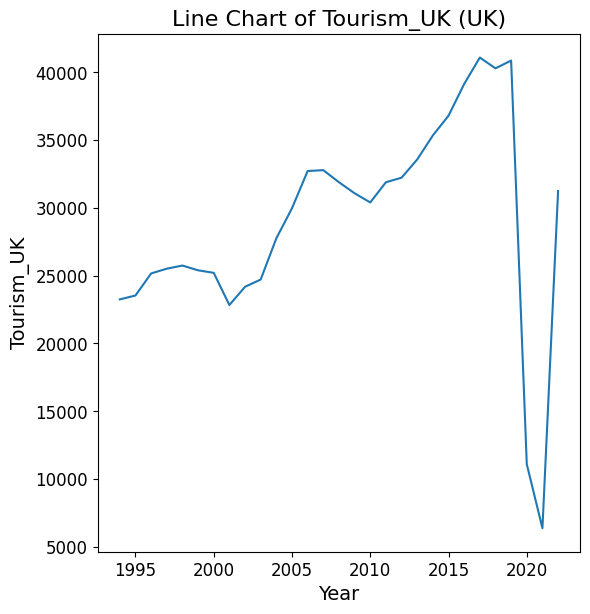

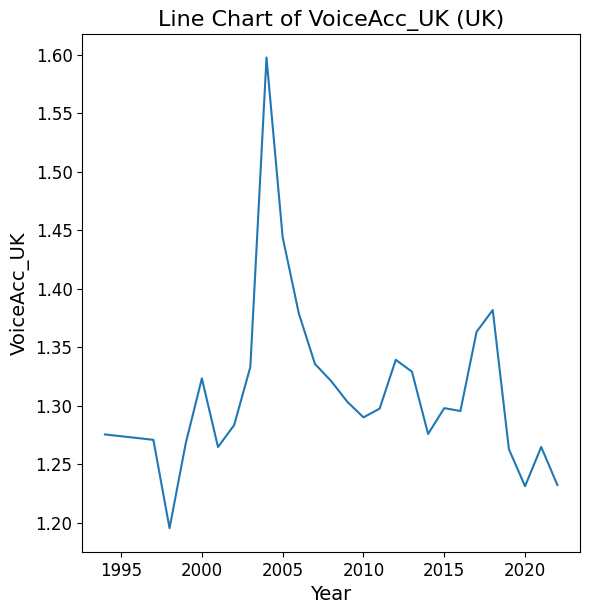

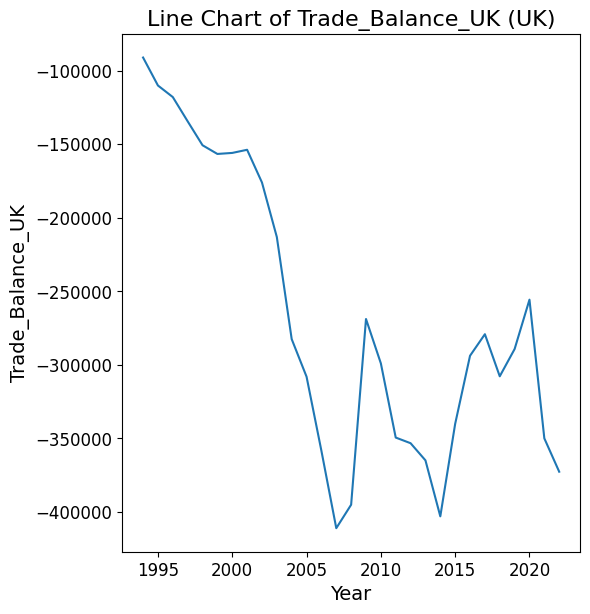

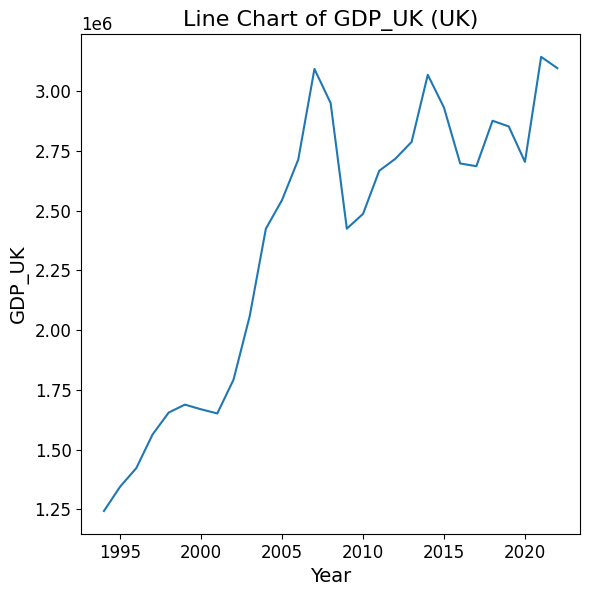

In [ ]:
for column in df_UK.columns:
    plt.figure(figsize=(6, 6))
    plt.plot(df_UK.index, df_UK[column])
    plt.xlabel('Year')
    plt.ylabel(column)
    plt.tight_layout()
    plt.title(f'Line Chart of {column} (UK)')
    plt.show()


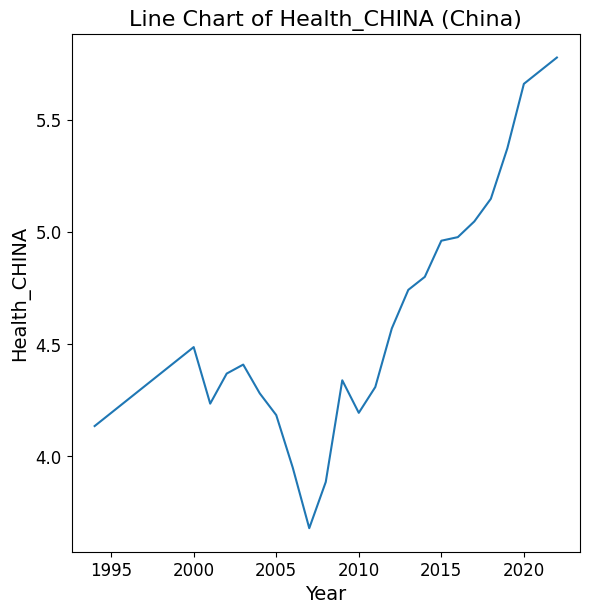

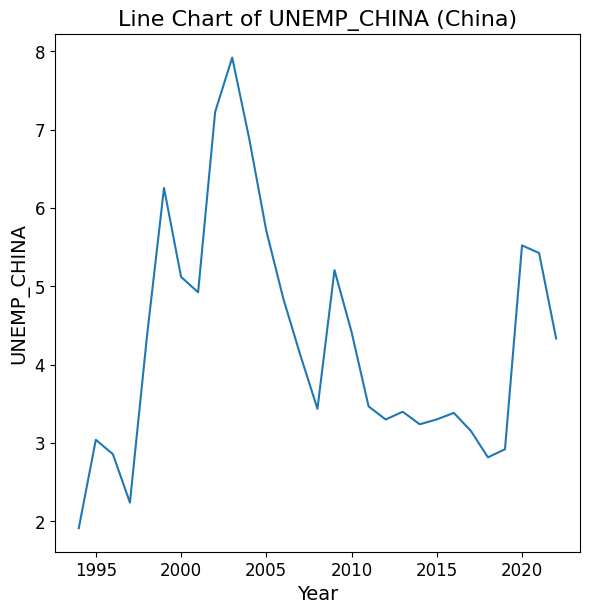

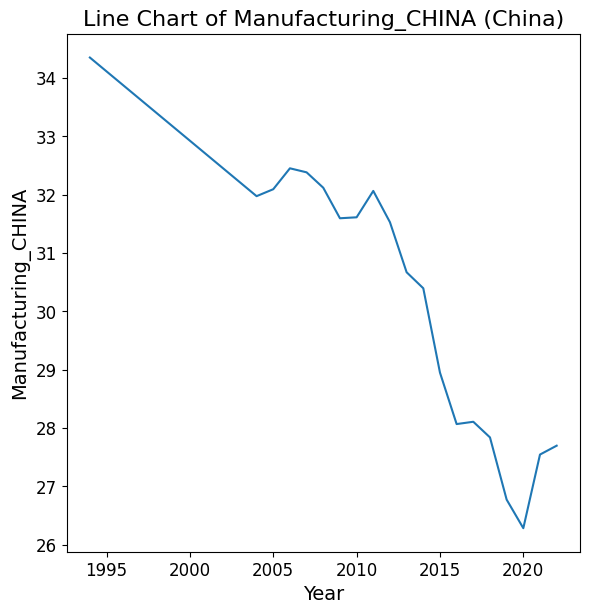

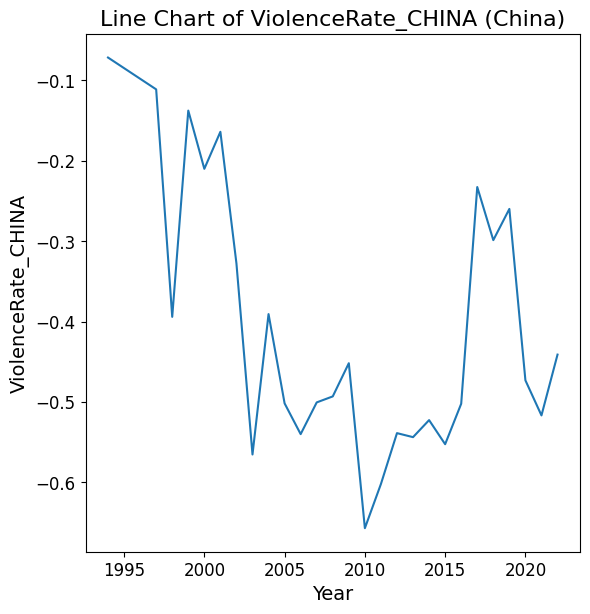

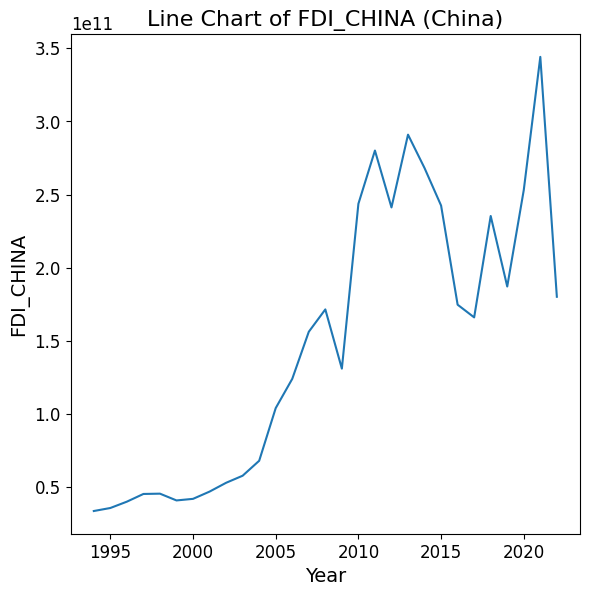

...

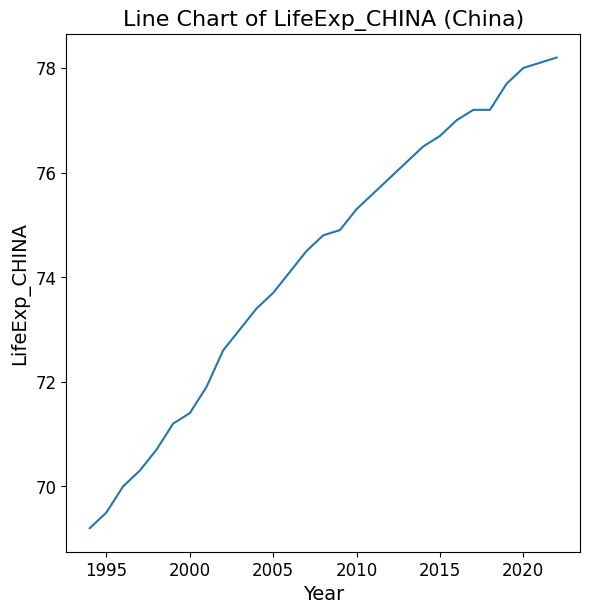

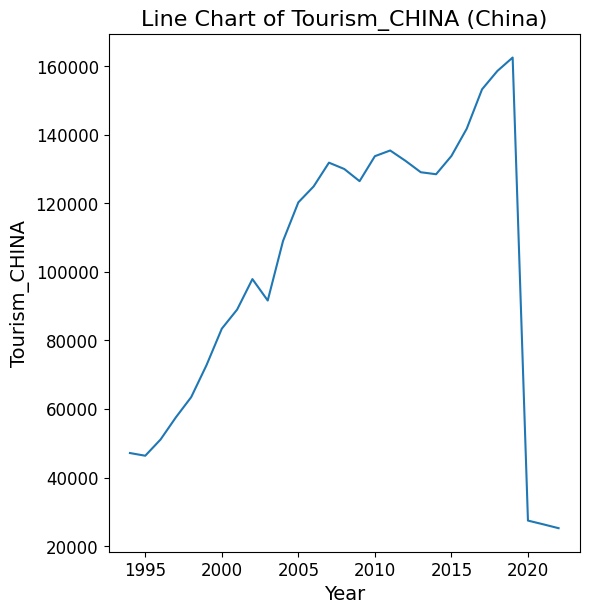

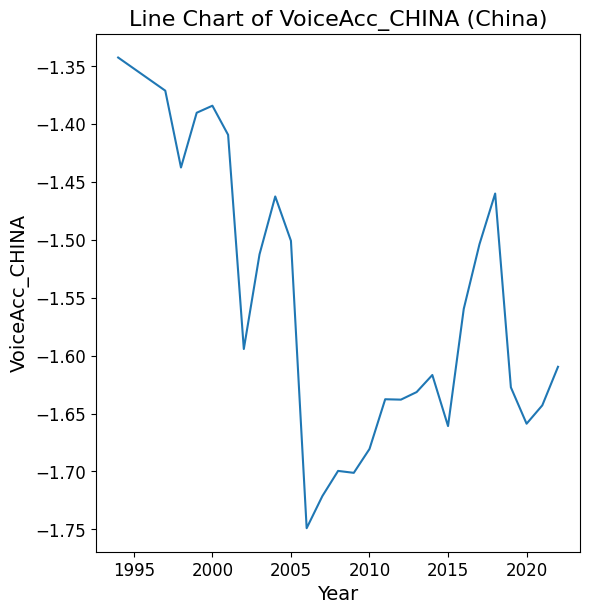

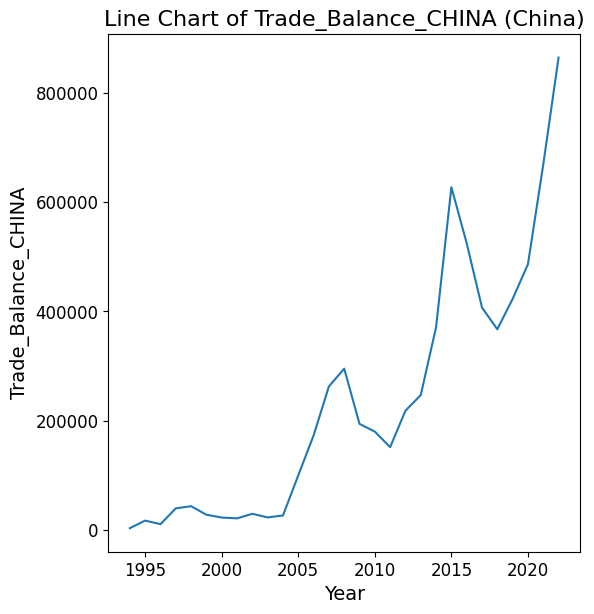

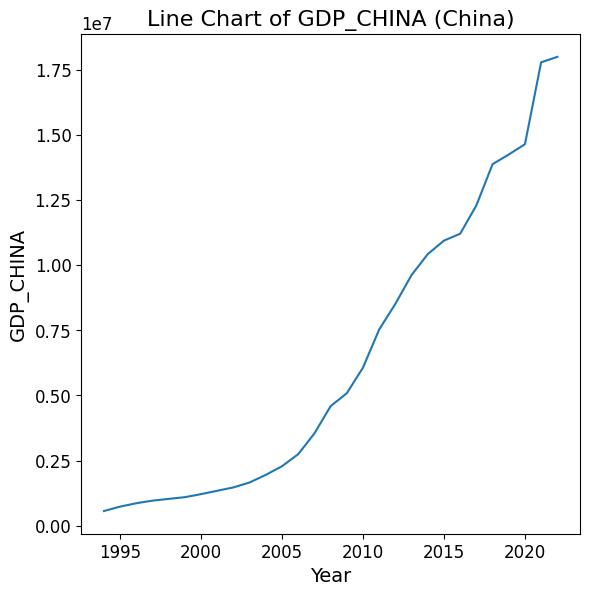

In [ ]:
for column in df_China.columns:
    plt.figure(figsize=(6, 6))
    plt.plot(df_China.index, df_China[column])
    plt.xlabel('Year')
    plt.ylabel(column)
    plt.tight_layout()
    plt.title(f'Line Chart of {column} (China)')
    plt.show()


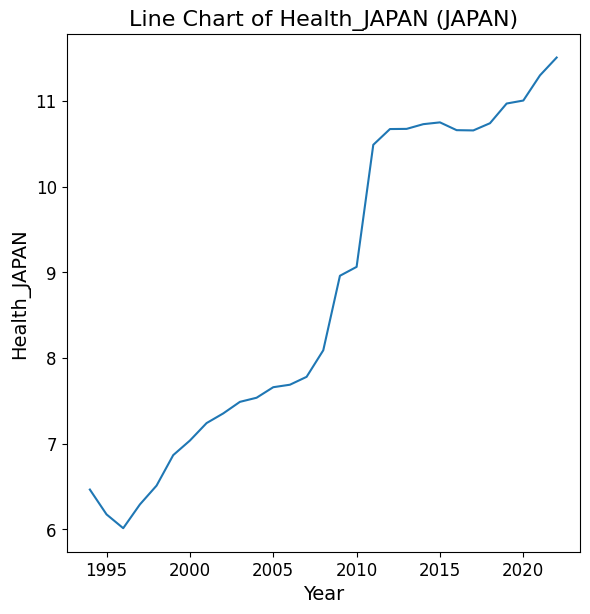

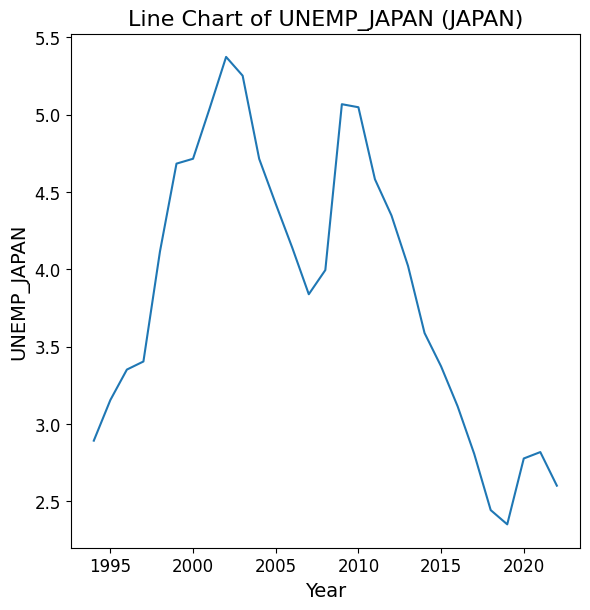

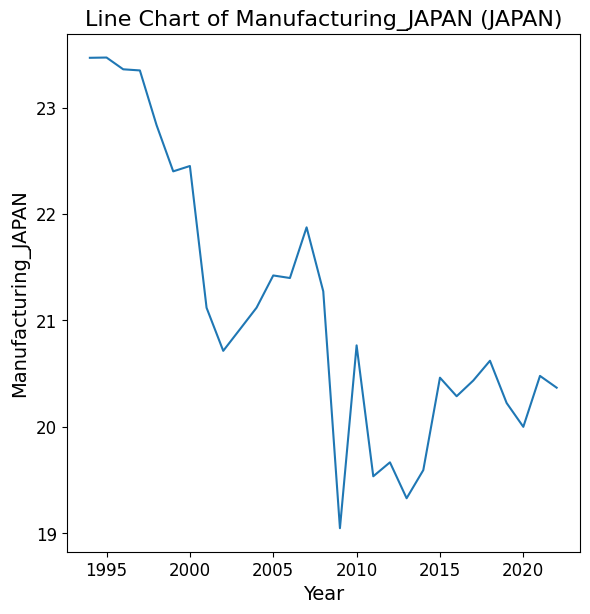

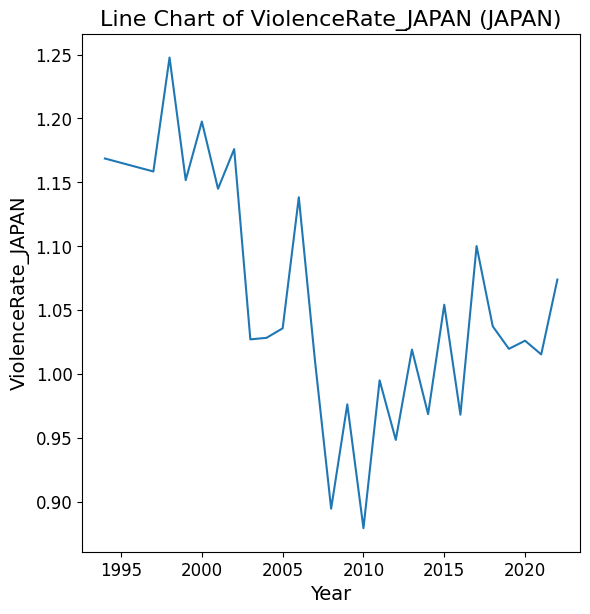

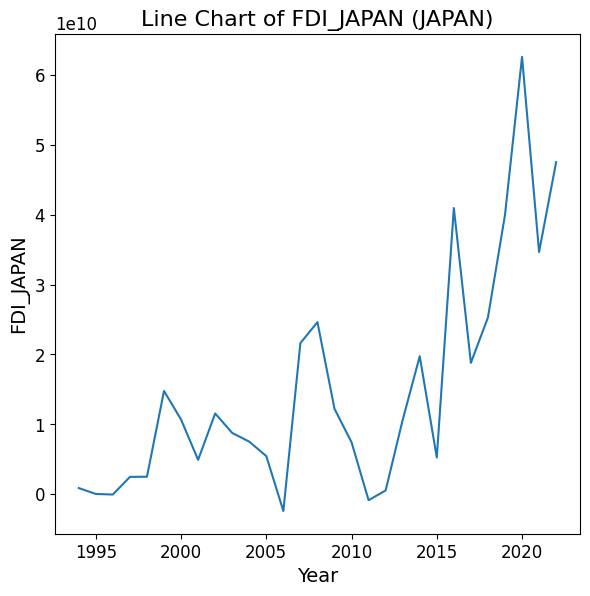

...

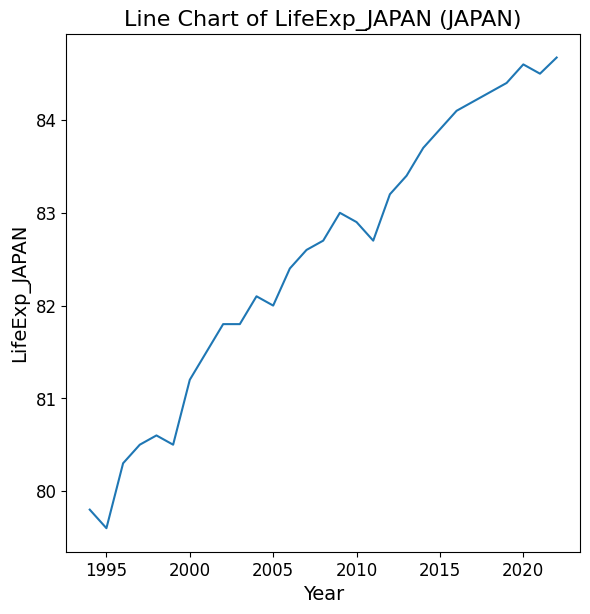

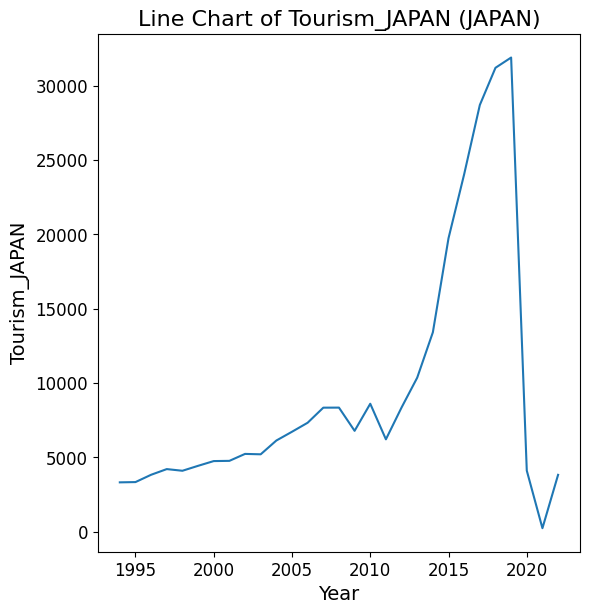

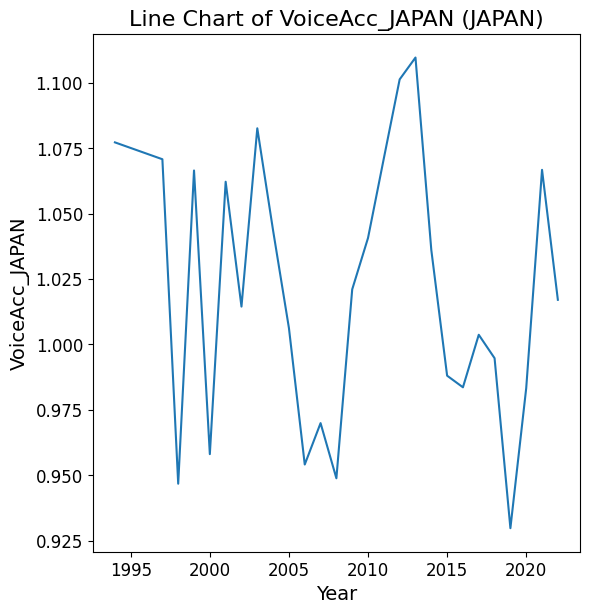

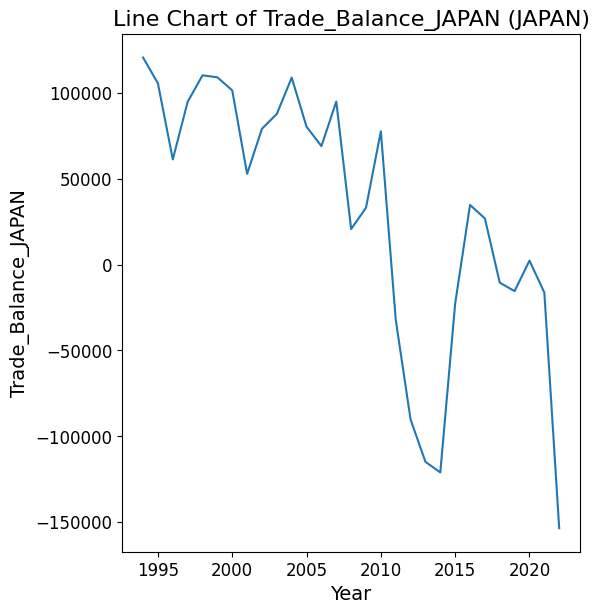

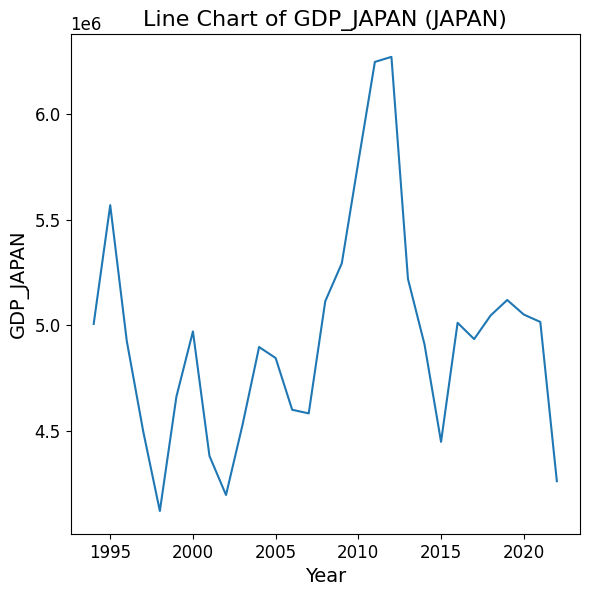

In [ ]:
for column in df_Japan.columns:
    plt.figure(figsize=(6, 6))
    plt.plot(df_Japan.index, df_Japan[column])
    plt.xlabel('Year')
    plt.ylabel(column)
    plt.tight_layout()
    plt.title(f'Line Chart of {column} (JAPAN)')
    plt.show()


In [ ]:
df_USA


,CPI_USA,Imports_USA,Exports_USA,Health_USA,UNEMP_USA,GDP_USA,Manufacturing_USA,ViolenceRate_USA,FDI_USA,GovtExp_USA,ExchRate_USA,RegQuality_USA,Corruption_USA,GovtEff_USA,LifeExp_USA,Tourism_USA,VoiceAcc_USA
Year,,,,,,,,,,,,,,,,,
1994,70.93227,662702.6,512627.0,12.388,6.100000,7287200.0,16.759278,1.009699,5.594000e+10,1.108101e+12,1.0,1.606076,1.606948,1.545607,75.700000,80237.307692,1.387395
1995,73.07384,743492.5,584742.0,12.497,5.591667,7639900.0,16.535245,0.972352,6.908000e+10,1.141743e+12,1.0,1.599589,1.588994,1.535264,75.800000,79732.000000,1.368028
1996,75.03788,795448.4,625077.0,12.467,5.408333,8073200.0,16.311211,0.935006,9.766000e+10,1.172889e+12,1.0,1.593102,1.571041,1.524920,76.100000,82756.000000,1.348661
1997,76.82819,869414.2,689181.0,12.373,4.941667,8577600.0,16.087177,0.897659,1.221500e+11,1.220528e+12,1.0,1.586615,1.553088,1.514577,76.500000,82525.000000,1.329294
1998,78.58450,911417.8,682137.0,12.357,4.500000,9062800.0,15.774325,0.879613,2.111500e+11,1.267607e+12,1.0,1.610037,1.549399,1.698527,76.700000,74767.000000,1.336877
1999,80.21239,1023410.0,695798.0,12.343,4.216667,9631300.0,15.459067,0.822966,3.124490e+11,1.351427e+12,1.0,1.573641,1.517182,1.493890,76.700000,75796.000000,1.290560
2000,82.16888,1216793.0,781918.0,12.490,3.966667,10251000.0,15.115075,1.082809,3.491250e+11,1.437588e+12,1.0,1.696121,1.603597,1.724887,76.800000,78343.000000,1.310167
2001,84.35955,1142131.0,729100.0,13.168,4.741667,10582000.0,13.919309,0.748273,1.724960e+11,1.538151e+12,1.0,1.560667,1.481275,1.473204,77.000000,70975.000000,1.251826
2002,86.31604,1160497.0,693104.0,13.995,5.783333,10929200.0,13.452878,0.285477,1.110550e+11,1.645819e+12,1.0,1.551741,1.873597,1.620928,77.000000,64434.000000,1.344568


In [ ]:
# List of dataframes
dataframes = [df_USA, df_UK, df_Japan, df_China]

# Iterate through each dataframe and print column names
for i, df in enumerate(dataframes, 1):
    print(f"Columns for df_{i}:")
    print(df.columns.tolist())
    print()


Columns for df_1:
['CPI_USA', 'Imports_USA', 'Exports_USA', 'Health_USA', 'UNEMP_USA', 'GDP_USA', 'Manufacturing_USA', 'ViolenceRate_USA', 'FDI_USA', 'GovtExp_USA', 'ExchRate_USA', 'RegQuality_USA', 'Corruption_USA', 'GovtEff_USA', 'LifeExp_USA', 'Tourism_USA', 'VoiceAcc_USA']

Columns for df_2:
['CPI_UK', 'Imports_UK', 'Exports_UK', 'Health_UK', 'UNEMP_UK', 'GDP_UK', 'Manufacturing_UK', 'ViolenceRate_UK', 'FDI_UK', 'GovtExp_UK', 'ExchRate_UK', 'RegQuality_UK', 'Corruption_UK', 'GovtEff_UK', 'LifeExp_UK', 'Tourism_UK', 'VoiceAcc_UK']

Columns for df_3:
['CPI_JAPAN', 'Imports_JAPAN', 'Exports_JAPAN', 'Health_JAPAN', 'UNEMP_JAPAN', 'GDP_JAPAN', 'Manufacturing_JAPAN', 'ViolenceRate_JAPAN', 'FDI_JAPAN', 'GovtExp_JAPAN', 'ExchRate_JAPAN', 'RegQuality_JAPAN', 'Corruption_JAPAN', 'GovtEff_JAPAN', 'LifeExp_JAPAN', 'Tourism_JAPAN', 'VoiceAcc_JAPAN']

Columns for df_4:
['CPI_CHINA', 'Imports_CHINA', 'Exports_CHINA', 'Health_CHINA', 'UNEMP_CHINA', 'GDP_CHINA', 'Manufacturing_CHINA', 'ViolenceRate

In [ ]:
# Remove 'CPI' and 'ExchRate' columns from df_1
df_USA.drop(columns=['CPI_USA', 'ExchRate_USA'], inplace=True)

# Remove 'CPI' and 'ExchRate' columns from df_2
df_UK.drop(columns=['CPI_UK', 'ExchRate_UK'], inplace=True)

# Remove 'CPI' and 'ExchRate' columns from df_3
df_Japan.drop(columns=['CPI_JAPAN', 'ExchRate_JAPAN'], inplace=True)

# Remove 'CPI' and 'ExchRate' columns from df_4
df_China.drop(columns=['CPI_CHINA', 'ExchRate_CHINA'], inplace=True)


/tmp/ipykernel_87/814317001.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_USA.drop(columns=['CPI_USA', 'ExchRate_USA'], inplace=True)
/tmp/ipykernel_87/814317001.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_UK.drop(columns=['CPI_UK', 'ExchRate_UK'], inplace=True)
/tmp/ipykernel_87/814317001.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Japan.drop(columns=['CPI_JAPAN', 'ExchRate_JAPAN'], inplace=True)
/tmp/ip

In [ ]:
df_USA


,Imports_USA,Exports_USA,Health_USA,UNEMP_USA,GDP_USA,Manufacturing_USA,ViolenceRate_USA,FDI_USA,GovtExp_USA,RegQuality_USA,Corruption_USA,GovtEff_USA,LifeExp_USA,Tourism_USA,VoiceAcc_USA
Year,,,,,,,,,,,,,,,
1994,662702.6,512627.0,12.388,6.100000,7287200.0,16.759278,1.009699,5.594000e+10,1.108101e+12,1.606076,1.606948,1.545607,75.700000,80237.307692,1.387395
1995,743492.5,584742.0,12.497,5.591667,7639900.0,16.535245,0.972352,6.908000e+10,1.141743e+12,1.599589,1.588994,1.535264,75.800000,79732.000000,1.368028
1996,795448.4,625077.0,12.467,5.408333,8073200.0,16.311211,0.935006,9.766000e+10,1.172889e+12,1.593102,1.571041,1.524920,76.100000,82756.000000,1.348661
1997,869414.2,689181.0,12.373,4.941667,8577600.0,16.087177,0.897659,1.221500e+11,1.220528e+12,1.586615,1.553088,1.514577,76.500000,82525.000000,1.329294
1998,911417.8,682137.0,12.357,4.500000,9062800.0,15.774325,0.879613,2.111500e+11,1.267607e+12,1.610037,1.549399,1.698527,76.700000,74767.000000,1.336877
1999,1023410.0,695798.0,12.343,4.216667,9631300.0,15.459067,0.822966,3.124490e+11,1.351427e+12,1.573641,1.517182,1.493890,76.700000,75796.000000,1.290560
2000,1216793.0,781918.0,12.490,3.966667,10251000.0,15.115075,1.082809,3.491250e+11,1.437588e+12,1.696121,1.603597,1.724887,76.800000,78343.000000,1.310167
2001,1142131.0,729100.0,13.168,4.741667,10582000.0,13.919309,0.748273,1.724960e+11,1.538151e+12,1.560667,1.481275,1.473204,77.000000,70975.000000,1.251826
2002,1160497.0,693104.0,13.995,5.783333,10929200.0,13.452878,0.285477,1.110550e+11,1.645819e+12,1.551741,1.873597,1.620928,77.000000,64434.000000,1.344568


In [ ]:
# Create a new column by subtracting 'Imports' from 'Exports'
df_USA['Trade_Balance_USA'] = df_USA['Exports_USA'] - df_USA['Imports_USA']

df_UK['Trade_Balance_UK'] = df_UK['Exports_UK'] - df_UK['Imports_UK']


df_Japan['Trade_Balance_JAPAN'] = df_Japan['Exports_JAPAN'] - df_Japan['Imports_JAPAN']


df_China['Trade_Balance_CHINA'] = df_China['Exports_CHINA'] - df_China['Imports_CHINA']



/tmp/ipykernel_87/425299252.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_USA['Trade_Balance_USA'] = df_USA['Exports_USA'] - df_USA['Imports_USA']
/tmp/ipykernel_87/425299252.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_UK['Trade_Balance_UK'] = df_UK['Exports_UK'] - df_UK['Imports_UK']
/tmp/ipykernel_87/425299252.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the 

In [ ]:
df_USA.drop(columns=['Imports_USA', 'Exports_USA'], inplace=True)
df_UK.drop(columns=['Imports_UK', 'Exports_UK'], inplace=True)
df_Japan.drop(columns=['Imports_JAPAN', 'Exports_JAPAN'], inplace=True)
df_China.drop(columns=['Imports_CHINA', 'Exports_CHINA'], inplace=True)


/tmp/ipykernel_87/1444418451.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_USA.drop(columns=['Imports_USA', 'Exports_USA'], inplace=True)
/tmp/ipykernel_87/1444418451.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_UK.drop(columns=['Imports_UK', 'Exports_UK'], inplace=True)
/tmp/ipykernel_87/1444418451.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Japan.drop(columns=['Imports_JAPAN', 'Exports_JAPAN'], inplace=T

In [ ]:
df_USA.head()


,Health_USA,UNEMP_USA,GDP_USA,Manufacturing_USA,ViolenceRate_USA,FDI_USA,GovtExp_USA,RegQuality_USA,Corruption_USA,GovtEff_USA,LifeExp_USA,Tourism_USA,VoiceAcc_USA,Trade_Balance_USA
Year,,,,,,,,,,,,,,
1994,12.388,6.100000,7287200.0,16.759278,1.009699,5.594000e+10,1.108101e+12,1.606076,1.606948,1.545607,75.7,80237.307692,1.387395,-150075.6
1995,12.497,5.591667,7639900.0,16.535245,0.972352,6.908000e+10,1.141743e+12,1.599589,1.588994,1.535264,75.8,79732.000000,1.368028,-158750.5
1996,12.467,5.408333,8073200.0,16.311211,0.935006,9.766000e+10,1.172889e+12,1.593102,1.571041,1.524920,76.1,82756.000000,1.348661,-170371.4
1997,12.373,4.941667,8577600.0,16.087177,0.897659,1.221500e+11,1.220528e+12,1.586615,1.553088,1.514577,76.5,82525.000000,1.329294,-180233.2
1998,12.357,4.500000,9062800.0,15.774325,0.879613,2.111500e+11,1.267607e+12,1.610037,1.549399,1.698527,76.7,74767.000000,1.336877,-229280.8


In [ ]:
df_USA


,Health_USA,UNEMP_USA,GDP_USA,Manufacturing_USA,ViolenceRate_USA,FDI_USA,GovtExp_USA,RegQuality_USA,Corruption_USA,GovtEff_USA,LifeExp_USA,Tourism_USA,VoiceAcc_USA,Trade_Balance_USA
Year,,,,,,,,,,,,,,
1994,12.388,6.100000,7287200.0,16.759278,1.009699,5.594000e+10,1.108101e+12,1.606076,1.606948,1.545607,75.700000,80237.307692,1.387395,-150075.6
1995,12.497,5.591667,7639900.0,16.535245,0.972352,6.908000e+10,1.141743e+12,1.599589,1.588994,1.535264,75.800000,79732.000000,1.368028,-158750.5
1996,12.467,5.408333,8073200.0,16.311211,0.935006,9.766000e+10,1.172889e+12,1.593102,1.571041,1.524920,76.100000,82756.000000,1.348661,-170371.4
1997,12.373,4.941667,8577600.0,16.087177,0.897659,1.221500e+11,1.220528e+12,1.586615,1.553088,1.514577,76.500000,82525.000000,1.329294,-180233.2
1998,12.357,4.500000,9062800.0,15.774325,0.879613,2.111500e+11,1.267607e+12,1.610037,1.549399,1.698527,76.700000,74767.000000,1.336877,-229280.8
1999,12.343,4.216667,9631300.0,15.459067,0.822966,3.124490e+11,1.351427e+12,1.573641,1.517182,1.493890,76.700000,75796.000000,1.290560,-327612.0
2000,12.490,3.966667,10251000.0,15.115075,1.082809,3.491250e+11,1.437588e+12,1.696121,1.603597,1.724887,76.800000,78343.000000,1.310167,-434875.0
2001,13.168,4.741667,10582000.0,13.919309,0.748273,1.724960e+11,1.538151e+12,1.560667,1.481275,1.473204,77.000000,70975.000000,1.251826,-413031.0
2002,13.995,5.783333,10929200.0,13.452878,0.285477,1.110550e+11,1.645819e+12,1.551741,1.873597,1.620928,77.000000,64434.000000,1.344568,-467393.0


In [ ]:
# Move GDP column to the last position
gdp_column = df_USA.pop('GDP_USA')
df_USA['GDP_USA'] = gdp_column

# Now the GDP column should be the last column in your DataFrame


/tmp/ipykernel_87/1178188032.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_USA['GDP_USA'] = gdp_column


In [ ]:
df_USA


,Health_USA,UNEMP_USA,Manufacturing_USA,ViolenceRate_USA,FDI_USA,GovtExp_USA,RegQuality_USA,Corruption_USA,GovtEff_USA,LifeExp_USA,Tourism_USA,VoiceAcc_USA,Trade_Balance_USA,GDP_USA
Year,,,,,,,,,,,,,,
1994,12.388,6.100000,16.759278,1.009699,5.594000e+10,1.108101e+12,1.606076,1.606948,1.545607,75.700000,80237.307692,1.387395,-150075.6,7287200.0
1995,12.497,5.591667,16.535245,0.972352,6.908000e+10,1.141743e+12,1.599589,1.588994,1.535264,75.800000,79732.000000,1.368028,-158750.5,7639900.0
1996,12.467,5.408333,16.311211,0.935006,9.766000e+10,1.172889e+12,1.593102,1.571041,1.524920,76.100000,82756.000000,1.348661,-170371.4,8073200.0
1997,12.373,4.941667,16.087177,0.897659,1.221500e+11,1.220528e+12,1.586615,1.553088,1.514577,76.500000,82525.000000,1.329294,-180233.2,8577600.0
1998,12.357,4.500000,15.774325,0.879613,2.111500e+11,1.267607e+12,1.610037,1.549399,1.698527,76.700000,74767.000000,1.336877,-229280.8,9062800.0
1999,12.343,4.216667,15.459067,0.822966,3.124490e+11,1.351427e+12,1.573641,1.517182,1.493890,76.700000,75796.000000,1.290560,-327612.0,9631300.0
2000,12.490,3.966667,15.115075,1.082809,3.491250e+11,1.437588e+12,1.696121,1.603597,1.724887,76.800000,78343.000000,1.310167,-434875.0,10251000.0
2001,13.168,4.741667,13.919309,0.748273,1.724960e+11,1.538151e+12,1.560667,1.481275,1.473204,77.000000,70975.000000,1.251826,-413031.0,10582000.0
2002,13.995,5.783333,13.452878,0.285477,1.110550e+11,1.645819e+12,1.551741,1.873597,1.620928,77.000000,64434.000000,1.344568,-467393.0,10929200.0


In [ ]:
df_USA.columns


Index(['Health_USA', 'UNEMP_USA', 'Manufacturing_USA', 'ViolenceRate_USA',
       'FDI_USA', 'GovtExp_USA', 'RegQuality_USA', 'Corruption_USA',
       'GovtEff_USA', 'LifeExp_USA', 'Tourism_USA', 'VoiceAcc_USA',
       'Trade_Balance_USA', 'GDP_USA'],
      dtype='object')

In [ ]:
len(df_USA)


29

In [ ]:
print(df_USA.index)


Index([1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005,
       2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017,
       2018, 2019, 2020, 2021, 2022],
      dtype='int64', name='Year')


In [ ]:
df_USA


,Health_USA,UNEMP_USA,Manufacturing_USA,ViolenceRate_USA,FDI_USA,GovtExp_USA,RegQuality_USA,Corruption_USA,GovtEff_USA,LifeExp_USA,Tourism_USA,VoiceAcc_USA,Trade_Balance_USA,GDP_USA
Year,,,,,,,,,,,,,,
1994,12.388,6.100000,16.759278,1.009699,5.594000e+10,1.108101e+12,1.606076,1.606948,1.545607,75.700000,80237.307692,1.387395,-150075.6,7287200.0
1995,12.497,5.591667,16.535245,0.972352,6.908000e+10,1.141743e+12,1.599589,1.588994,1.535264,75.800000,79732.000000,1.368028,-158750.5,7639900.0
1996,12.467,5.408333,16.311211,0.935006,9.766000e+10,1.172889e+12,1.593102,1.571041,1.524920,76.100000,82756.000000,1.348661,-170371.4,8073200.0
1997,12.373,4.941667,16.087177,0.897659,1.221500e+11,1.220528e+12,1.586615,1.553088,1.514577,76.500000,82525.000000,1.329294,-180233.2,8577600.0
1998,12.357,4.500000,15.774325,0.879613,2.111500e+11,1.267607e+12,1.610037,1.549399,1.698527,76.700000,74767.000000,1.336877,-229280.8,9062800.0
1999,12.343,4.216667,15.459067,0.822966,3.124490e+11,1.351427e+12,1.573641,1.517182,1.493890,76.700000,75796.000000,1.290560,-327612.0,9631300.0
2000,12.490,3.966667,15.115075,1.082809,3.491250e+11,1.437588e+12,1.696121,1.603597,1.724887,76.800000,78343.000000,1.310167,-434875.0,10251000.0
2001,13.168,4.741667,13.919309,0.748273,1.724960e+11,1.538151e+12,1.560667,1.481275,1.473204,77.000000,70975.000000,1.251826,-413031.0,10582000.0
2002,13.995,5.783333,13.452878,0.285477,1.110550e+11,1.645819e+12,1.551741,1.873597,1.620928,77.000000,64434.000000,1.344568,-467393.0,10929200.0


In [ ]:
print(df_USA.index)


Index([1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005,
       2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017,
       2018, 2019, 2020, 2021, 2022],
      dtype='int64', name='Year')


In [ ]:
df_USA


,Health_USA,UNEMP_USA,Manufacturing_USA,ViolenceRate_USA,FDI_USA,GovtExp_USA,RegQuality_USA,Corruption_USA,GovtEff_USA,LifeExp_USA,Tourism_USA,VoiceAcc_USA,Trade_Balance_USA,GDP_USA
Year,,,,,,,,,,,,,,
1994,12.388,6.100000,16.759278,1.009699,5.594000e+10,1.108101e+12,1.606076,1.606948,1.545607,75.700000,80237.307692,1.387395,-150075.6,7287200.0
1995,12.497,5.591667,16.535245,0.972352,6.908000e+10,1.141743e+12,1.599589,1.588994,1.535264,75.800000,79732.000000,1.368028,-158750.5,7639900.0
1996,12.467,5.408333,16.311211,0.935006,9.766000e+10,1.172889e+12,1.593102,1.571041,1.524920,76.100000,82756.000000,1.348661,-170371.4,8073200.0
1997,12.373,4.941667,16.087177,0.897659,1.221500e+11,1.220528e+12,1.586615,1.553088,1.514577,76.500000,82525.000000,1.329294,-180233.2,8577600.0
1998,12.357,4.500000,15.774325,0.879613,2.111500e+11,1.267607e+12,1.610037,1.549399,1.698527,76.700000,74767.000000,1.336877,-229280.8,9062800.0
1999,12.343,4.216667,15.459067,0.822966,3.124490e+11,1.351427e+12,1.573641,1.517182,1.493890,76.700000,75796.000000,1.290560,-327612.0,9631300.0
2000,12.490,3.966667,15.115075,1.082809,3.491250e+11,1.437588e+12,1.696121,1.603597,1.724887,76.800000,78343.000000,1.310167,-434875.0,10251000.0
2001,13.168,4.741667,13.919309,0.748273,1.724960e+11,1.538151e+12,1.560667,1.481275,1.473204,77.000000,70975.000000,1.251826,-413031.0,10582000.0
2002,13.995,5.783333,13.452878,0.285477,1.110550e+11,1.645819e+12,1.551741,1.873597,1.620928,77.000000,64434.000000,1.344568,-467393.0,10929200.0


# ARIMA Model (USA)


In [ ]:
import pandas as pd
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_squared_error
import numpy as np

# Selecting all features including GDP_USA
X = df_USA.iloc[:, :-1]  # Excluding the last column
y = df_USA.iloc[:, -1]    # Selecting only the last column (GDP_USA)

# Apply differencing to make the data stationary
y_diff = y.diff().dropna()

# Initialize lists to store forecasts and actual GDP values
forecast_values = []
actual_gdp_values = []

# Define the window size
window_size = 20

# Iterate over the years starting from 2020
for year in range(2020, 2023):
    # Determine the training data range
    train_start = year - window_size
    train_end = min(2019, year - 1)

    # Determine the test data range
    test_year = year

    # Split the dataset into training and test sets
    X_train = X.loc[train_start:train_end]
    y_train_diff = y_diff.loc[train_start:train_end]
    X_test = X.loc[test_year:test_year]

    # Train the ARIMA model
    try:
        model = ARIMA(y_train_diff, order=(20,1,0)) 
        model_fit = model.fit()

        # Forecast GDP difference for the next year
        forecast_diff = model_fit.forecast(steps=1) # Forecast for 1 year

        # Convert the forecasted difference back to the original scale
        forecast = forecast_diff + y.iloc[-1] 

        # Append forecasted GDP to the list
        forecast_values.append(forecast)

        # Extract actual GDP value for the next year from the DataFrame
        actual_gdp_value = df_USA.loc[test_year, 'GDP_USA']
        actual_gdp_values.append(actual_gdp_value)

        # Print the forecasted GDP for the next year
        print("Forecasted GDP for", test_year, ":", forecast)

        # Remove the test value from the training set for the next iteration
        X = X.drop(index=test_year)
        y = y.drop(index=test_year)
    except Exception as e:
        print(f"Failed to forecast GDP for {test_year}: {str(e)}")

# Calculate RMSE
rmse = np.sqrt(mean_squared_error(actual_gdp_values, forecast_values))
print("RMSE:", rmse)

# Calculate accuracy (as a percentage)
accuracy = 100 * (1 - (rmse / np.mean(actual_gdp_values)))
print("Accuracy:", accuracy, "%")


/root/venv/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/root/venv/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/root/venv/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/root/venv/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/root/venv/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported i

# LSTM Model (USA)


In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
import numpy as np

# Convert the dataframe to numpy arrays
X = df_USA.iloc[:, :-1].values
y = df_USA.iloc[:, -1].values

# Apply Min-Max scaling to the data
scaler = MinMaxScaler(feature_range=(0, 1))
X_scaled = scaler.fit_transform(X)
y_scaled = scaler.fit_transform(y.reshape(-1, 1))

# Define the window size
window_size = 20

# Initialize lists to store forecasts and actual GDP values
forecast_values = []
actual_gdp_values = []

# Get the DataFrame index as years
years = df_USA.index.values

# Iterate over the years starting from 2020
for i in range(len(years)):
    if years[i] < 2020:  # Skip years before 2020
        continue
    
    # Determine the training data range (excluding the previous test year)
    train_start = max(0, i - window_size)
    train_end = i - 1
    if train_end >= 2020:  # Exclude the test year from the previous iteration
        train_end = min(2019, i - 1)

    # Determine the test data range
    test_year = years[i]

    # Split the dataset into training and test sets
    X_train = X_scaled[train_start:train_end+1]
    y_train = y_scaled[train_start:train_end+1]
    X_test = X_scaled[i:i+1]  # Selecting a single year as test data

    # Reshape the data for LSTM
    X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1]))
    X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1]))

    # Reshape the data for LSTM (2D)
    X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
    X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

    # Define the LSTM model
    model = Sequential()
    model.add(LSTM(units=100, input_shape=(X_train.shape[1], 1)))
    model.add(Dense(units=1))
    model.compile(optimizer='adam', loss='mean_squared_error')

    # Train the LSTM model
    model.fit(X_train, y_train, epochs=300, batch_size=64, verbose=0)

    # Forecast GDP for the next year
    forecast_scaled = model.predict(X_test)
    forecast = scaler.inverse_transform(forecast_scaled)

    # Append forecasted GDP to the list
    forecast_values.append(forecast)

    # Extract actual GDP value for the next year from the DataFrame
    actual_gdp_value = df_USA.loc[test_year, 'GDP_USA']
    actual_gdp_values.append(actual_gdp_value)

    # Print the forecasted GDP for the next year
    print("Forecasted GDP for", test_year, ":", forecast)

# Convert forecast_values and actual_gdp_values to numpy arrays
forecast_values = np.array(forecast_values).reshape(-1)
actual_gdp_values = np.array(actual_gdp_values)

# Calculate RMSE
rmse = np.sqrt(mean_squared_error(actual_gdp_values, forecast_values))
print("RMSE:", rmse)

# Calculate accuracy (as a percentage)
accuracy = 100 * (1 - (rmse / np.mean(actual_gdp_values)))
print("Accuracy:", accuracy, "%")


2024-04-23 13:10:03.647233: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-04-23 13:10:03.861134: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2024-04-23 13:10:03.861176: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2024-04-23 13:10:03.895917: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-04-23 13:10:04.729120: W tensorflow/stream_executor/pla

In [ ]:
df_UK


,Health_UK,UNEMP_UK,GDP_UK,Manufacturing_UK,ViolenceRate_UK,FDI_UK,GovtExp_UK,RegQuality_UK,Corruption_UK,GovtEff_UK,LifeExp_UK,Tourism_UK,VoiceAcc_UK,Trade_Balance_UK
Year,,,,,,,,,,,,,,
1994,6.078,9.500000,1242717.0,16.224741,1.018089,1.956134e+10,2.147888e+11,2.055449,2.008239,1.931701,76.700000,23251.555556,1.275406,-91155.5
1995,5.554,8.658333,1344658.0,15.337884,0.999727,2.912926e+10,2.290800e+11,2.037987,1.994379,1.906948,76.600000,23537.000000,1.273863,-110164.4
1996,5.539,8.116667,1422403.0,15.135391,0.981364,3.241267e+10,2.356786e+11,2.020525,1.980519,1.882196,76.800000,25163.000000,1.272319,-118024.4
1997,6.776,6.983333,1562627.0,14.948527,0.963002,5.131184e+10,2.504126e+11,2.003063,1.966659,1.857444,77.000000,25515.000000,1.270776,-134511.3
1998,6.893,6.266667,1654681.0,14.390672,0.930069,1.098176e+11,2.652484e+11,1.974910,2.052521,1.862165,77.200000,25745.000000,1.195277,-150762.6
1999,7.045,5.983333,1687885.0,13.791735,0.926277,1.298916e+11,2.776994e+11,1.968139,1.938939,1.807939,77.400000,25394.000000,1.267689,-156673.6
2000,7.093,5.450000,1668224.0,13.276651,1.033106,1.641303e+11,2.771599e+11,1.805725,2.072457,1.768822,77.800000,25209.000000,1.323270,-155976.0
2001,7.413,5.083333,1650958.0,12.476453,0.889552,5.609092e+10,2.848179e+11,1.933214,1.911218,1.758434,78.000000,22835.000000,1.264603,-153840.7
2002,7.821,5.175000,1791774.0,12.115434,0.672591,8.976058e+10,3.239089e+11,1.708124,2.002637,1.779726,78.200000,24180.000000,1.283423,-176079.2


In [ ]:
# Move GDP column to the last position
gdp_column = df_UK.pop('GDP_UK')
df_UK['GDP_UK'] = gdp_column


/tmp/ipykernel_87/1170789702.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_UK['GDP_UK'] = gdp_column


In [ ]:
df_UK


,Health_UK,UNEMP_UK,Manufacturing_UK,ViolenceRate_UK,FDI_UK,GovtExp_UK,RegQuality_UK,Corruption_UK,GovtEff_UK,LifeExp_UK,Tourism_UK,VoiceAcc_UK,Trade_Balance_UK,GDP_UK
Year,,,,,,,,,,,,,,
1994,6.078,9.500000,16.224741,1.018089,1.956134e+10,2.147888e+11,2.055449,2.008239,1.931701,76.700000,23251.555556,1.275406,-91155.5,1242717.0
1995,5.554,8.658333,15.337884,0.999727,2.912926e+10,2.290800e+11,2.037987,1.994379,1.906948,76.600000,23537.000000,1.273863,-110164.4,1344658.0
1996,5.539,8.116667,15.135391,0.981364,3.241267e+10,2.356786e+11,2.020525,1.980519,1.882196,76.800000,25163.000000,1.272319,-118024.4,1422403.0
1997,6.776,6.983333,14.948527,0.963002,5.131184e+10,2.504126e+11,2.003063,1.966659,1.857444,77.000000,25515.000000,1.270776,-134511.3,1562627.0
1998,6.893,6.266667,14.390672,0.930069,1.098176e+11,2.652484e+11,1.974910,2.052521,1.862165,77.200000,25745.000000,1.195277,-150762.6,1654681.0
1999,7.045,5.983333,13.791735,0.926277,1.298916e+11,2.776994e+11,1.968139,1.938939,1.807939,77.400000,25394.000000,1.267689,-156673.6,1687885.0
2000,7.093,5.450000,13.276651,1.033106,1.641303e+11,2.771599e+11,1.805725,2.072457,1.768822,77.800000,25209.000000,1.323270,-155976.0,1668224.0
2001,7.413,5.083333,12.476453,0.889552,5.609092e+10,2.848179e+11,1.933214,1.911218,1.758434,78.000000,22835.000000,1.264603,-153840.7,1650958.0
2002,7.821,5.175000,12.115434,0.672591,8.976058e+10,3.239089e+11,1.708124,2.002637,1.779726,78.200000,24180.000000,1.283423,-176079.2,1791774.0


# ARIMA (UK)


In [ ]:
# Selecting all features including GDP_UK
X = df_UK.iloc[:, :-1]  # Excluding the last column
y = df_UK.iloc[:, -1]    # Selecting only the last column (GDP_UK)

# Apply differencing to make the data stationary
y_diff = y.diff().dropna()

# Initialize lists to store forecasts and actual GDP values
forecast_values = []
actual_gdp_values = []

# Define the window size
window_size = 20

# Iterate over the years starting from 2020
for year in range(2020, 2023):
    # Determine the training data range
    train_start = year - window_size
    train_end = min(2019, year - 1)

    # Determine the test data range
    test_year = year

    # Split the dataset into training and test sets
    X_train = X.loc[train_start:train_end]
    y_train_diff = y_diff.loc[train_start:train_end]
    X_test = X.loc[test_year:test_year]

    # Train the ARIMA model
    try:
        model = ARIMA(y_train_diff, order=(20,1,0)) 
        model_fit = model.fit()

        # Forecast GDP difference for the next year
        forecast_diff = model_fit.forecast(steps=1) # Forecast for 1 year

        # Convert the forecasted difference back to the original scale
        forecast = forecast_diff + y.iloc[-1] 

        # Append forecasted GDP to the list
        forecast_values.append(forecast)

        # Extract actual GDP value for the next year from the DataFrame
        actual_gdp_value = df_UK.loc[test_year, 'GDP_UK']
        actual_gdp_values.append(actual_gdp_value)

        # Print the forecasted GDP for the next year
        print("Forecasted GDP for", test_year, ":", forecast)

        # Remove the test value from the training set for the next iteration
        X = X.drop(index=test_year)
        y = y.drop(index=test_year)
    except Exception as e:
        print(f"Failed to forecast GDP for {test_year}: {str(e)}")

# Calculate RMSE
rmse = np.sqrt(mean_squared_error(actual_gdp_values, forecast_values))
print("RMSE:", rmse)

# Calculate accuracy (as a percentage)
accuracy = 100 * (1 - (rmse / np.mean(actual_gdp_values)))
print("Accuracy:", accuracy, "%")


/root/venv/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/root/venv/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/root/venv/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/root/venv/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/root/venv/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported i

# LSTM Model (UK)


In [ ]:
# Convert the dataframe to numpy arrays
X = df_UK.iloc[:, :-1].values
y = df_UK.iloc[:, -1].values

# Apply Min-Max scaling to the data
scaler = MinMaxScaler(feature_range=(0, 1))
X_scaled = scaler.fit_transform(X)
y_scaled = scaler.fit_transform(y.reshape(-1, 1))

# Define the window size
window_size = 20

# Initialize lists to store forecasts and actual GDP values
forecast_values = []
actual_gdp_values = []

# Get the DataFrame index as years
years = df_UK.index.values

# Iterate over the years starting from 2020
for i in range(len(years)):
    if years[i] < 2020:  # Skip years before 2020
        continue
    
    # Determine the training data range (excluding the previous test year)
    train_start = max(0, i - window_size)
    train_end = i - 1
    if train_end >= 2020:  # Exclude the test year from the previous iteration
        train_end = min(2019, i - 1)

    # Determine the test data range
    test_year = years[i]

    # Split the dataset into training and test sets
    X_train = X_scaled[train_start:train_end+1]
    y_train = y_scaled[train_start:train_end+1]
    X_test = X_scaled[i:i+1]  # Selecting a single year as test data

    # Reshape the data for LSTM
    X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1]))
    X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1]))

    # Reshape the data for LSTM (2D)
    X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
    X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

    # Define the LSTM model
    model = Sequential()
    model.add(LSTM(units=100, input_shape=(X_train.shape[1], 1)))
    model.add(Dense(units=1))
    model.compile(optimizer='adam', loss='mean_squared_error')

    # Train the LSTM model
    model.fit(X_train, y_train, epochs=300, batch_size=64, verbose=0)

    # Forecast GDP for the next year
    forecast_scaled = model.predict(X_test)
    forecast = scaler.inverse_transform(forecast_scaled)

    # Append forecasted GDP to the list
    forecast_values.append(forecast)

    # Extract actual GDP value for the next year from the DataFrame
    actual_gdp_value = df_UK.loc[test_year, 'GDP_UK']
    actual_gdp_values.append(actual_gdp_value)

    # Print the forecasted GDP for the next year
    print("Forecasted GDP for", test_year, ":", forecast)

# Convert forecast_values and actual_gdp_values to numpy arrays
forecast_values = np.array(forecast_values).reshape(-1)
actual_gdp_values = np.array(actual_gdp_values)

# Calculate RMSE
rmse = np.sqrt(mean_squared_error(actual_gdp_values, forecast_values))
print("RMSE:", rmse)

# Calculate accuracy (as a percentage)
accuracy = 100 * (1 - (rmse / np.mean(actual_gdp_values)))
print("Accuracy:", accuracy, "%")


1/1 [==============================] - 0s 384ms/step
Forecasted GDP for 2020 : [[1968757.1]]
1/1 [==============================] - 0s 402ms/step
Forecasted GDP for 2021 : [[2558458.2]]
1/1 [==============================] - 0s 397ms/step
Forecasted GDP for 2022 : [[2915506.8]]
RMSE: 551916.4049172637
Accuracy: 81.48368959422795 %


In [ ]:
df_China


,Health_CHINA,UNEMP_CHINA,GDP_CHINA,Manufacturing_CHINA,ViolenceRate_CHINA,FDI_CHINA,GovtExp_CHINA,RegQuality_CHINA,Corruption_CHINA,GovtEff_CHINA,LifeExp_CHINA,Tourism_CHINA,VoiceAcc_CHINA,Trade_Balance_CHINA
Year,,,,,,,,,,,,,,
1994,4.13510,1.910873,561110.1,34.350678,-0.071447,3.378700e+10,7.951993e+10,-0.254978,-0.293279,-0.413553,69.2,47169.851852,-1.342466,3444.7
1995,4.19375,3.039959,730549.7,34.113118,-0.084648,3.584920e+10,9.774607e+10,-0.260816,-0.282234,-0.381103,69.5,46387.000000,-1.352006,17367.0
1996,4.25240,2.856166,860300.8,33.875557,-0.097849,4.018000e+10,1.139996e+11,-0.266653,-0.271190,-0.348654,70.0,51128.000000,-1.361545,10782.2
1997,4.31105,2.237825,959656.3,33.637996,-0.111050,4.543900e+10,1.322456e+11,-0.272490,-0.260145,-0.316204,70.3,57588.000000,-1.371085,39703.1
1998,4.36970,4.360939,1027463.0,33.400435,-0.394105,4.564400e+10,1.538035e+11,-0.267708,-0.353955,-0.198783,70.7,63478.000000,-1.437438,43653.5
1999,4.42835,6.254886,1092785.0,33.162874,-0.137452,4.101400e+10,1.790424e+11,-0.284164,-0.238056,-0.251306,71.2,72796.000000,-1.390164,28080.5
2000,4.48700,5.119731,1210043.0,32.925313,-0.209917,4.209530e+10,2.039692e+11,-0.324955,-0.208549,-0.158843,71.4,83444.000000,-1.384081,22920.5
2001,4.23500,4.922822,1338954.0,32.687752,-0.163854,4.705300e+10,2.198418e+11,-0.295838,-0.215966,-0.186407,71.9,89013.000000,-1.409243,21386.3
2002,4.36900,7.227346,1469089.0,32.450192,-0.327627,5.307362e+10,2.363249e+11,-0.582766,-0.557898,-0.123097,72.6,97908.000000,-1.594193,29792.8


In [ ]:
# Move GDP column to the last position
gdp_column = df_China.pop('GDP_CHINA')
df_China['GDP_CHINA'] = gdp_column


/tmp/ipykernel_87/3570949455.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_China['GDP_CHINA'] = gdp_column


In [ ]:
df_China


,Health_CHINA,UNEMP_CHINA,Manufacturing_CHINA,ViolenceRate_CHINA,FDI_CHINA,GovtExp_CHINA,RegQuality_CHINA,Corruption_CHINA,GovtEff_CHINA,LifeExp_CHINA,Tourism_CHINA,VoiceAcc_CHINA,Trade_Balance_CHINA,GDP_CHINA
Year,,,,,,,,,,,,,,
1994,4.13510,1.910873,34.350678,-0.071447,3.378700e+10,7.951993e+10,-0.254978,-0.293279,-0.413553,69.2,47169.851852,-1.342466,3444.7,561110.1
1995,4.19375,3.039959,34.113118,-0.084648,3.584920e+10,9.774607e+10,-0.260816,-0.282234,-0.381103,69.5,46387.000000,-1.352006,17367.0,730549.7
1996,4.25240,2.856166,33.875557,-0.097849,4.018000e+10,1.139996e+11,-0.266653,-0.271190,-0.348654,70.0,51128.000000,-1.361545,10782.2,860300.8
1997,4.31105,2.237825,33.637996,-0.111050,4.543900e+10,1.322456e+11,-0.272490,-0.260145,-0.316204,70.3,57588.000000,-1.371085,39703.1,959656.3
1998,4.36970,4.360939,33.400435,-0.394105,4.564400e+10,1.538035e+11,-0.267708,-0.353955,-0.198783,70.7,63478.000000,-1.437438,43653.5,1027463.0
1999,4.42835,6.254886,33.162874,-0.137452,4.101400e+10,1.790424e+11,-0.284164,-0.238056,-0.251306,71.2,72796.000000,-1.390164,28080.5,1092785.0
2000,4.48700,5.119731,32.925313,-0.209917,4.209530e+10,2.039692e+11,-0.324955,-0.208549,-0.158843,71.4,83444.000000,-1.384081,22920.5,1210043.0
2001,4.23500,4.922822,32.687752,-0.163854,4.705300e+10,2.198418e+11,-0.295838,-0.215966,-0.186407,71.9,89013.000000,-1.409243,21386.3,1338954.0
2002,4.36900,7.227346,32.450192,-0.327627,5.307362e+10,2.363249e+11,-0.582766,-0.557898,-0.123097,72.6,97908.000000,-1.594193,29792.8,1469089.0


# ARIMA (China)


In [ ]:
# Selecting all features including GDP_CHINA
X = df_China.iloc[:, :-1]  # Excluding the last column
y = df_China.iloc[:, -1]    # Selecting only the last column (GDP_CHINA)

# Apply differencing to make the data stationary
y_diff = y.diff().dropna()

# Initialize lists to store forecasts and actual GDP values
forecast_values = []
actual_gdp_values = []

# Define the window size
window_size = 20

# Iterate over the years starting from 2020
for year in range(2020, 2023):
    # Determine the training data range
    train_start = year - window_size
    train_end = min(2019, year - 1)

    # Determine the test data range
    test_year = year

    # Split the dataset into training and test sets
    X_train = X.loc[train_start:train_end]
    y_train_diff = y_diff.loc[train_start:train_end]
    X_test = X.loc[test_year:test_year]

    # Train the ARIMA model
    try:
        model = ARIMA(y_train_diff, order=(20,1,0)) 
        model_fit = model.fit()

        # Forecast GDP difference for the next year
        forecast_diff = model_fit.forecast(steps=1) # Forecast for 1 year

        # Convert the forecasted difference back to the original scale
        forecast = forecast_diff + y.iloc[-1] 

        # Append forecasted GDP to the list
        forecast_values.append(forecast)

        # Extract actual GDP value for the next year from the DataFrame
        actual_gdp_value = df_China.loc[test_year, 'GDP_CHINA']
        actual_gdp_values.append(actual_gdp_value)

        # Print the forecasted GDP for the next year
        print("Forecasted GDP for", test_year, ":", forecast)

        # Remove the test value from the training set for the next iteration
        X = X.drop(index=test_year)
        y = y.drop(index=test_year)
    except Exception as e:
        print(f"Failed to forecast GDP for {test_year}: {str(e)}")

# Calculate RMSE
rmse = np.sqrt(mean_squared_error(actual_gdp_values, forecast_values))
print("RMSE:", rmse)

# Calculate accuracy (as a percentage)
accuracy = 100 * (1 - (rmse / np.mean(actual_gdp_values)))
print("Accuracy:", accuracy, "%")


/root/venv/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/root/venv/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/root/venv/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/root/venv/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/root/venv/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported i

# LSTM Model (China)


In [ ]:
# Convert the dataframe to numpy arrays
X = df_China.iloc[:, :-1].values
y = df_China.iloc[:, -1].values

# Apply Min-Max scaling to the data
scaler = MinMaxScaler(feature_range=(0, 1))
X_scaled = scaler.fit_transform(X)
y_scaled = scaler.fit_transform(y.reshape(-1, 1))

# Define the window size
window_size = 20

# Initialize lists to store forecasts and actual GDP values
forecast_values = []
actual_gdp_values = []

# Get the DataFrame index as years
years = df_China.index.values

# Iterate over the years starting from 2020
for i in range(len(years)):
    if years[i] < 2020:  # Skip years before 2020
        continue
    
    # Determine the training data range (excluding the previous test year)
    train_start = max(0, i - window_size)
    train_end = i - 1
    if train_end >= 2020:  # Exclude the test year from the previous iteration
        train_end = min(2019, i - 1)

    # Determine the test data range
    test_year = years[i]

    # Split the dataset into training and test sets
    X_train = X_scaled[train_start:train_end+1]
    y_train = y_scaled[train_start:train_end+1]
    X_test = X_scaled[i:i+1]  # Selecting a single year as test data

    # Reshape the data for LSTM
    X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1]))
    X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1]))

    # Reshape the data for LSTM (2D)
    X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
    X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

    # Define the LSTM model
    model = Sequential()
    model.add(LSTM(units=100, input_shape=(X_train.shape[1], 1)))
    model.add(Dense(units=1))
    model.compile(optimizer='adam', loss='mean_squared_error')

    # Train the LSTM model
    model.fit(X_train, y_train, epochs=300, batch_size=64, verbose=0)

    # Forecast GDP for the next year
    forecast_scaled = model.predict(X_test)
    forecast = scaler.inverse_transform(forecast_scaled)

    # Append forecasted GDP to the list
    forecast_values.append(forecast)

    # Extract actual GDP value for the next year from the DataFrame
    actual_gdp_value = df_China.loc[test_year, 'GDP_CHINA']
    actual_gdp_values.append(actual_gdp_value)

    # Print the forecasted GDP for the next year
    print("Forecasted GDP for", test_year, ":", forecast)

# Convert forecast_values and actual_gdp_values to numpy arrays
forecast_values = np.array(forecast_values).reshape(-1)
actual_gdp_values = np.array(actual_gdp_values)

# Calculate RMSE
rmse = np.sqrt(mean_squared_error(actual_gdp_values, forecast_values))
print("RMSE:", rmse)

# Calculate accuracy (as a percentage)
accuracy = 100 * (1 - (rmse / np.mean(actual_gdp_values)))
print("Accuracy:", accuracy, "%")


1/1 [==============================] - 1s 797ms/step
Forecasted GDP for 2020 : [[12287360.]]
1/1 [==============================] - 0s 348ms/step
Forecasted GDP for 2021 : [[16628778.]]
1/1 [==============================] - 0s 350ms/step
Forecasted GDP for 2022 : [[13333306.]]
RMSE: 3096035.670543488
Accuracy: 81.5892773848257 %


In [ ]:
# Move GDP column to the last position
gdp_column = df_Japan.pop('GDP_JAPAN')
df_Japan['GDP_JAPAN'] = gdp_column


/tmp/ipykernel_87/678749733.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Japan['GDP_JAPAN'] = gdp_column


In [ ]:
df_Japan


,Health_JAPAN,UNEMP_JAPAN,Manufacturing_JAPAN,ViolenceRate_JAPAN,FDI_JAPAN,GovtExp_JAPAN,RegQuality_JAPAN,Corruption_JAPAN,GovtEff_JAPAN,LifeExp_JAPAN,Tourism_JAPAN,VoiceAcc_JAPAN,Trade_Balance_JAPAN,GDP_JAPAN
Year,,,,,,,,,,,,,,
1994,6.463,2.890953,23.469215,1.168657,8.883845e+08,7.372383e+11,0.720652,1.165569,0.855717,79.800000,3326.962963,1.077227,120728.4,5005497.0
1995,6.173,3.153574,23.471766,1.165274,4.146307e+07,8.362559e+11,0.746300,1.178940,0.883004,79.600000,3345.000000,1.075078,105641.3,5568133.0
1996,6.012,3.350839,23.361156,1.161890,-3.820360e+07,7.456938e+11,0.771947,1.192312,0.910291,80.300000,3837.000000,1.072930,61348.2,4924946.0
1997,6.289,3.403121,23.350487,1.158506,2.486935e+09,6.874319e+11,0.797594,1.205683,0.937578,80.500000,4218.000000,1.070781,94958.3,4494175.0
1998,6.509,4.114412,22.836644,1.247675,2.512022e+09,6.420252e+11,0.554549,1.065931,1.016817,80.600000,4106.000000,0.946786,110356.0,4119003.0
1999,6.865,4.683277,22.401864,1.151738,1.478051e+10,7.518067e+11,0.848888,1.232426,0.992151,80.500000,4438.000000,1.066484,109209.6,4660601.0
2000,7.035,4.714846,22.452209,1.197553,1.068817e+10,8.222233e+11,0.797354,1.229919,1.141836,81.200000,4757.000000,0.958088,101538.5,4969890.0
2001,7.239,5.039315,21.119717,1.144971,4.926034e+09,7.537187e+11,0.900182,1.259170,1.046725,81.500000,4772.000000,1.062187,52930.0,4379903.0
2002,7.352,5.373721,20.714702,1.176023,1.155737e+10,7.434970e+11,0.495340,0.936940,1.016848,81.800000,5239.000000,1.014471,79245.0,4194996.0


# ARIMA (Japan)


In [ ]:
# Selecting all features including GDP_JAPAN
X = df_Japan.iloc[:, :-1]  # Excluding the last column
y = df_Japan.iloc[:, -1]    # Selecting only the last column (GDP_JAPAN)

# Apply differencing to make the data stationary
y_diff = y.diff().dropna()

# Initialize lists to store forecasts and actual GDP values
forecast_values = []
actual_gdp_values = []

# Define the window size
window_size = 20

# Iterate over the years starting from 2020
for year in range(2020, 2023):
    # Determine the training data range
    train_start = year - window_size
    train_end = min(2019, year - 1)

    # Determine the test data range
    test_year = year

    # Split the dataset into training and test sets
    X_train = X.loc[train_start:train_end]
    y_train_diff = y_diff.loc[train_start:train_end]
    X_test = X.loc[test_year:test_year]

    # Train the ARIMA model
    try:
        model = ARIMA(y_train_diff, order=(20,1,0)) 
        model_fit = model.fit()

        # Forecast GDP difference for the next year
        forecast_diff = model_fit.forecast(steps=1) # Forecast for 1 year

        # Convert the forecasted difference back to the original scale
        forecast = forecast_diff + y.iloc[-1] 

        # Append forecasted GDP to the list
        forecast_values.append(forecast)

        # Extract actual GDP value for the next year from the DataFrame
        actual_gdp_value = df_Japan.loc[test_year, 'GDP_JAPAN']
        actual_gdp_values.append(actual_gdp_value)

        # Print the forecasted GDP for the next year
        print("Forecasted GDP for", test_year, ":", forecast)

        # Remove the test value from the training set for the next iteration
        X = X.drop(index=test_year)
        y = y.drop(index=test_year)
    except Exception as e:
        print(f"Failed to forecast GDP for {test_year}: {str(e)}")

# Calculate RMSE
rmse = np.sqrt(mean_squared_error(actual_gdp_values, forecast_values))
print("RMSE:", rmse)

# Calculate accuracy (as a percentage)
accuracy = 100 * (1 - (rmse / np.mean(actual_gdp_values)))
print("Accuracy:", accuracy, "%")


/root/venv/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/root/venv/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/root/venv/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/root/venv/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/root/venv/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported i

# LSTM Model (Japan)


In [ ]:
# Convert the dataframe to numpy arrays
X = df_Japan.iloc[:, :-1].values
y = df_Japan.iloc[:, -1].values

# Apply Min-Max scaling to the data
scaler = MinMaxScaler(feature_range=(0, 1))
X_scaled = scaler.fit_transform(X)
y_scaled = scaler.fit_transform(y.reshape(-1, 1))

# Define the window size
window_size = 20

# Initialize lists to store forecasts and actual GDP values
forecast_values = []
actual_gdp_values = []

# Get the DataFrame index as years
years = df_Japan.index.values

# Iterate over the years starting from 2020
for i in range(len(years)):
    if years[i] < 2020:  # Skip years before 2020
        continue
    
    # Determine the training data range (excluding the previous test year)
    train_start = max(0, i - window_size)
    train_end = i - 1
    if train_end >= 2020:  # Exclude the test year from the previous iteration
        train_end = min(2019, i - 1)

    # Determine the test data range
    test_year = years[i]

    # Split the dataset into training and test sets
    X_train = X_scaled[train_start:train_end+1]
    y_train = y_scaled[train_start:train_end+1]
    X_test = X_scaled[i:i+1]  # Selecting a single year as test data

    # Reshape the data for LSTM
    X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1]))
    X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1]))

    # Reshape the data for LSTM (2D)
    X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
    X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

    # Define the LSTM model
    model = Sequential()
    model.add(LSTM(units=100, input_shape=(X_train.shape[1], 1)))
    model.add(Dense(units=1))
    model.compile(optimizer='adam', loss='mean_squared_error')

    # Train the LSTM model
    model.fit(X_train, y_train, epochs=300, batch_size=64, verbose=0)

    # Forecast GDP for the next year
    forecast_scaled = model.predict(X_test)
    forecast = scaler.inverse_transform(forecast_scaled)

    # Append forecasted GDP to the list
    forecast_values.append(forecast)

    # Extract actual GDP value for the next year from the DataFrame
    actual_gdp_value = df_Japan.loc[test_year, 'GDP_JAPAN']
    actual_gdp_values.append(actual_gdp_value)

    # Print the forecasted GDP for the next year
    print("Forecasted GDP for", test_year, ":", forecast)

# Convert forecast_values and actual_gdp_values to numpy arrays
forecast_values = np.array(forecast_values).reshape(-1)
actual_gdp_values = np.array(actual_gdp_values)

# Calculate RMSE
rmse = np.sqrt(mean_squared_error(actual_gdp_values, forecast_values))
print("RMSE:", rmse)

# Calculate accuracy (as a percentage)
accuracy = 100 * (1 - (rmse / np.mean(actual_gdp_values)))
print("Accuracy:", accuracy, "%")


1/1 [==============================] - 0s 377ms/step
Forecasted GDP for 2020 : [[5572341.5]]
1/1 [==============================] - 0s 371ms/step
Forecasted GDP for 2021 : [[5711963.5]]
1/1 [==============================] - 0s 371ms/step
Forecasted GDP for 2022 : [[5140632.5]]
RMSE: 715019.7949839687
Accuracy: 85.0259035276605 %


In [ ]:
pip install matplotlib numpy scikit-learn



[notice] A new release of pip is available: 23.0.1 -> 24.0
[notice] To update, run: python -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


# Permutation Based Feature Importance


/shared-libs/python3.9/py/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/shared-libs/python3.9/py/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/shared-libs/python3.9/py/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/shared-libs/python3.9/py/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/shared-libs/python3.9/py/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/shared-li

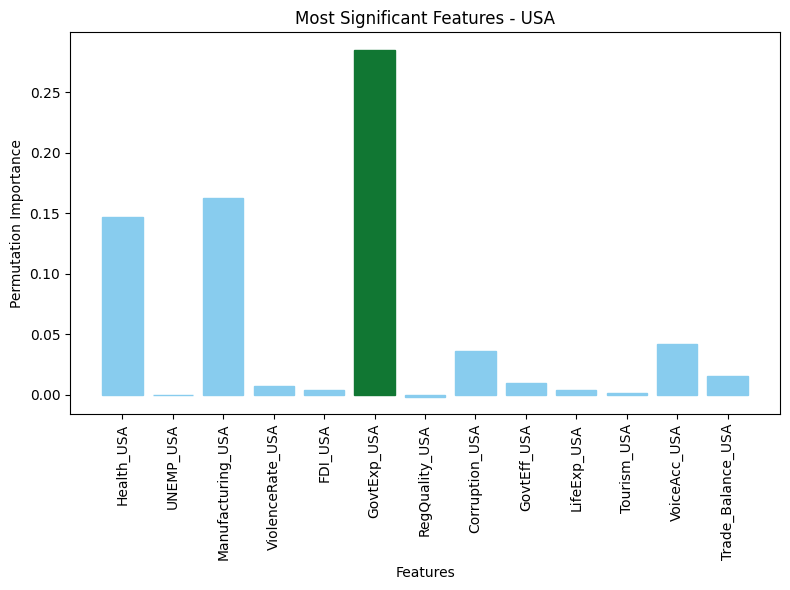

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mlxtend.evaluate import feature_importance_permutation
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor

# Assuming you have df_USA with features and target variable
# X should contain the features, and y should contain the target variable

# Splitting the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(
    df_USA.drop(columns=['GDP_USA']),  # Exclude the target variable
    df_USA['GDP_USA'], 
    test_size=0.2, 
    random_state=123
)    

# Instantiate the RandomForestRegressor model
rf_regressor = RandomForestRegressor(n_estimators=100, random_state=123)

# Fit the RandomForestRegressor model
rf_regressor.fit(X_train, y_train)

# Calculate feature importance using permutation
imp_vals, _ = feature_importance_permutation(
    predict_method=rf_regressor.predict, 
    X=X_test.values,  # Convert DataFrame to numpy array
    y=y_test.values,  # Convert Series to numpy array
    metric='r2',       # Use the appropriate metric for regression
    num_rounds=5,
    seed=1
)

# Plot the feature importance
plt.figure(figsize=(8, 6))
bars = plt.bar(range(X_test.shape[1]), imp_vals)
plt.xticks(range(X_test.shape[1]), X_test.columns, rotation=90)
plt.xlabel('Features')
plt.ylabel('Permutation Importance')
plt.title('Most Significant Features - USA')

# Set colors for bars
most_important_index = np.argmax(imp_vals)
for idx, bar in enumerate(bars):
    if idx == most_important_index:
        bar.set_color('#117733')  # Paul Tol's R051 Green
    else:
        bar.set_color('#88CCEE')  # Paul Tol's R148 Light blue

plt.tight_layout()
plt.show()


/shared-libs/python3.9/py/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/shared-libs/python3.9/py/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/shared-libs/python3.9/py/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/shared-libs/python3.9/py/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/shared-libs/python3.9/py/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/shared-li

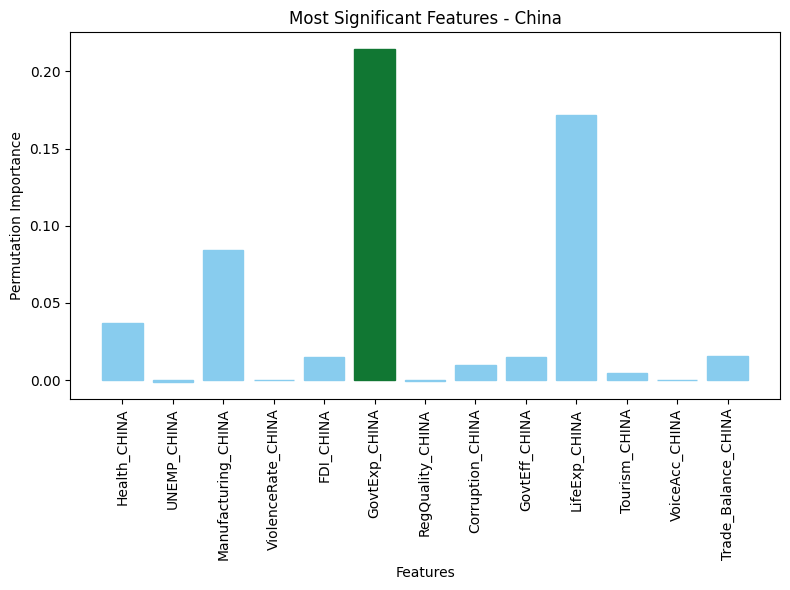

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mlxtend.evaluate import feature_importance_permutation
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor

# Assuming you have df_USA with features and target variable
# X should contain the features, and y should contain the target variable

# Splitting the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(
    df_China.drop(columns=['GDP_CHINA']),  # Exclude the target variable
    df_China['GDP_CHINA'], 
    test_size=0.2, 
    random_state=123
)    

# Instantiate the RandomForestRegressor model
rf_regressor = RandomForestRegressor(n_estimators=100, random_state=123)

# Fit the RandomForestRegressor model
rf_regressor.fit(X_train, y_train)

# Calculate feature importance using permutation
imp_vals, _ = feature_importance_permutation(
    predict_method=rf_regressor.predict, 
    X=X_test.values,  # Convert DataFrame to numpy array
    y=y_test.values,  # Convert Series to numpy array
    metric='r2',       # Use the appropriate metric for regression
    num_rounds=10,
    seed=1
)

# Plot the feature importance
plt.figure(figsize=(8, 6))
bars = plt.bar(range(X_test.shape[1]), imp_vals)
plt.xticks(range(X_test.shape[1]), X_test.columns, rotation=90)
plt.xlabel('Features')
plt.ylabel('Permutation Importance')
plt.title('Most Significant Features - China')

# Set colors for bars
most_important_index = np.argmax(imp_vals)
for idx, bar in enumerate(bars):
    if idx == most_important_index:
        bar.set_color('#117733')  # Paul Tol's R051 Green
    else:
        bar.set_color('#88CCEE')  # Paul Tol's R148 Light blue

plt.tight_layout()
plt.show()


/shared-libs/python3.9/py/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/shared-libs/python3.9/py/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/shared-libs/python3.9/py/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/shared-libs/python3.9/py/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/shared-libs/python3.9/py/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/shared-li

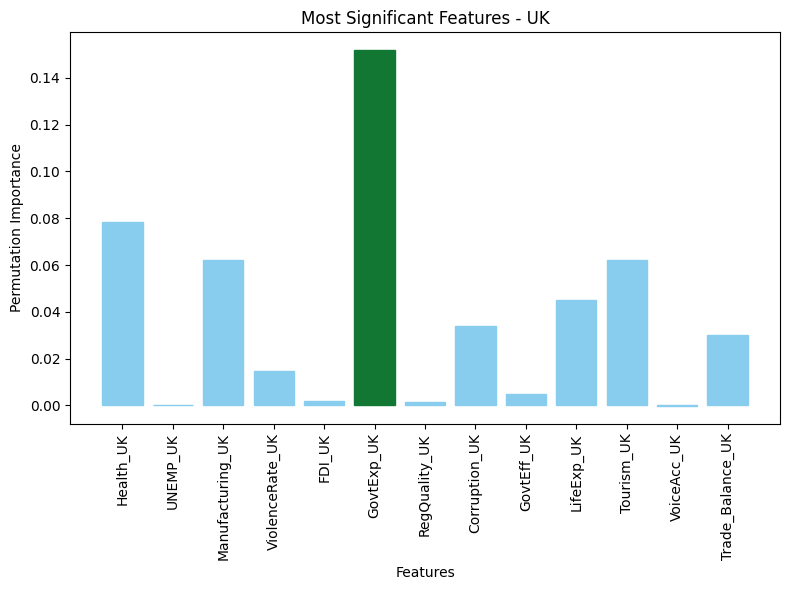

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mlxtend.evaluate import feature_importance_permutation
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor

# Assuming you have df_USA with features and target variable
# X should contain the features, and y should contain the target variable

# Splitting the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(
    df_UK.drop(columns=['GDP_UK']),  # Exclude the target variable
    df_UK['GDP_UK'], 
    test_size=0.2, 
    random_state=123
)    

# Instantiate the RandomForestRegressor model
rf_regressor = RandomForestRegressor(n_estimators=100, random_state=123)

# Fit the RandomForestRegressor model
rf_regressor.fit(X_train, y_train)

# Calculate feature importance using permutation
imp_vals, _ = feature_importance_permutation(
    predict_method=rf_regressor.predict, 
    X=X_test.values,  # Convert DataFrame to numpy array
    y=y_test.values,  # Convert Series to numpy array
    metric='r2',       # Use the appropriate metric for regression
    num_rounds=5,
    seed=1
)

# Plot the feature importance
plt.figure(figsize=(8, 6))
bars = plt.bar(range(X_test.shape[1]), imp_vals)
plt.xticks(range(X_test.shape[1]), X_test.columns, rotation=90)
plt.xlabel('Features')
plt.ylabel('Permutation Importance')
plt.title('Most Significant Features - UK')

# Set colors for bars
most_important_index = np.argmax(imp_vals)
for idx, bar in enumerate(bars):
    if idx == most_important_index:
        bar.set_color('#117733')  # Paul Tol's R051 Green
    else:
        bar.set_color('#88CCEE')  # Paul Tol's R148 Light blue

plt.tight_layout()
plt.show()


/shared-libs/python3.9/py/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/shared-libs/python3.9/py/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/shared-libs/python3.9/py/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/shared-libs/python3.9/py/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/shared-libs/python3.9/py/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/shared-li

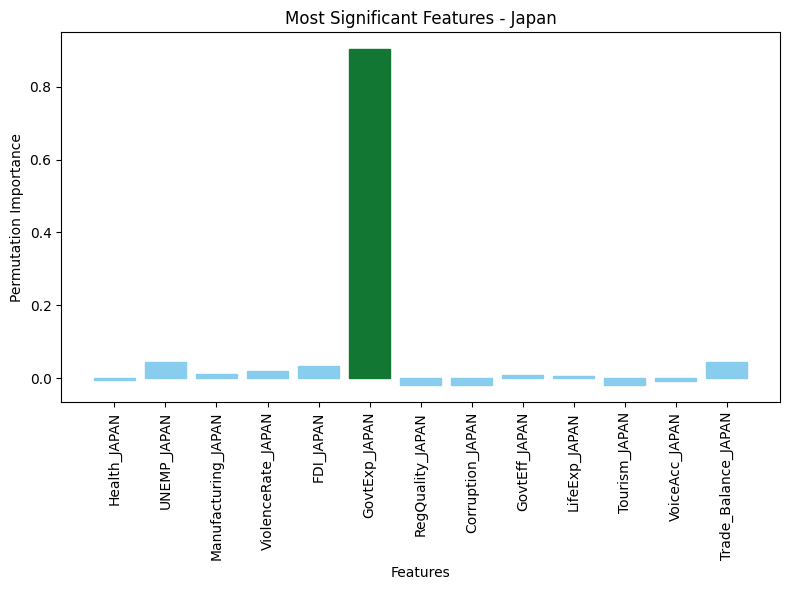

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mlxtend.evaluate import feature_importance_permutation
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor

# Assuming you have df_USA with features and target variable
# X should contain the features, and y should contain the target variable

# Splitting the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(
    df_Japan.drop(columns=['GDP_JAPAN']),  # Exclude the target variable
    df_Japan['GDP_JAPAN'], 
    test_size=0.2, 
    random_state=123
)    

# Instantiate the RandomForestRegressor model
rf_regressor = RandomForestRegressor(n_estimators=100, random_state=123)

# Fit the RandomForestRegressor model
rf_regressor.fit(X_train, y_train)

# Calculate feature importance using permutation
imp_vals, _ = feature_importance_permutation(
    predict_method=rf_regressor.predict, 
    X=X_test.values,  # Convert DataFrame to numpy array
    y=y_test.values,  # Convert Series to numpy array
    metric='r2',       # Use the appropriate metric for regression
    num_rounds=5,
    seed=1
)

# Plot the feature importance
plt.figure(figsize=(8, 6))
bars = plt.bar(range(X_test.shape[1]), imp_vals)
plt.xticks(range(X_test.shape[1]), X_test.columns, rotation=90)
plt.xlabel('Features')
plt.ylabel('Permutation Importance')
plt.title('Most Significant Features - Japan')

# Set colors for bars
most_important_index = np.argmax(imp_vals)
for idx, bar in enumerate(bars):
    if idx == most_important_index:
        bar.set_color('#117733')  # Paul Tol's R051 Green
    else:
        bar.set_color('#88CCEE')  # Paul Tol's R148 Light blue

plt.tight_layout()
plt.show()


In [ ]:
df_Japan


,Health_JAPAN,UNEMP_JAPAN,Manufacturing_JAPAN,ViolenceRate_JAPAN,FDI_JAPAN,GovtExp_JAPAN,RegQuality_JAPAN,Corruption_JAPAN,GovtEff_JAPAN,LifeExp_JAPAN,Tourism_JAPAN,VoiceAcc_JAPAN,Trade_Balance_JAPAN,GDP_JAPAN
Year,,,,,,,,,,,,,,
1994,6.463,2.890953,23.469215,1.168657,8.883845e+08,7.372383e+11,0.720652,1.165569,0.855717,79.800000,3326.962963,1.077227,120728.4,5005497.0
1995,6.173,3.153574,23.471766,1.165274,4.146307e+07,8.362559e+11,0.746300,1.178940,0.883004,79.600000,3345.000000,1.075078,105641.3,5568133.0
1996,6.012,3.350839,23.361156,1.161890,-3.820360e+07,7.456938e+11,0.771947,1.192312,0.910291,80.300000,3837.000000,1.072930,61348.2,4924946.0
1997,6.289,3.403121,23.350487,1.158506,2.486935e+09,6.874319e+11,0.797594,1.205683,0.937578,80.500000,4218.000000,1.070781,94958.3,4494175.0
1998,6.509,4.114412,22.836644,1.247675,2.512022e+09,6.420252e+11,0.554549,1.065931,1.016817,80.600000,4106.000000,0.946786,110356.0,4119003.0
1999,6.865,4.683277,22.401864,1.151738,1.478051e+10,7.518067e+11,0.848888,1.232426,0.992151,80.500000,4438.000000,1.066484,109209.6,4660601.0
2000,7.035,4.714846,22.452209,1.197553,1.068817e+10,8.222233e+11,0.797354,1.229919,1.141836,81.200000,4757.000000,0.958088,101538.5,4969890.0
2001,7.239,5.039315,21.119717,1.144971,4.926034e+09,7.537187e+11,0.900182,1.259170,1.046725,81.500000,4772.000000,1.062187,52930.0,4379903.0
2002,7.352,5.373721,20.714702,1.176023,1.155737e+10,7.434970e+11,0.495340,0.936940,1.016848,81.800000,5239.000000,1.014471,79245.0,4194996.0


In [ ]:
df_USA


,Health_USA,UNEMP_USA,Manufacturing_USA,ViolenceRate_USA,FDI_USA,GovtExp_USA,RegQuality_USA,Corruption_USA,GovtEff_USA,LifeExp_USA,Tourism_USA,VoiceAcc_USA,Trade_Balance_USA,GDP_USA
Year,,,,,,,,,,,,,,
1994,12.388,6.100000,16.759278,1.009699,5.594000e+10,1.108101e+12,1.606076,1.606948,1.545607,75.700000,80237.307692,1.387395,-150075.6,7287200.0
1995,12.497,5.591667,16.535245,0.972352,6.908000e+10,1.141743e+12,1.599589,1.588994,1.535264,75.800000,79732.000000,1.368028,-158750.5,7639900.0
1996,12.467,5.408333,16.311211,0.935006,9.766000e+10,1.172889e+12,1.593102,1.571041,1.524920,76.100000,82756.000000,1.348661,-170371.4,8073200.0
1997,12.373,4.941667,16.087177,0.897659,1.221500e+11,1.220528e+12,1.586615,1.553088,1.514577,76.500000,82525.000000,1.329294,-180233.2,8577600.0
1998,12.357,4.500000,15.774325,0.879613,2.111500e+11,1.267607e+12,1.610037,1.549399,1.698527,76.700000,74767.000000,1.336877,-229280.8,9062800.0
1999,12.343,4.216667,15.459067,0.822966,3.124490e+11,1.351427e+12,1.573641,1.517182,1.493890,76.700000,75796.000000,1.290560,-327612.0,9631300.0
2000,12.490,3.966667,15.115075,1.082809,3.491250e+11,1.437588e+12,1.696121,1.603597,1.724887,76.800000,78343.000000,1.310167,-434875.0,10251000.0
2001,13.168,4.741667,13.919309,0.748273,1.724960e+11,1.538151e+12,1.560667,1.481275,1.473204,77.000000,70975.000000,1.251826,-413031.0,10582000.0
2002,13.995,5.783333,13.452878,0.285477,1.110550e+11,1.645819e+12,1.551741,1.873597,1.620928,77.000000,64434.000000,1.344568,-467393.0,10929200.0


# PFFRA Analysis


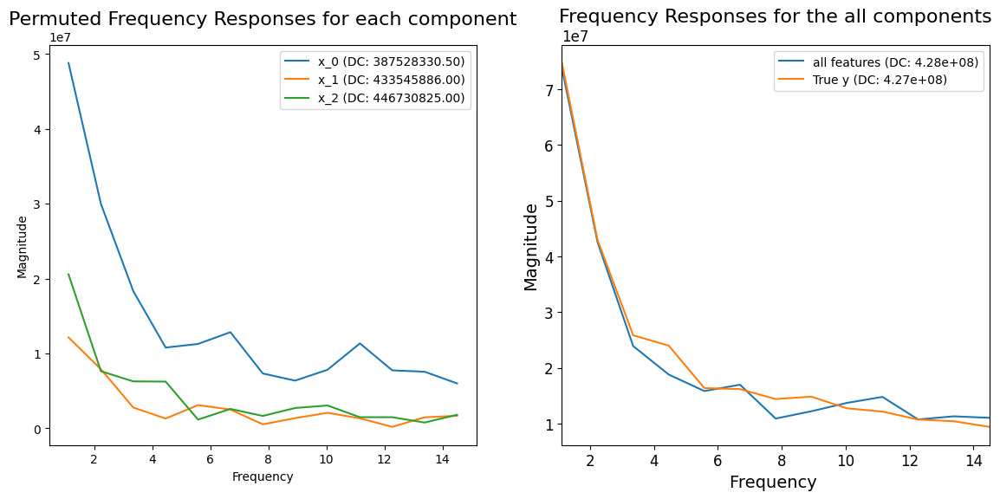

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split
from PFFRA import PermFeatureFreqRespoAnalysis  # Assuming you have the PFFRA module

# Assuming df_USA contains the features and target variable
# X should contain the features, and y should contain the target variable

# Selecting the features of interest
selected_features = [ 'Manufacturing_USA', 'Health_USA', 'GovtExp_USA']  # Include GDP_USA as the target variable
X_selected = df_USA[selected_features]
y = df_USA['GDP_USA']  # Target variable is GDP_USA

# Splitting the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X_selected, y, test_size=0.2, random_state=42)

# Train an XGBoost model
model = XGBRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Instantiate PFFRA for investigating frequency response
fig = plt.figure(figsize=(14, 6))
ax1 = fig.add_subplot(121)

# Investigate multiple features and output their permutation spectrum data
for i in range(X_selected.shape[1]):
    # Instantiate PFFRA for the current feature
    pffra = PermFeatureFreqRespoAnalysis(y=y, X=X_selected, model=model, interested_feature_index=i)
    
    # Generate permutation dataset
    X_interested_feature, X_other_feature = pffra.permuted_dataset(mode='mean')
    
    # Predict target variables using the permutated datasets
    pred_interested_feature, pred_other_feature, pred_all_feature = pffra.permu_pred(X_interested_feature, X_other_feature)
    
    # Calculate the sampling frequency of your time series data
    sampling_frequency = len(y)  # Assuming each data point corresponds to 1 unit of time

    # Calculate the Nyquist frequency (half of the sampling frequency)
    nyquist_frequency = sampling_frequency / 2

    # Define the frequency range based on the Nyquist frequency
    frequency_range = np.linspace(0, nyquist_frequency, num=len(y) // 2)
    
    # Generate spectrums for analysis with the appropriate sample_rate
    spectrums = pffra.gen_spectrum(pred_interested_feature=pred_interested_feature, 
                                    pred_other_feature=pred_other_feature, 
                                    pred_all_feature=pred_all_feature, 
                                    sample_rate=sampling_frequency)
    
    # Unpack spectrums
    spectrum_interested_i = spectrums[0]
    spectrum_all = spectrums[2]
    spectrum_true = spectrums[3]
    frq_range = spectrums[4]
    
    # Plot permuted frequency responses for each component
    plt.rcParams["axes.labelsize"] = 14
    plt.rcParams["axes.titlesize"] = 16  
    plt.rcParams["xtick.labelsize"] = "large"
    plt.rcParams["ytick.labelsize"] = "large"
    
    ax1.plot(frq_range[1:], spectrum_interested_i[1:], 
             label="x_{} (DC: {:.2f})".format(i, spectrum_interested_i[0]))
    ax1.legend()
    ax1.set_xlabel("Frequency")
    ax1.set_ylabel("Magnitude")
    ax1.set_title("Permuted Frequency Responses for each component")

ax2 = fig.add_subplot(122)
ax2.plot(frq_range[1:], spectrum_all[1:], 
         label="{} (DC: {:.2e})".format("all features", spectrum_all[0]))
ax2.plot(frq_range[1:], spectrum_true[1:], 
         label="{} (DC: {:.2e})".format("True y", spectrum_true[0]))
ax2.legend()
ax2.set_xlim(frq_range[1], frq_range[-1])
ax2.set_xlabel("Frequency ")
ax2.set_ylabel("Magnitude")
ax2.set_title("Frequency Responses for the all components")
plt.show()


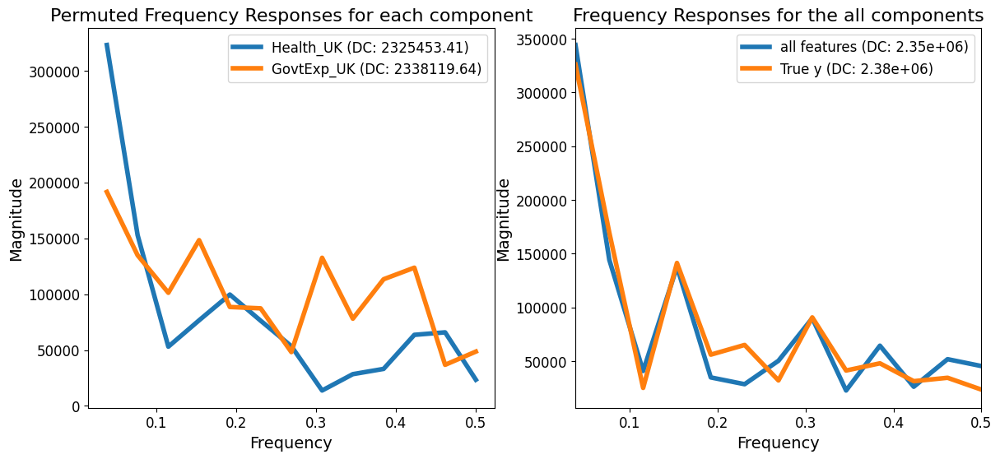

(array([2338119.64224138,  191565.35359771,  134884.01409767,
        101272.77687247,  148399.43864503,   88550.14816154,
         87345.49741906,   48167.40934027,  132606.86610026,
         78085.51380233,  113384.38204392,  123741.71174511,
         36770.84420486,   48620.80831764]), array([2302093.40086207,  332095.94921797,  118072.70710129,
         24441.64549562,   91234.84070908,   45161.29383589,
         24547.39679622,   60308.04566503,   55054.67465391,
         13621.00771422,   75998.87680493,   39551.38071464,
         35097.61774016,   73846.1093941 ]), array([2350522.70258621,  344159.35783499,  144266.22075713,
         40803.22713949,  137799.64318417,   34841.76224265,
         28525.81749108,   50330.70888574,   89919.07491802,
         22672.13737706,   64362.92275612,   26159.43588079,
         51816.47833967,   45413.14033659]), array([2377108.79310345,  326048.66288019,  169545.75913829,
         25081.13203951,  141371.58840766,   56030.52553303,
         6

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler  # Import the StandardScaler
from PFFRA import PermFeatureFreqRespoAnalysis  # Assuming you have the PFFRA module

# Assuming df_UK contains the features and target variable
# X should contain the features, and y should contain the target variable

# Selecting the features of interest
selected_features = ['Health_UK', 'GovtExp_UK'] 

X_selected = df_UK[selected_features]
y = df_UK['GDP_UK']  # Target variable is GDP_USA

# Splitting the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X_selected, y, test_size=0.2, random_state=42)

# Train an XGBoost model
model = XGBRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Instantiate PFFRA for investigating frequency response
fig = plt.figure(figsize=(14, 6))
ax1 = fig.add_subplot(121)

# Investigate multiple features and output their permutation spectrum data
for i in range(X_selected.shape[1]):
    # Instantiate PFFRA for the current feature
    pffra = PermFeatureFreqRespoAnalysis(y=y, X=X_selected, model=model, interested_feature_index=i)
    
    # Generate permutation dataset
    X_interested_feature, X_other_feature = pffra.permuted_dataset(mode='shuffle')
    
    # Predict target variables using the permutated datasets
    pred_interested_feature, pred_other_feature, pred_all_feature = pffra.permu_pred(X_interested_feature, X_other_feature)
    
    sampling_frequency = 1  # Assuming each data point corresponds to 1 unit of time

    # Calculate the Nyquist frequency (half of the sampling frequency)
    nyquist_frequency = sampling_frequency / 2

    # Define the frequency range based on the Nyquist frequency
    frequency_range = np.linspace(0, nyquist_frequency, num=len(y) // 2)
    
    # Generate spectrums for analysis with the appropriate sample_rate
    spectrums = pffra.gen_spectrum(pred_interested_feature=pred_interested_feature, 
                                    pred_other_feature=pred_other_feature, 
                                    pred_all_feature=pred_all_feature, 
                                    sample_rate=sampling_frequency)
    
    # Unpack spectrums
    spectrum_interested_i = spectrums[0]
    spectrum_all = spectrums[2]
    spectrum_true = spectrums[3]
    frq_range = spectrums[4]
    
    # Plot permuted frequency responses for each component
    plt.rcParams["axes.labelsize"] = 14
    plt.rcParams["axes.titlesize"] = 16  
    plt.rcParams["xtick.labelsize"] = "large"
    plt.rcParams["ytick.labelsize"] = "large"
    
    ax1.plot(frq_range[1:], spectrum_interested_i[1:], 
             label="{} (DC: {:.2f})".format(selected_features[i], spectrum_interested_i[0]), linewidth = 4)
    ax1.legend(fontsize='large')
    ax1.set_xlabel("Frequency")
    ax1.set_ylabel("Magnitude")
    ax1.set_title("Permuted Frequency Responses for each component")

ax2 = fig.add_subplot(122)
ax2.plot(frq_range[1:], spectrum_all[1:], 
         label="{} (DC: {:.2e})".format("all features", spectrum_all[0]), linewidth=4)
ax2.plot(frq_range[1:], spectrum_true[1:], 
         label="{} (DC: {:.2e})".format("True y", spectrum_true[0]), linewidth=4)
ax2.legend(fontsize='large')
ax2.set_xlim(frq_range[1], frq_range[-1])
ax2.set_xlabel("Frequency")
ax2.set_ylabel("Magnitude")
ax2.set_title("Frequency Responses for the all components")
plt.show()

print(spectrums)
print(spectrums[0])
print(spectrum_interested_i[0])


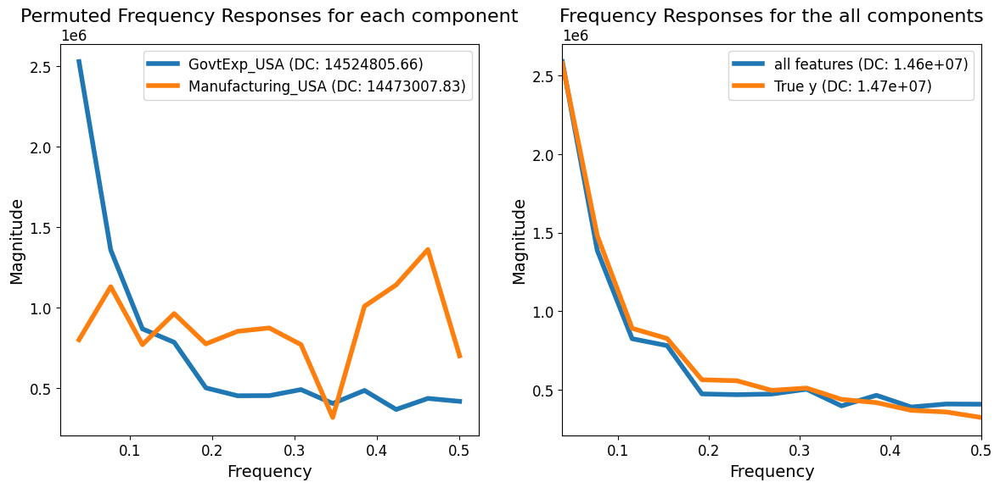

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler  # Import the StandardScaler
from PFFRA import PermFeatureFreqRespoAnalysis  # Assuming you have the PFFRA module

# Assuming df_UK contains the features and target variable
# X should contain the features, and y should contain the target variable

# Selecting the features of interest
selected_features = ['GovtExp_USA', 'Manufacturing_USA'] 

X_selected = df_USA[selected_features]
y = df_USA['GDP_USA']  # Target variable is GDP_USA

# Splitting the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X_selected, y, test_size=0.2, random_state=42)

# Train an XGBoost model
model = XGBRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Instantiate PFFRA for investigating frequency response
fig = plt.figure(figsize=(14, 6))
ax1 = fig.add_subplot(121)

# Investigate multiple features and output their permutation spectrum data
for i in range(X_selected.shape[1]):
    # Instantiate PFFRA for the current feature
    pffra = PermFeatureFreqRespoAnalysis(y=y, X=X_selected, model=model, interested_feature_index=i)
    
    # Generate permutation dataset
    X_interested_feature, X_other_feature = pffra.permuted_dataset(mode='shuffle')
    
    # Predict target variables using the permutated datasets
    pred_interested_feature, pred_other_feature, pred_all_feature = pffra.permu_pred(X_interested_feature, X_other_feature)
    
    sampling_frequency = 1  # Assuming each data point corresponds to 1 unit of time

    # Calculate the Nyquist frequency (half of the sampling frequency)
    nyquist_frequency = sampling_frequency / 2

    # Define the frequency range based on the Nyquist frequency
    frequency_range = np.linspace(0, nyquist_frequency, num=len(y) // 2)
    
    # Generate spectrums for analysis with the appropriate sample_rate
    spectrums = pffra.gen_spectrum(pred_interested_feature=pred_interested_feature, 
                                    pred_other_feature=pred_other_feature, 
                                    pred_all_feature=pred_all_feature, 
                                    sample_rate=sampling_frequency)
    
    # Unpack spectrums
    spectrum_interested_i = spectrums[0]
    spectrum_all = spectrums[2]
    spectrum_true = spectrums[3]
    frq_range = spectrums[4]
    
    # Plot permuted frequency responses for each component
    plt.rcParams["axes.labelsize"] = 14
    plt.rcParams["axes.titlesize"] = 16  
    plt.rcParams["xtick.labelsize"] = "large"
    plt.rcParams["ytick.labelsize"] = "large"
    
    ax1.plot(frq_range[1:], spectrum_interested_i[1:], 
             label="{} (DC: {:.2f})".format(selected_features[i], spectrum_interested_i[0]), linewidth = 4)
    ax1.legend(fontsize='large')
    ax1.set_xlabel("Frequency")
    ax1.set_ylabel("Magnitude")
    ax1.set_title("Permuted Frequency Responses for each component")

ax2 = fig.add_subplot(122)
ax2.plot(frq_range[1:], spectrum_all[1:], 
         label="{} (DC: {:.2e})".format("all features", spectrum_all[0]), linewidth=4)
ax2.plot(frq_range[1:], spectrum_true[1:], 
         label="{} (DC: {:.2e})".format("True y", spectrum_true[0]), linewidth=4)
ax2.legend(fontsize='large')
ax2.set_xlim(frq_range[1], frq_range[-1])
ax2.set_xlabel("Frequency")
ax2.set_ylabel("Magnitude")
ax2.set_title("Frequency Responses for the all components")
plt.show()


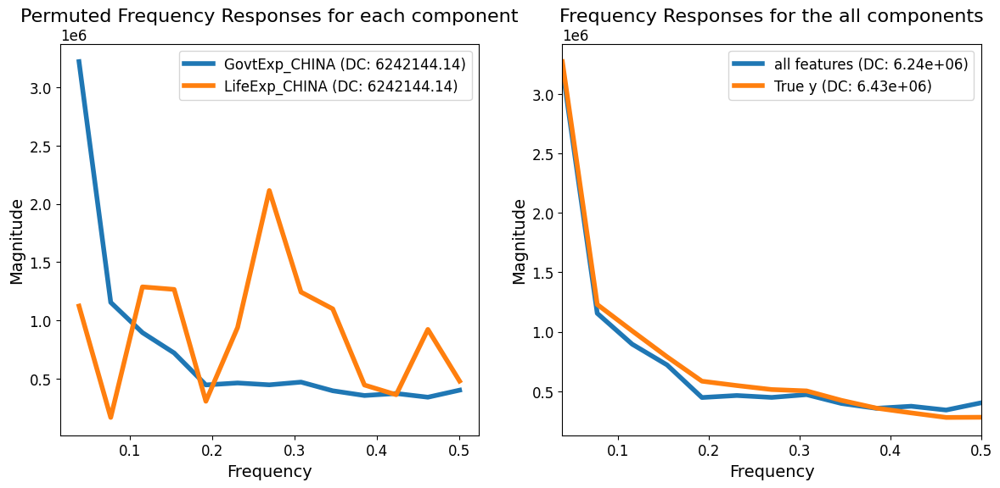

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler  # Import the StandardScaler
from PFFRA import PermFeatureFreqRespoAnalysis  # Assuming you have the PFFRA module

# Assuming df_UK contains the features and target variable
# X should contain the features, and y should contain the target variable

# Selecting the features of interest
selected_features = ['GovtExp_CHINA','LifeExp_CHINA'] 

X_selected = df_China[selected_features]
y = df_China['GDP_CHINA']  # Target variable is GDP_USA

# Splitting the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X_selected, y, test_size=0.2, random_state=42)

# Train an XGBoost model
model = XGBRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Instantiate PFFRA for investigating frequency response
fig = plt.figure(figsize=(14, 6))
ax1 = fig.add_subplot(121)

# Investigate multiple features and output their permutation spectrum data
for i in range(X_selected.shape[1]):
    # Instantiate PFFRA for the current feature
    pffra = PermFeatureFreqRespoAnalysis(y=y, X=X_selected, model=model, interested_feature_index=i)
    
    # Generate permutation dataset
    X_interested_feature, X_other_feature = pffra.permuted_dataset(mode='shuffle')
    
    # Predict target variables using the permutated datasets
    pred_interested_feature, pred_other_feature, pred_all_feature = pffra.permu_pred(X_interested_feature, X_other_feature)
    
    sampling_frequency = 1  # Assuming each data point corresponds to 1 unit of time

    # Calculate the Nyquist frequency (half of the sampling frequency)
    nyquist_frequency = sampling_frequency / 2

    # Define the frequency range based on the Nyquist frequency
    frequency_range = np.linspace(0, nyquist_frequency, num=len(y) // 2)
    
    # Generate spectrums for analysis with the appropriate sample_rate
    spectrums = pffra.gen_spectrum(pred_interested_feature=pred_interested_feature, 
                                    pred_other_feature=pred_other_feature, 
                                    pred_all_feature=pred_all_feature, 
                                    sample_rate=sampling_frequency)
    
    # Unpack spectrums
    spectrum_interested_i = spectrums[0]
    spectrum_all = spectrums[2]
    spectrum_true = spectrums[3]
    frq_range = spectrums[4]
    
    # Plot permuted frequency responses for each component
    plt.rcParams["axes.labelsize"] = 14
    plt.rcParams["axes.titlesize"] = 16  
    plt.rcParams["xtick.labelsize"] = "large"
    plt.rcParams["ytick.labelsize"] = "large"
    
    ax1.plot(frq_range[1:], spectrum_interested_i[1:], 
             label="{} (DC: {:.2f})".format(selected_features[i], spectrum_interested_i[0]), linewidth = 4)
    ax1.legend(fontsize='large')
    ax1.set_xlabel("Frequency")
    ax1.set_ylabel("Magnitude")
    ax1.set_title("Permuted Frequency Responses for each component")

ax2 = fig.add_subplot(122)
ax2.plot(frq_range[1:], spectrum_all[1:], 
         label="{} (DC: {:.2e})".format("all features", spectrum_all[0]), linewidth=4)
ax2.plot(frq_range[1:], spectrum_true[1:], 
         label="{} (DC: {:.2e})".format("True y", spectrum_true[0]), linewidth=4)
ax2.legend(fontsize='large')
ax2.set_xlim(frq_range[1], frq_range[-1])
ax2.set_xlabel("Frequency")
ax2.set_ylabel("Magnitude")
ax2.set_title("Frequency Responses for the all components")
plt.show()


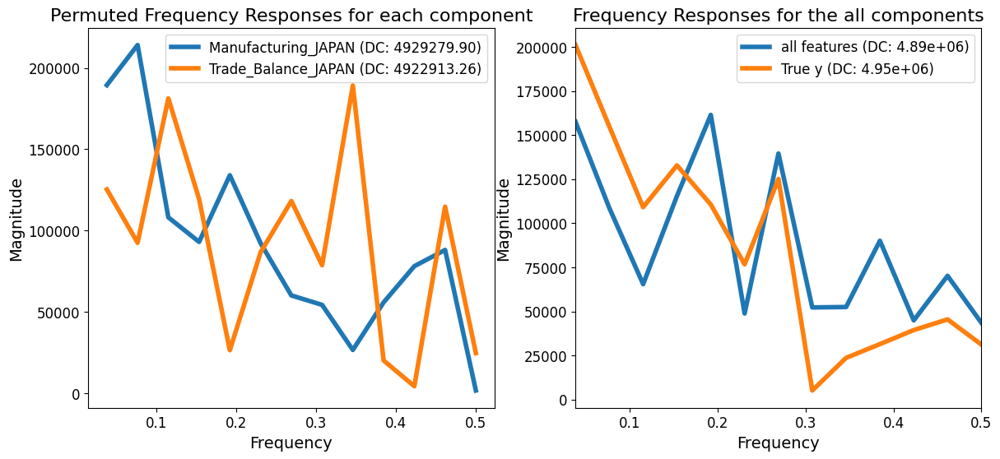

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler  # Import the StandardScaler
from PFFRA import PermFeatureFreqRespoAnalysis  # Assuming you have the PFFRA module

# Assuming df_UK contains the features and target variable
# X should contain the features, and y should contain the target variable

# Selecting the features of interest
selected_features = ['Manufacturing_JAPAN', 'Trade_Balance_JAPAN'] 

X_selected = df_Japan[selected_features]
y = df_Japan['GDP_JAPAN']  # Target variable is GDP_USA

# Splitting the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X_selected, y, test_size=0.2, random_state=42)

# Train an XGBoost model
model = XGBRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Instantiate PFFRA for investigating frequency response
fig = plt.figure(figsize=(14, 6))
ax1 = fig.add_subplot(121)

# Investigate multiple features and output their permutation spectrum data
for i in range(X_selected.shape[1]):
    # Instantiate PFFRA for the current feature
    pffra = PermFeatureFreqRespoAnalysis(y=y, X=X_selected, model=model, interested_feature_index=i)
    
    # Generate permutation dataset
    X_interested_feature, X_other_feature = pffra.permuted_dataset(mode='shuffle')
    # Predict target variables using the permutated datasets
    pred_interested_feature, pred_other_feature, pred_all_feature = pffra.permu_pred(X_interested_feature, X_other_feature)
    
    sampling_frequency = 1  # Assuming each data point corresponds to 1 unit of time

    # Calculate the Nyquist frequency (half of the sampling frequency)
    nyquist_frequency = sampling_frequency / 2

    # Define the frequency range based on the Nyquist frequency
    frequency_range = np.linspace(0, nyquist_frequency, num=len(y) // 2)
    
    # Generate spectrums for analysis with the appropriate sample_rate
    spectrums = pffra.gen_spectrum(pred_interested_feature=pred_interested_feature, 
                                    pred_other_feature=pred_other_feature, 
                                    pred_all_feature=pred_all_feature, 
                                    sample_rate=sampling_frequency)
    
    # Unpack spectrums
    spectrum_interested_i = spectrums[0]
    spectrum_all = spectrums[2]
    spectrum_true = spectrums[3]
    frq_range = spectrums[4]
    
    # Plot permuted frequency responses for each component
    plt.rcParams["axes.labelsize"] = 14
    plt.rcParams["axes.titlesize"] = 16  
    plt.rcParams["xtick.labelsize"] = "large"
    plt.rcParams["ytick.labelsize"] = "large"
    
    ax1.plot(frq_range[1:], spectrum_interested_i[1:], 
             label="{} (DC: {:.2f})".format(selected_features[i], spectrum_interested_i[0]), linewidth = 4)
    ax1.legend(fontsize='large')
    ax1.set_xlabel("Frequency")
    ax1.set_ylabel("Magnitude")
    ax1.set_title("Permuted Frequency Responses for each component")

ax2 = fig.add_subplot(122)
ax2.plot(frq_range[1:], spectrum_all[1:], 
         label="{} (DC: {:.2e})".format("all features", spectrum_all[0]), linewidth=4)
ax2.plot(frq_range[1:], spectrum_true[1:], 
         label="{} (DC: {:.2e})".format("True y", spectrum_true[0]), linewidth=4)
ax2.legend(fontsize='large')
ax2.set_xlim(frq_range[1], frq_range[-1])
ax2.set_xlabel("Frequency")
ax2.set_ylabel("Magnitude")
ax2.set_title("Frequency Responses for the all components")
plt.show()


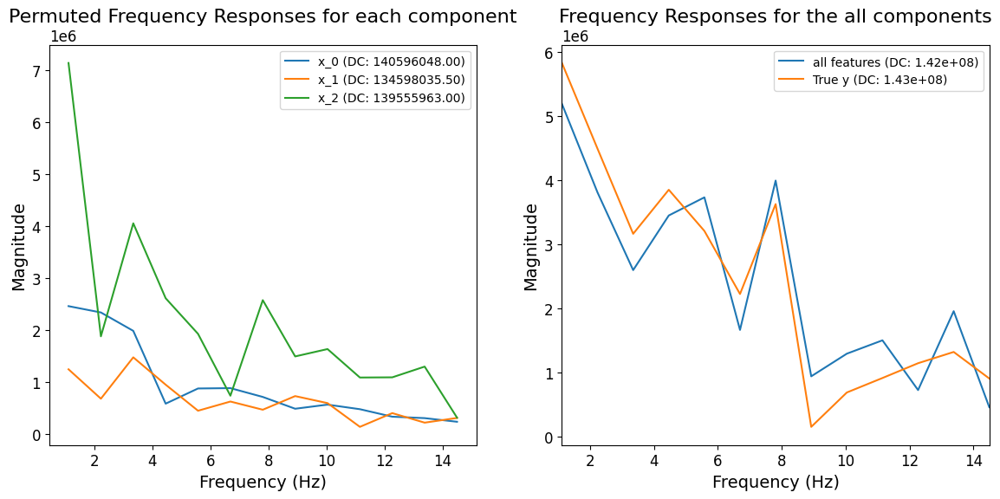

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split
from PFFRA import PermFeatureFreqRespoAnalysis  # Assuming you have the PFFRA module

# Assuming df_USA contains the features and target variable
# X should contain the features, and y should contain the target variable

# Selecting the features of interest
selected_features = [ 'Manufacturing_JAPAN', 'Trade_Balance_JAPAN', 'GovtExp_JAPAN']  # Include GDP_USA as the target variable
X_selected = df_Japan[selected_features]
y = df_Japan['GDP_JAPAN']  # Target variable is GDP_USA

# Splitting the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X_selected, y, test_size=0.2, random_state=42)

# Train an XGBoost model
model = XGBRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Instantiate PFFRA for investigating frequency response
fig = plt.figure(figsize=(14, 6))
ax1 = fig.add_subplot(121)

# Investigate multiple features and output their permutation spectrum data
for i in range(X_selected.shape[1]):
    # Instantiate PFFRA for the current feature
    pffra = PermFeatureFreqRespoAnalysis(y=y, X=X_selected, model=model, interested_feature_index=i)
    
    # Generate permutation dataset
    X_interested_feature, X_other_feature = pffra.permuted_dataset(mode='mean')
    
    # Predict target variables using the permutated datasets
    pred_interested_feature, pred_other_feature, pred_all_feature = pffra.permu_pred(X_interested_feature, X_other_feature)
    
    # Calculate the sampling frequency of your time series data
    sampling_frequency = len(y)  # Assuming each data point corresponds to 1 unit of time

    # Calculate the Nyquist frequency (half of the sampling frequency)
    nyquist_frequency = sampling_frequency / 2

    # Define the frequency range based on the Nyquist frequency
    frequency_range = np.linspace(0, nyquist_frequency, num=len(y) // 2)
    
    # Generate spectrums for analysis with the appropriate sample_rate
    spectrums = pffra.gen_spectrum(pred_interested_feature=pred_interested_feature, 
                                    pred_other_feature=pred_other_feature, 
                                    pred_all_feature=pred_all_feature, 
                                    sample_rate=sampling_frequency)
    
    # Unpack spectrums
    spectrum_interested_i = spectrums[0]
    spectrum_all = spectrums[2]
    spectrum_true = spectrums[3]
    frq_range = spectrums[4]
    
    # Plot permuted frequency responses for each component
    plt.rcParams["axes.labelsize"] = 14
    plt.rcParams["axes.titlesize"] = 16  
    plt.rcParams["xtick.labelsize"] = "large"
    plt.rcParams["ytick.labelsize"] = "large"
    
    ax1.plot(frq_range[1:], spectrum_interested_i[1:], 
             label="x_{} (DC: {:.2f})".format(i, spectrum_interested_i[0]))
    ax1.legend()
    ax1.set_xlabel("Frequency (Hz)")
    ax1.set_ylabel("Magnitude")
    ax1.set_title("Permuted Frequency Responses for each component")

ax2 = fig.add_subplot(122)
ax2.plot(frq_range[1:], spectrum_all[1:], 
         label="{} (DC: {:.2e})".format("all features", spectrum_all[0]))
ax2.plot(frq_range[1:], spectrum_true[1:], 
         label="{} (DC: {:.2e})".format("True y", spectrum_true[0]))
ax2.legend()
ax2.set_xlim(frq_range[1], frq_range[-1])
ax2.set_xlabel("Frequency (Hz)")
ax2.set_ylabel("Magnitude")
ax2.set_title("Frequency Responses for the all components")
plt.show()


# Results - Visualisation


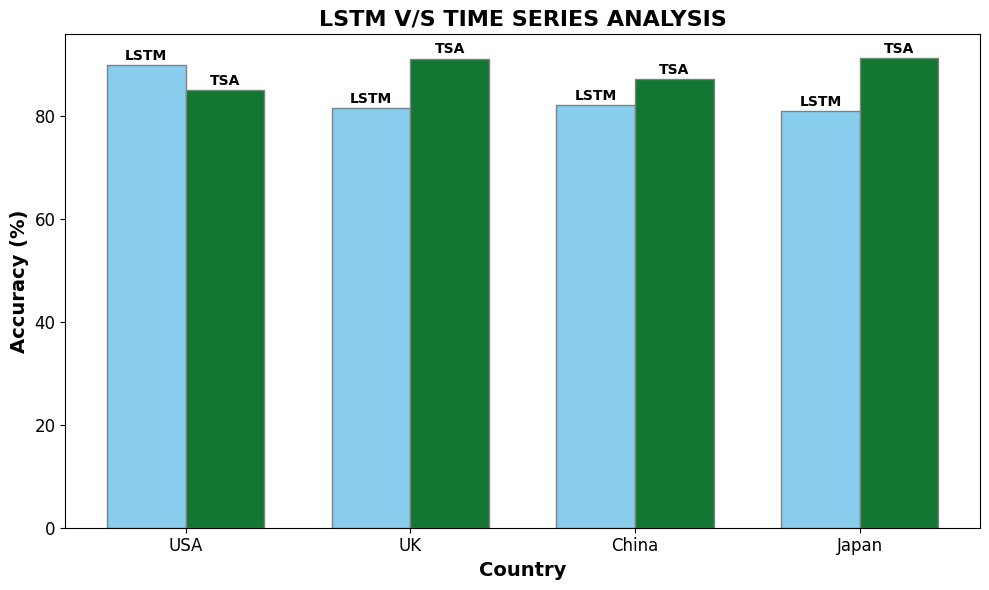

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Data
countries = ['USA', 'UK', 'China', 'Japan']
lstm_accuracies = [89.964, 81.682, 82.188, 80.971]  # Replace with actual LSTM accuracies
ts_accuracies = [85.05, 91.25, 87.18, 91.39]         # Replace with actual Time Series Analysis accuracies

# Set the width of the bars
bar_width = 0.35

# Set the positions of the bars on the x-axis
r1 = np.arange(len(countries))
r2 = [x + bar_width for x in r1]

# Create bar plot
plt.figure(figsize=(10, 6))
plt.bar(r1, lstm_accuracies, color='#88CCEE', width=bar_width, edgecolor='grey')
plt.bar(r2, ts_accuracies, color='#117733', width=bar_width, edgecolor='grey')

# Add xticks on the middle of the group bars
plt.xlabel('Country', fontweight='bold')
plt.ylabel('Accuracy (%)', fontweight='bold')
plt.xticks([r + bar_width/2 for r in range(len(countries))], countries)

# Add labels and title
plt.title('LSTM V/S TIME SERIES ANALYSIS', fontweight='bold')

# Add "LSTM" and "TSA" on top of bars
for i in range(len(countries)):
    plt.text(r1[i], lstm_accuracies[i] + 1, 'LSTM', color='black', ha='center', fontweight='bold')
    plt.text(r2[i], ts_accuracies[i] + 1, 'TSA', color='black', ha='center', fontweight='bold')

# Show plot
plt.tight_layout()
plt.show()



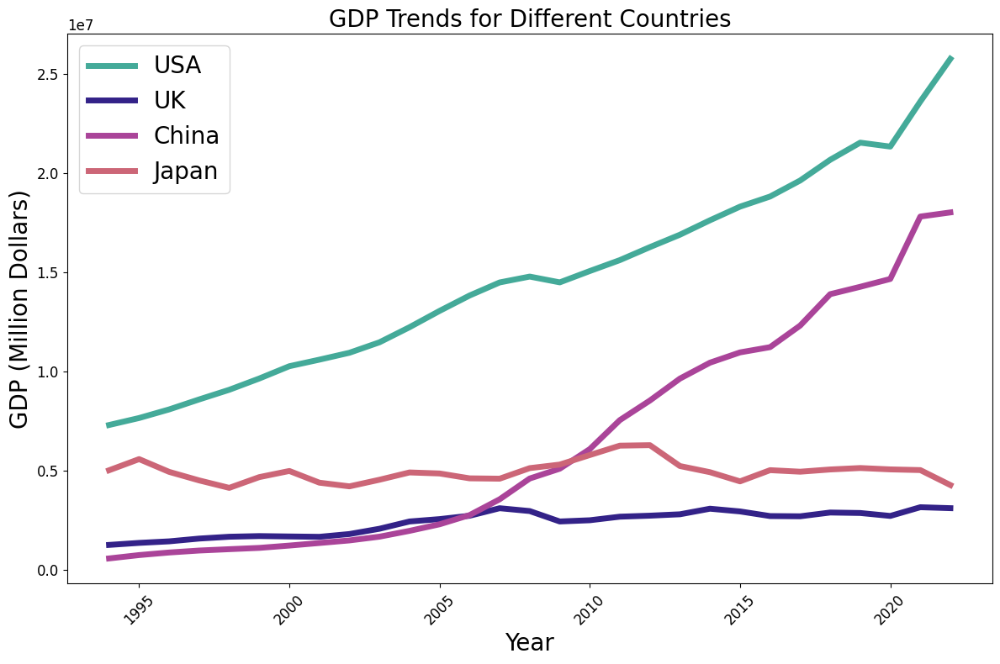

In [ ]:
import matplotlib.pyplot as plt

# Data
countries = ['USA', 'UK', 'China', 'Japan']
dataframes = [df_USA, df_UK, df_China, df_Japan]
colors = ['#44AA99', '#332288', '#AA4499', '#CC6677']  # Updated colors

# Create the plot
plt.figure(figsize=(12, 8))

# Plot GDP for each country
for country, df, color in zip(countries, dataframes, colors):
    plt.plot(df.index, df['GDP_' + country.upper()], color=color, label=country, linewidth=5)  # Increase linewidth for bold curves

# Add labels and title
plt.xlabel('Year', fontsize=20)  # Adjust fontsize here
plt.ylabel('GDP (Million Dollars)', fontsize=20)
plt.title('GDP Trends for Different Countries', fontsize=20)
plt.xticks(rotation=45)
plt.tight_layout()

# Add legend inside the plot
plt.legend(loc='upper left', fontsize=20)  # Increase legend fontsize

# Remove grid
plt.grid(False)

# Show the plot
plt.show()


In [ ]:
import pandas as pd

# Data
data = {
    'Country': ['China', 'Japan', 'UK', 'USA'],
    'LSTM RMSE': [3255896.2649991377, 745692.0277767156, 499066.88555892423, 1944026.6073306028],
    'LSTM Accuracy (%)': [80.63865879550461, 84.383, 83.256, 91.746],
    'ARIMA RMSE': [2242993.4231549664, 588398.2087718976, 242067.15043585186, 3538477.712988255],
    'ARIMA Accuracy (%)': [86.661, 87.677, 91.878, 84.977]
}

# Create DataFrame
df = pd.DataFrame(data)

# Display DataFrame
print(df)



  Country     LSTM RMSE  LSTM Accuracy (%)    ARIMA RMSE  ARIMA Accuracy (%)
0   China  3.255896e+06          80.638659  2.242993e+06              86.661
1   Japan  7.456920e+05          84.383000  5.883982e+05              87.677
2      UK  4.990669e+05          83.256000  2.420672e+05              91.878
3     USA  1.944027e+06          91.746000  3.538478e+06              84.977
